# Series de tiempo de Egresos para el proyecto Contaminación

# 2010

In [2]:
# Se importan las librerias necesarias
import pandas as pd 

# Se cargan los datos
colums = ['EGRESO', 'DIAG_INI']
dataframe = pd.read_csv('EGRESO_2010.csv', usecols=colums).dropna()
dataframe

,EGRESO,DIAG_INI
0,19/01/2010,O829
1,16/02/2010,J189
2,23/03/2010,N814
3,17/04/2010,O759
4,22/05/2010,K359
...,...,...
2634334,21/07/2010,O064
2634335,21/05/2010,S822
2634336,23/03/2010,K802
2634337,17/08/2010,O809


In [12]:
# Se importan las librerias necesarias
from epiweeks import Week, date

# Se convierten los string a objetos datetime en 'dataframe'
strfdtoriginal = '%d/%m/%Y'
dataframe['EGRESO'] = pd.to_datetime(dataframe['EGRESO'], format=strfdtoriginal)

# Se agrega una columna con los numeros de semana
dataframe['sem'] = ''
nrows = len(dataframe.index)
for i in range(nrows):
    dfday = dataframe['EGRESO'][i]
    mydate = date(dfday.year, dfday.month, dfday.day)
    numberweek = Week.fromdate(mydate)
    dataframe['sem'][i] = numberweek.week
    
dataframe

,EGRESO,DIAG_INI,sem
0,2010-01-19,O829,3
1,2010-02-16,J189,7
2,2010-03-23,N814,12
3,2010-04-17,O759,15
4,2010-05-22,K359,20
...,...,...,...
2634334,2010-07-21,O064,29
2634335,2010-05-21,S822,20
2634336,2010-03-23,K802,12
2634337,2010-08-17,O809,33


In [21]:
# Se forma el nuevo dataframe 'semanas' con el numero de semana del año y la cantidad de egresos en cada semana
semanas = dataframe['sem'].value_counts()
semanas = semanas.sort_index()
semanas

1     43463
2     48020
3     49300
4     50404
5     46716
6     50279
7     49462
8     50102
9     51123
10    52219
11    48527
12    51158
13    46652
14    48200
15    49187
16    49499
17    51348
18    48072
19    50004
20    50627
21    51101
22    51157
23    51436
24    49970
25    49757
26    49682
27    50141
28    50981
29    50164
30    50925
31    51991
32    52355
33    52240
34    53192
35    54220
36    55165
37    48947
38    54466
39    54926
40    54540
41    54019
42    54255
43    52924
44    47914
45    52907
46    50233
47    52802
48    51769
49    51864
50    51110
51    52494
52    40330
Name: sem, dtype: int64

In [22]:
# Se pasa a un nuevo dataframe
newdf = pd.DataFrame()
newdf['sem'] = semanas.index 
newdf['casos'] = ''
nr = len(newdf.index)
for i in range (nr):
    newdf['casos'][i] = int(semanas[i+1])
newdf

,sem,casos
0,1,43463
1,2,48020
2,3,49300
3,4,50404
4,5,46716
5,6,50279
6,7,49462
7,8,50102
8,9,51123
9,10,52219


Egresos 2010


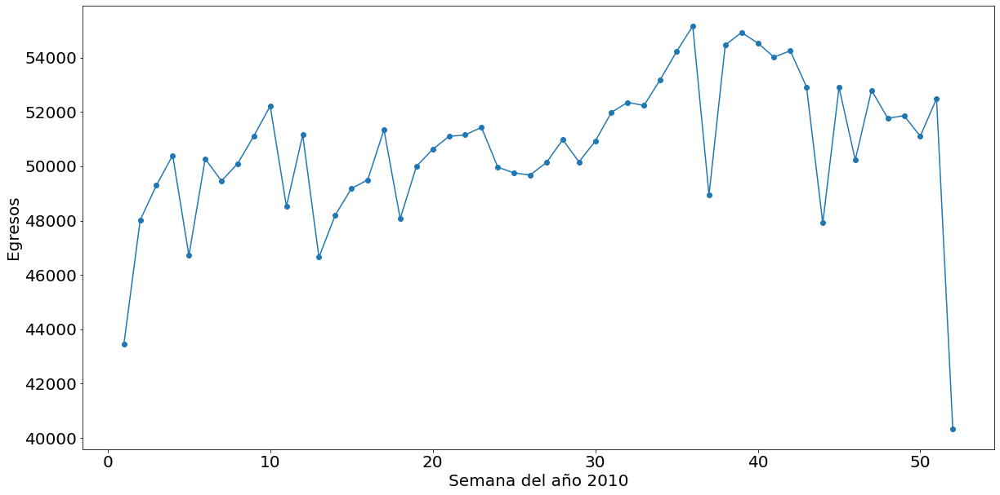

In [127]:
# Se importan las librerias necesarias
import matplotlib.pyplot as plt

año = '2010'
print('Egresos ' + año)
# Se establece el tamaño de la figura
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(20, 10))
# Se define que se unan los puntos en la gráfica
plt.scatter(semanas.index, newdf.casos)
# Se definen las coordenadas 'x' y 'y'
plt.plot(semanas.index, newdf.casos)
# Se coloca un título para el eje x
plt.xlabel("Semana del año " + año)
# Se coloca un título para el eje y
plt.ylabel("Egresos")
# Se guarda la figura como un archivo
plt.savefig(año + '/Egresos' + año + '.jpg', format='jpg')
# Se muestra la figura en la terminal
plt.show()

Año 2010


O809


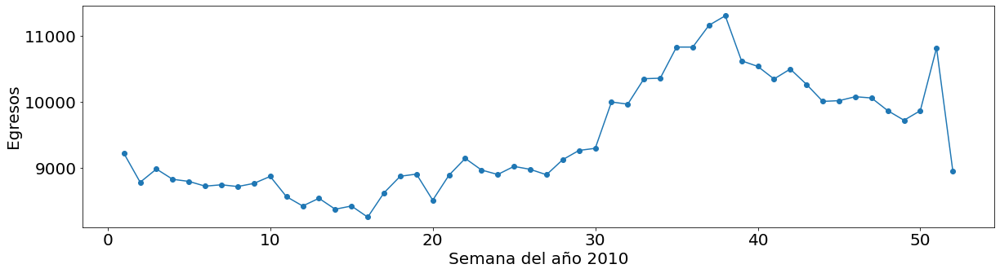


O829


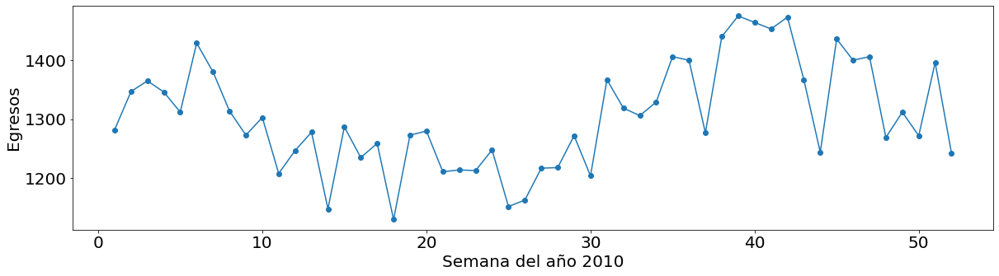


O800


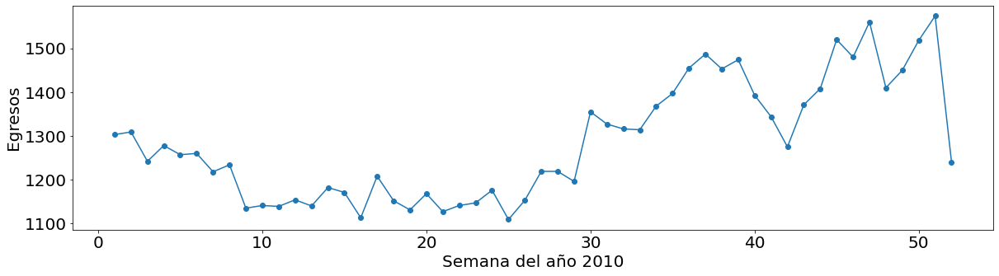


O064


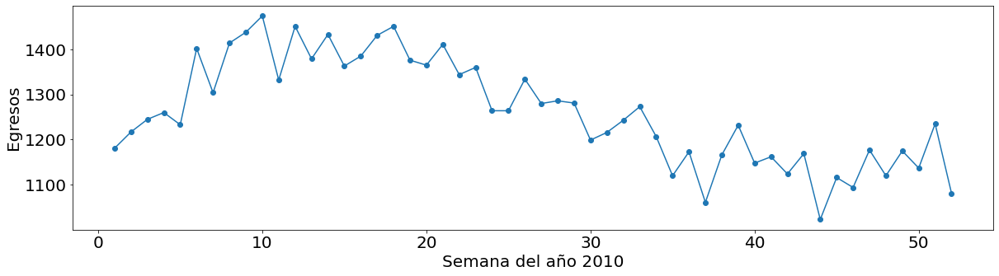


N189


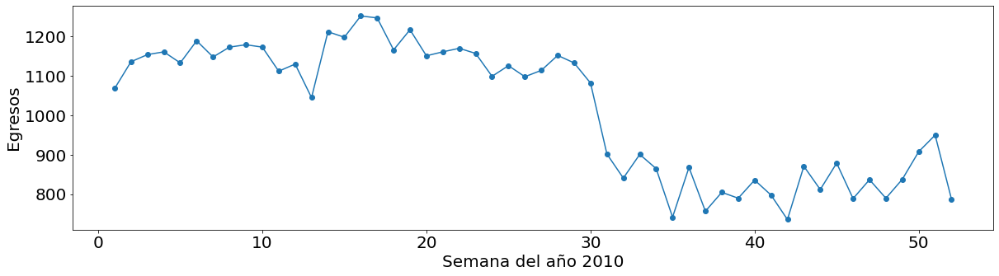


O342


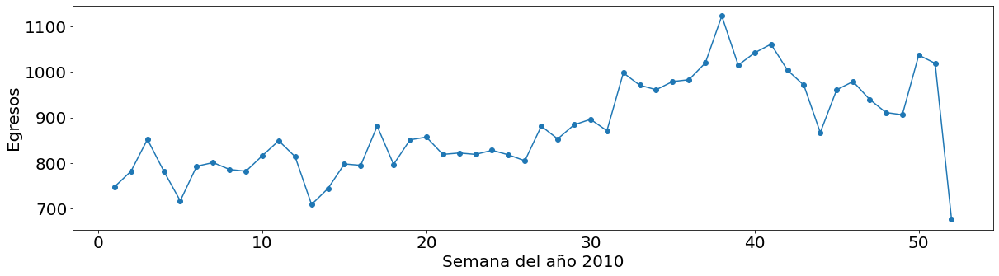


K359


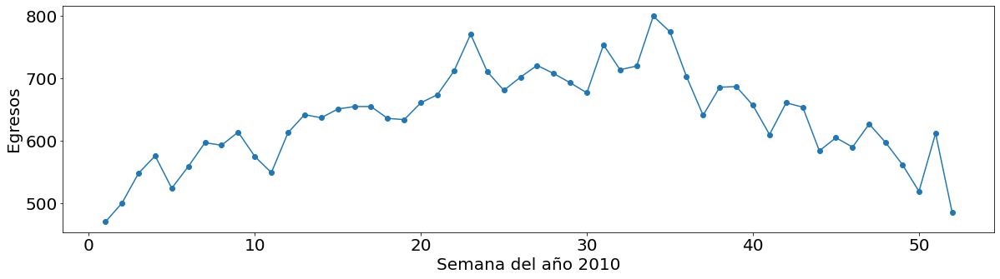


O429


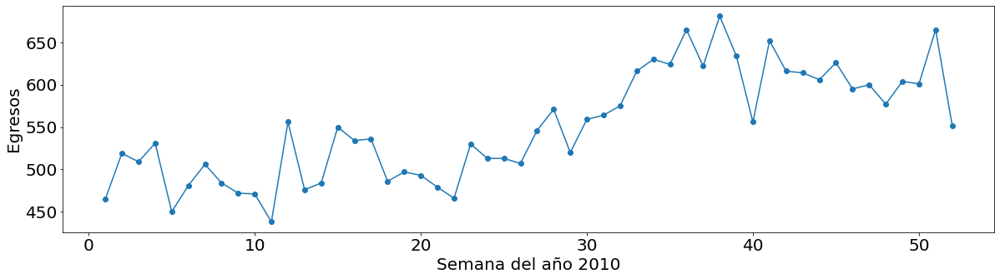


O339


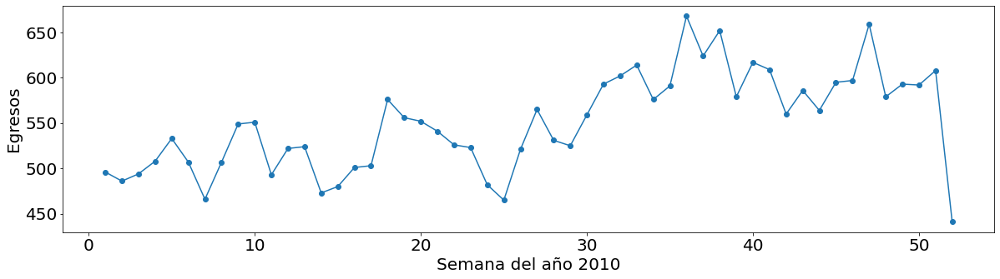


O470


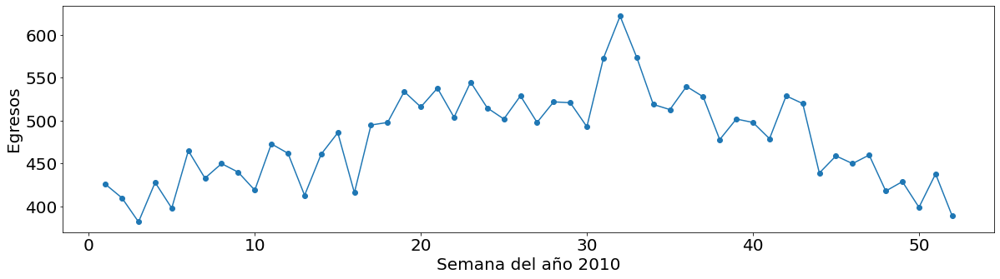


K409


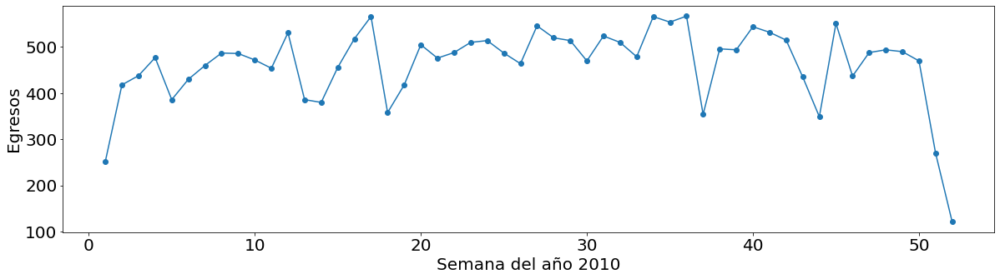


N180


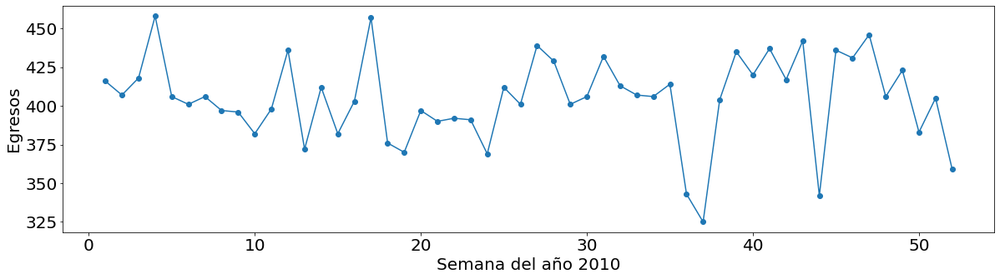


J189


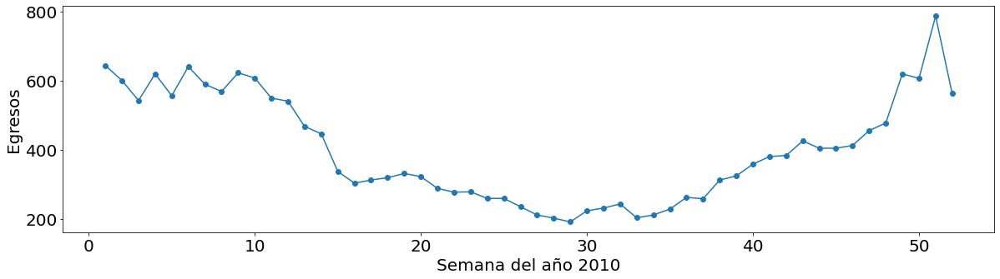


K801


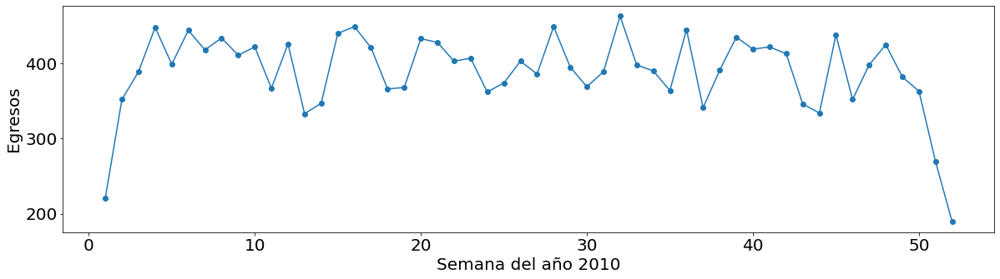


O410


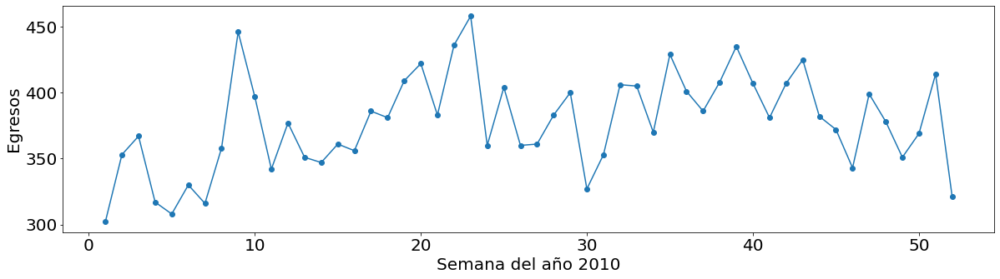


A09X


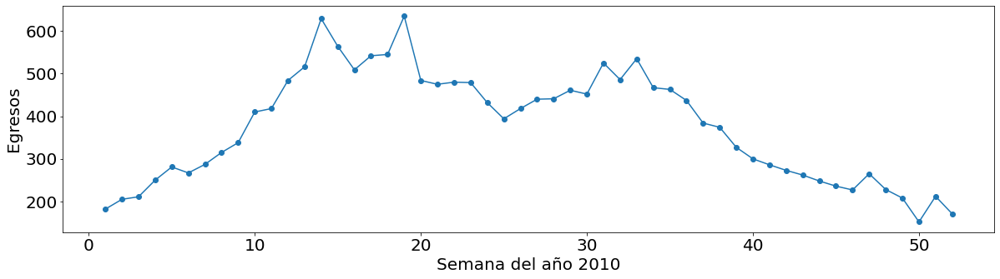


D259


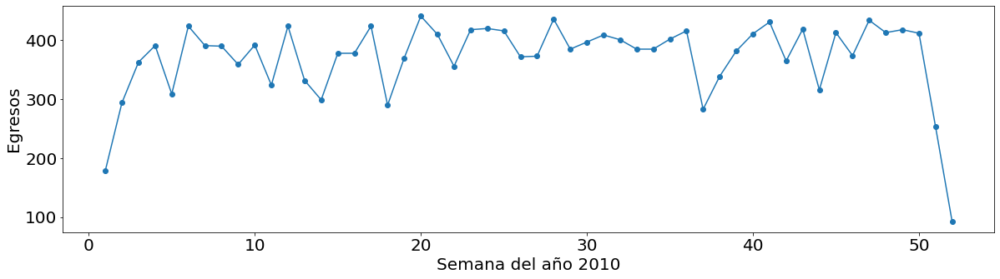


P073


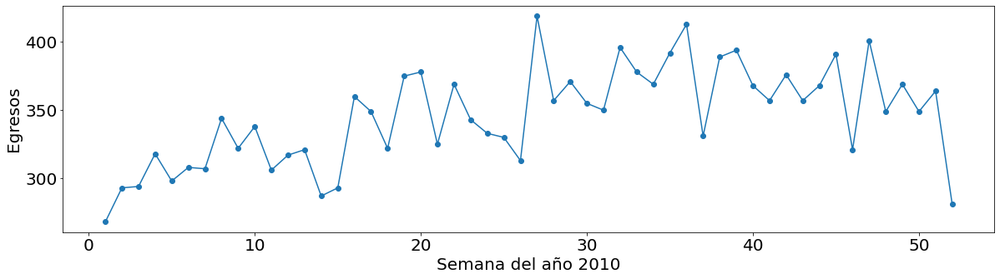


O13X


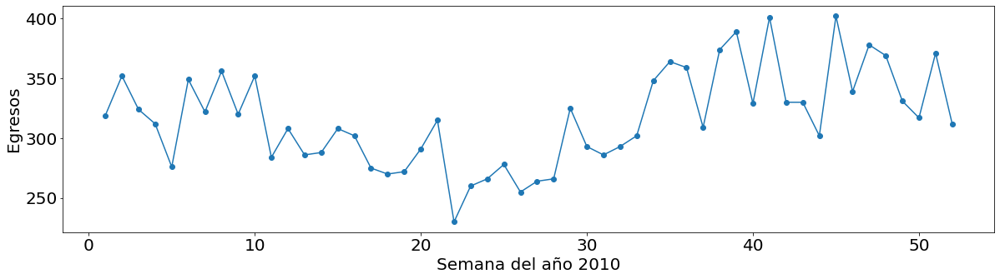


E119


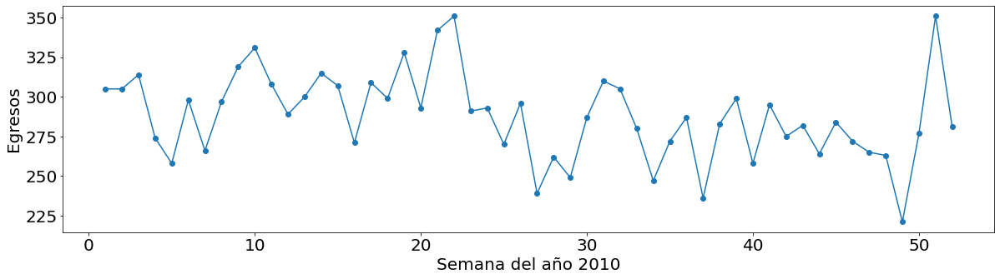


O200


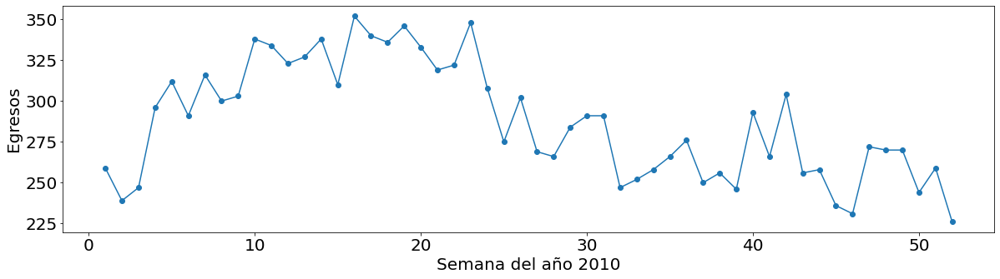


K811


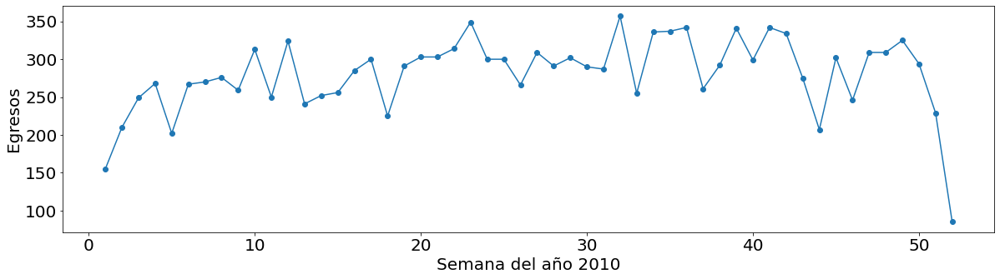


K37X


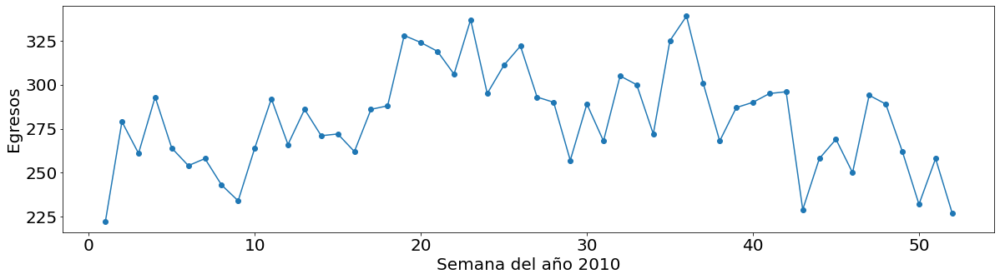


O021


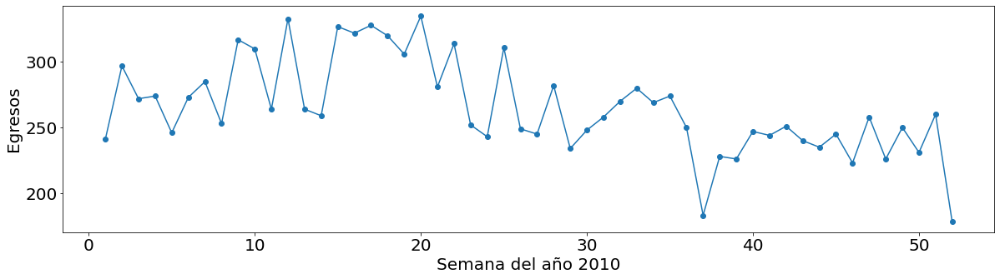


Z302


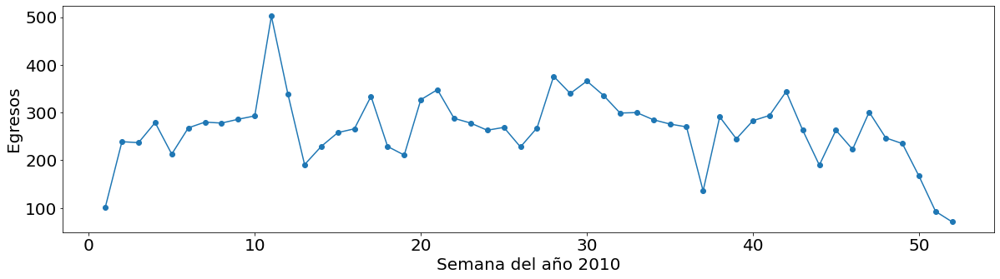


Q779


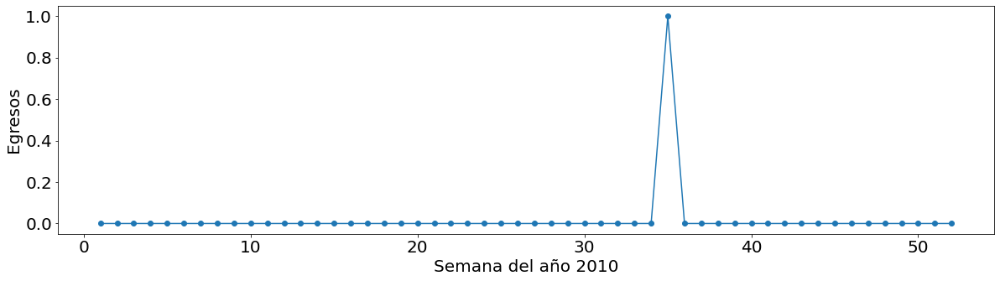


Q160


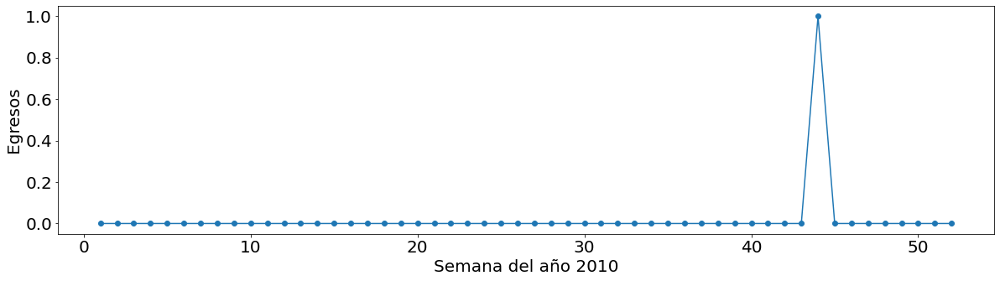


S448


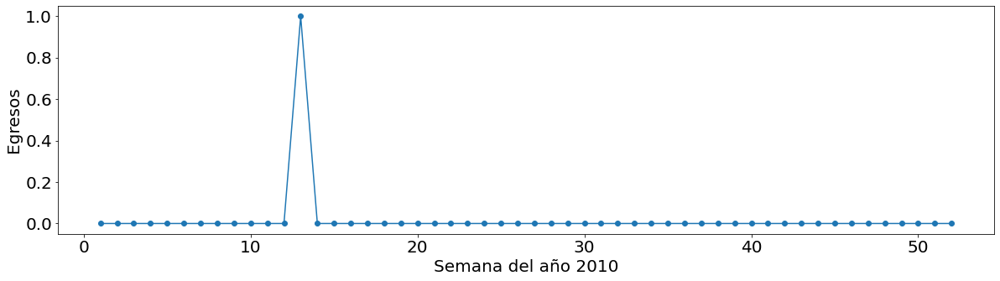


G051


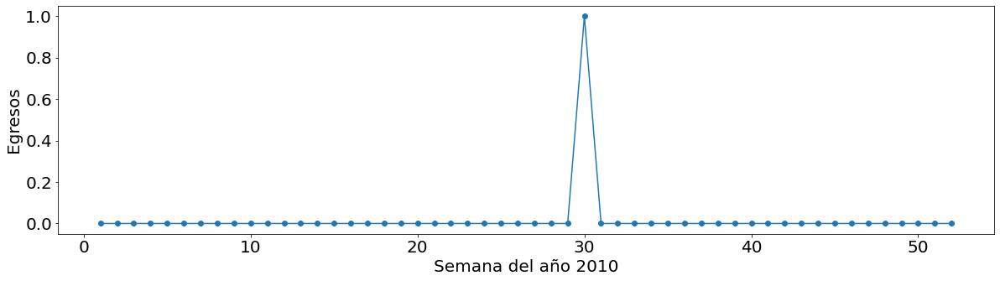


A660


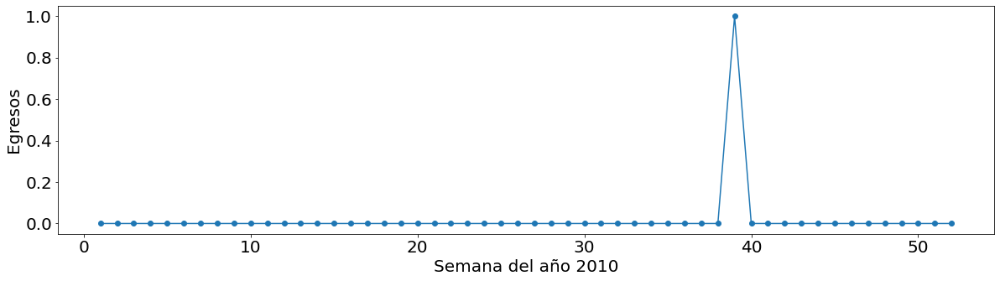

In [128]:
# Se crea el dataframe 'diagnosticos' con los nombre de los diferentes diagnosticos sin repeticion
diagnosticos = dataframe['DIAG_INI'].value_counts()
# Se ordena del diagnostico con mayore numero de egresos al diagnostico con menor numero de egresos
diagnosticos = diagnosticos.sort_values(ascending = False)
# Se crea el dataframe 'cie' con los nombres de los diagnosticos, los numeros de las semanas, y la cantidad de diagnosticos de dicha enfermedad en cada semana
cie = dataframe.groupby(['DIAG_INI', 'sem']).count()

# Se importa la libreria necesaria para la figura
import matplotlib.pyplot as plt

plt.rcParams.update({'font.size': 20})

print('Año ' + año + '\n')
# Se inicia un contador para controlar la cantidad de graficos a generar
i = 0
ndiagnosticos = len(diagnosticos.index)
maximo = ndiagnosticos-5
# Proceso de generación de las figuras
for name in diagnosticos.index:
    if i < 25 or i >= maximo:
        y = []
        for index in semanas.index:
            try:
                y.append(cie['EGRESO'][name, index])
            except:
                y.append(0)
        print('\n' + name)
        plt.figure(figsize=(20, 5))
        plt.scatter(semanas.index, y)
        plt.plot(semanas.index, y)
        plt.xlabel("Semana del año " + año)
        plt.ylabel("Egresos")
        plt.savefig(año + '/' + name + '_' + año + '.jpg', format='jpg')
        plt.show()
    i = i+1

# 2011

In [4]:
import pandas as pd 

# Se cargan los datos
colums1 = ['EGRESO', 'DIAG_INI']
dataframe1 = pd.read_csv('EGRESO_2011.csv', usecols=colums1).dropna()
dataframe1

,EGRESO,DIAG_INI
0,22/03/2011,T311
1,22/03/2011,K579
2,22/03/2011,L039
3,04/04/2011,K359
4,05/04/2011,J189
...,...,...
1048567,21/09/2011,I091
1048568,21/09/2011,I350
1048569,22/09/2011,I471
1048570,22/09/2011,I739


In [13]:
# Se importan las librerias necesarias
from epiweeks import Week, date

# Se convierten los string a objetos datetime en 'dataframe'
strfdtoriginal1 = '%d/%m/%Y'
dataframe1['EGRESO'] = pd.to_datetime(dataframe1['EGRESO'], errors='coerce', format=strfdtoriginal1)
dataframe1 = dataframe1.dropna()
dataframe1 = dataframe1.reset_index(drop=True)

# Se agrega una columna con los numeros de semana
dataframe1['sem'] = ''
nrows1 = len(dataframe1.index)
for i in range(nrows1):
    dfday1 = dataframe1['EGRESO'][i]
    if dfday1.year == 2011:    
        mydate1 = date(dfday1.year, dfday1.month, dfday1.day)
        numberweek1 = Week.fromdate(mydate1)
        dataframe1['sem'][i] = numberweek1.week
    
dataframe1 = dataframe1.dropna()
dataframe1 = dataframe1.reset_index(drop=True)    
dataframe1

,EGRESO,DIAG_INI,sem
0,2011-03-22,T311,12
1,2011-03-22,K579,12
2,2011-03-22,L039,12
3,2011-04-04,K359,14
4,2011-04-05,J189,14
...,...,...,...
1048549,2011-09-21,I091,38
1048550,2011-09-21,I350,38
1048551,2011-09-22,I471,38
1048552,2011-09-22,I739,38


In [48]:
# Se forma el nuevo dataframe 'semanas' con el numero de semana del año y la cantidad de egresos en cada semana
semanas1 = dataframe1['sem'].value_counts()
semanas1 = semanas1.drop('', axis = 0)
semanas1 = semanas1.sort_index()
semanas1

1     17352
2     18696
3     19496
4     19507
5     19332
6     18294
7     19327
8     19752
9     19824
10    19289
11    19828
12    18756
13    19630
14    19820
15    19684
16    17260
17    18346
18    17878
19    18577
20    19349
21    19384
22    19016
23    19569
24    19636
25    19737
26    19807
27    19845
28    20238
29    20570
30    20463
31    20628
32    21214
33    21237
34    21296
35    21472
36    21765
37    20779
38    21674
39    23011
40    22644
41    22416
42    22546
43    22094
44    20010
45    22360
46    21769
47    21130
48    21236
49    20987
50    20903
51    19862
52     3091
Name: sem, dtype: int64

In [49]:
# Se pasa a un nuevo dataframe
newdf1 = pd.DataFrame()
newdf1['sem'] = semanas1.index 
newdf1['casos'] = ''
nr1 = len(newdf1.index)
for i in range (nr1):
    newdf1['casos'][i] = int(semanas1[i+1])
newdf1

,sem,casos
0,1,17352
1,2,18696
2,3,19496
3,4,19507
4,5,19332
5,6,18294
6,7,19327
7,8,19752
8,9,19824
9,10,19289


Egresos 2011


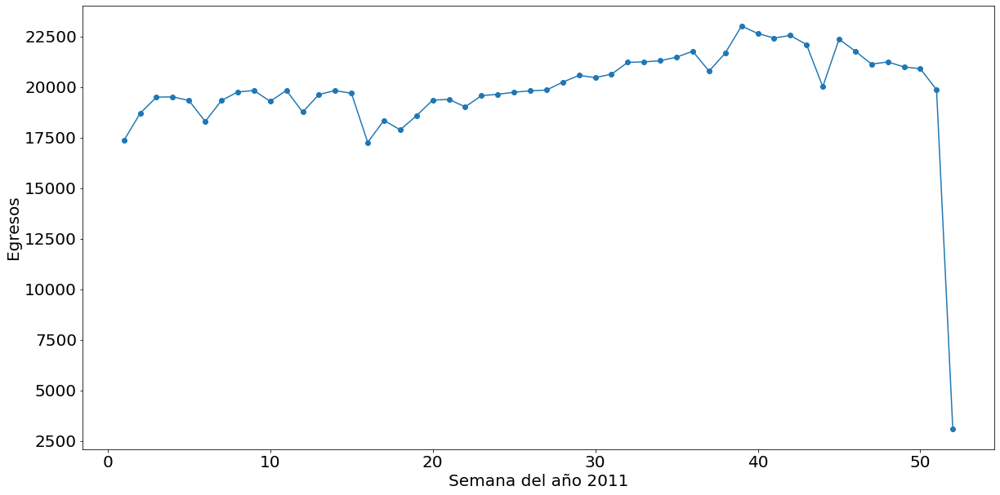

In [129]:
# Se importan las librerias necesarias
import matplotlib.pyplot as plt

año1 = '2011'
print('Egresos ' + año1)
# Se establece el tamaño de la figura
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(20, 10))
# Se define que se unan los puntos en la gráfica
plt.scatter(semanas1.index, newdf1.casos)
# Se definen las coordenadas 'x' y 'y'
plt.plot(semanas1.index, newdf1.casos)
# Se coloca un título para el eje x
plt.xlabel("Semana del año " + año1)
# Se coloca un título para el eje y
plt.ylabel("Egresos")
# Se guarda la figura como un archivo
plt.savefig(año1 + '/Egresos' + año1 + '.jpg', format='jpg')
# Se muestra la figura en la terminal
plt.show()

Año 2011


O809


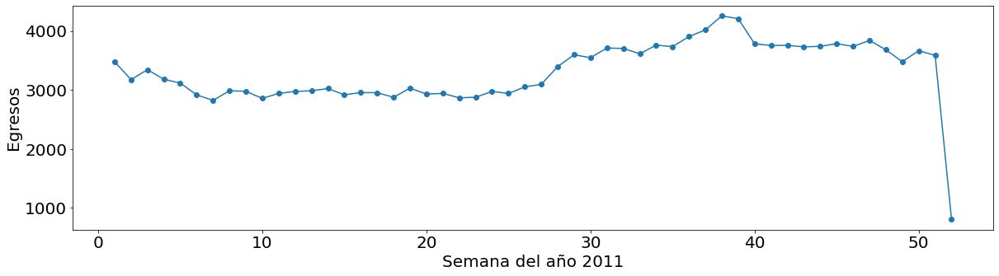


O800


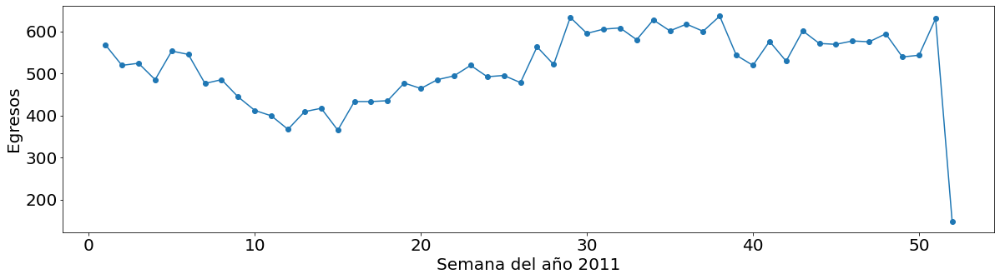


O064


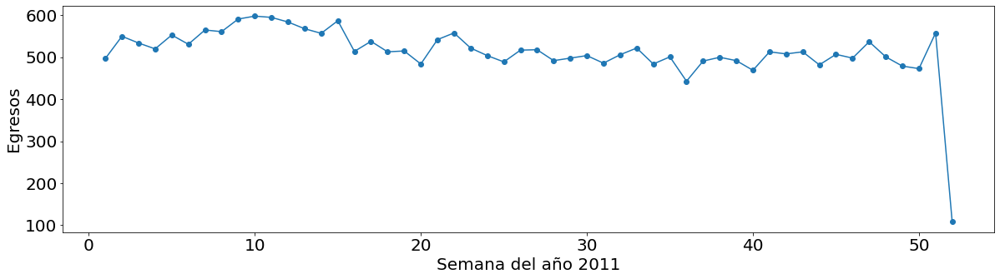


O342


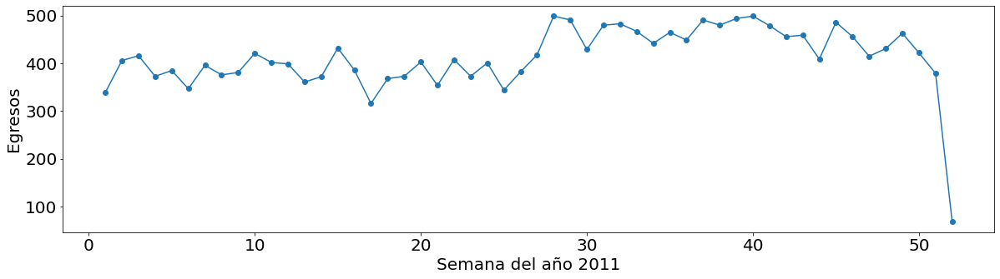


O829


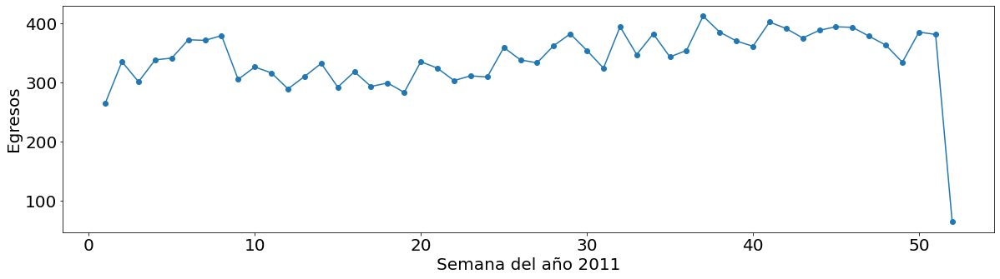


N189


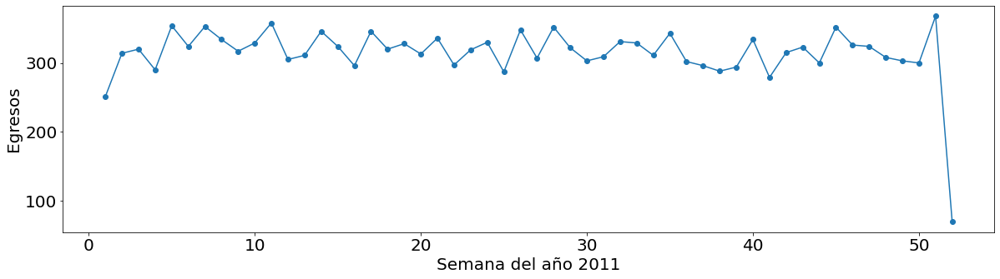


N180


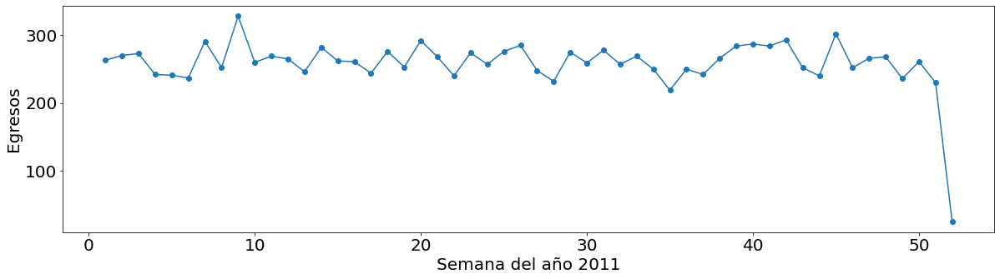


K359


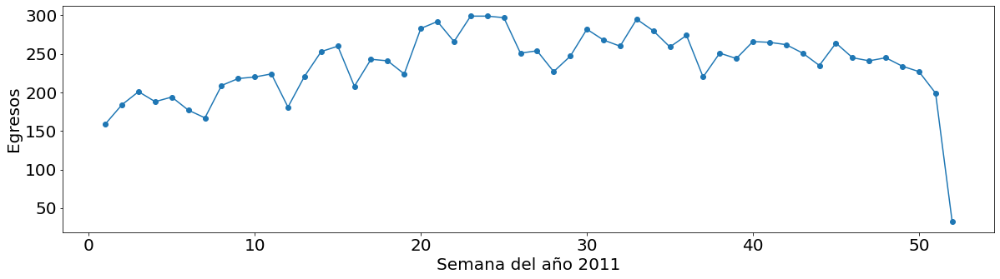


O339


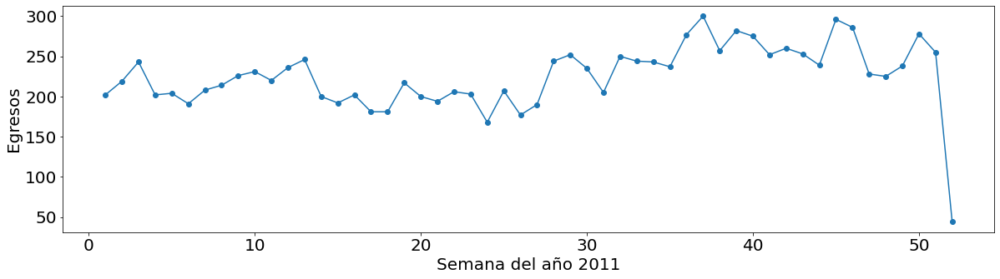


O470


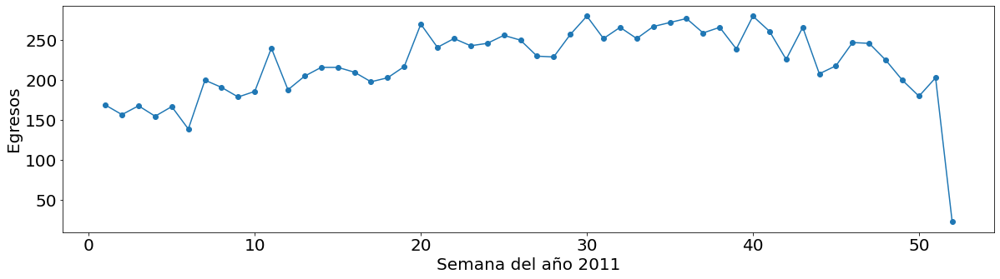


K801


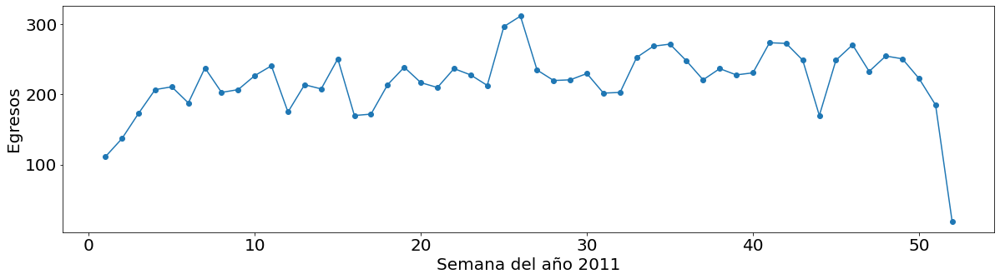


O429


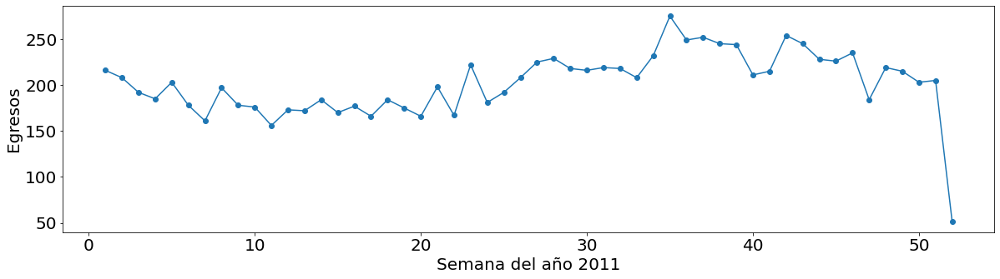


K409


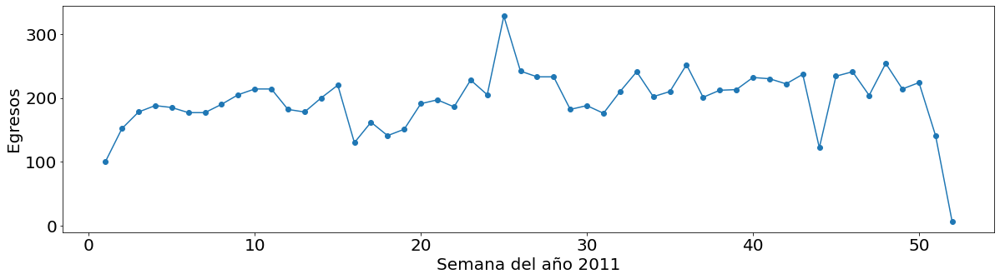


J189


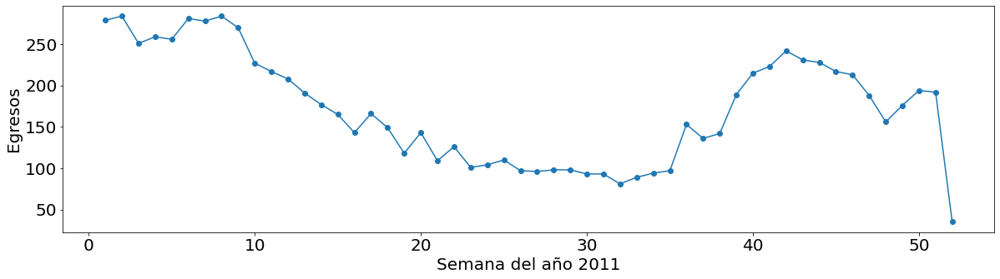


O13X


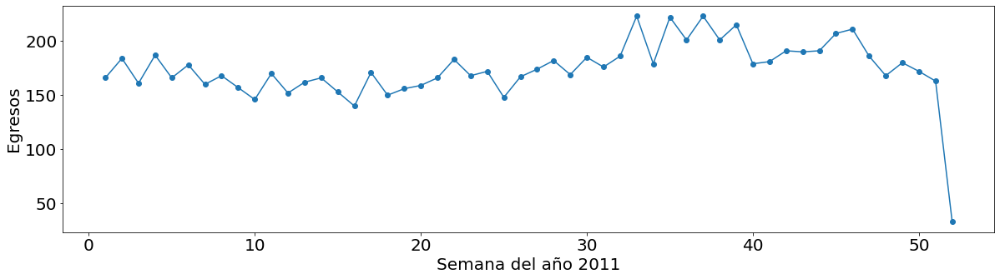


O410


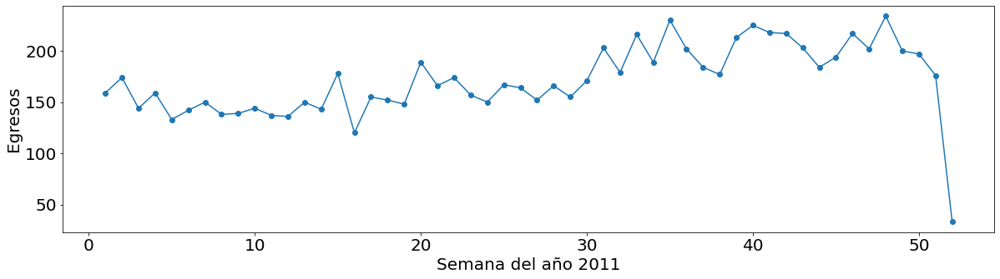


D259


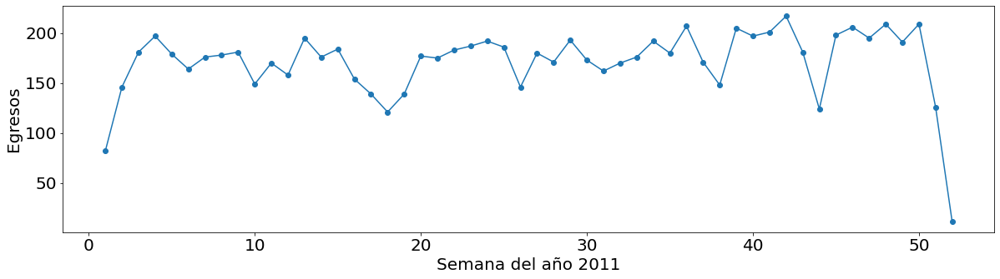


E119


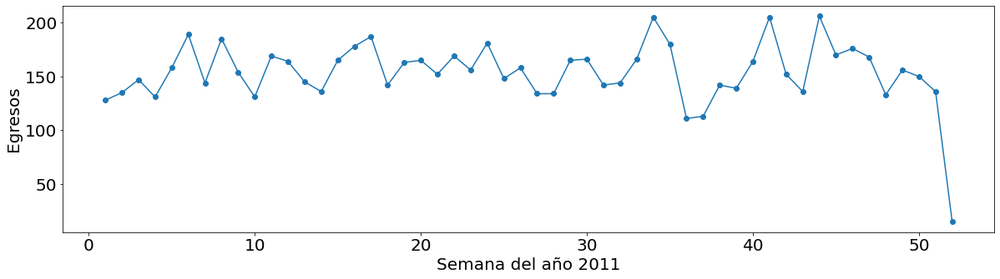


A09X


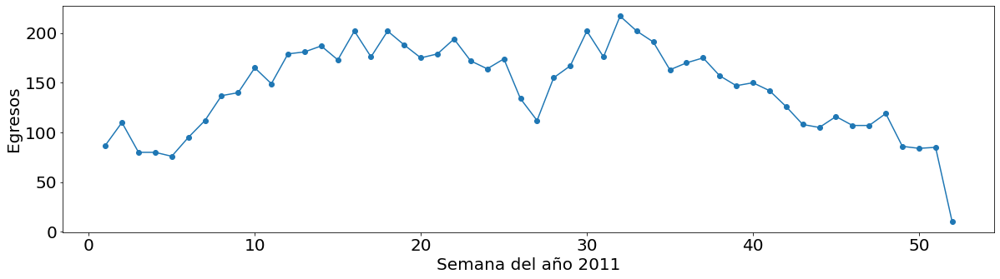


O335


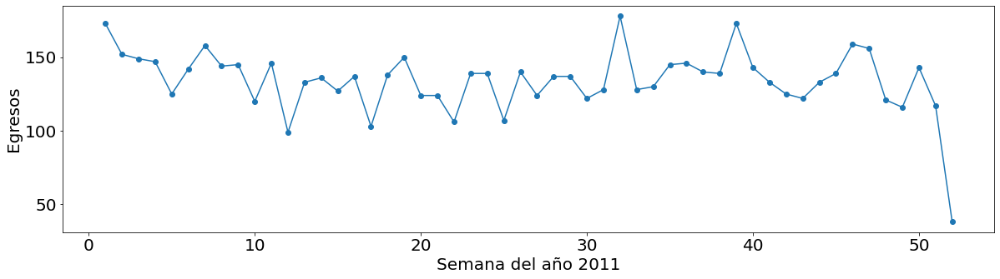


Z302


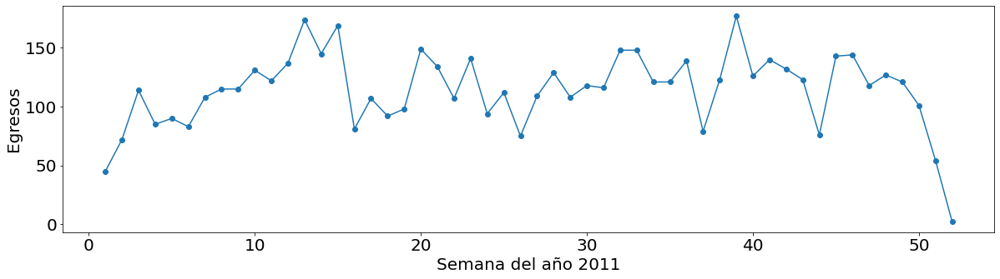


P073


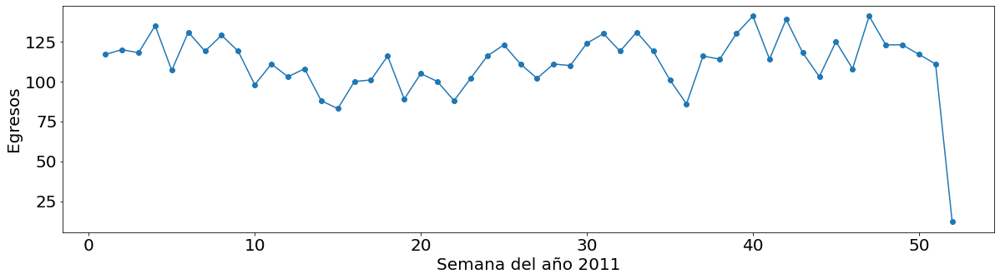


O200


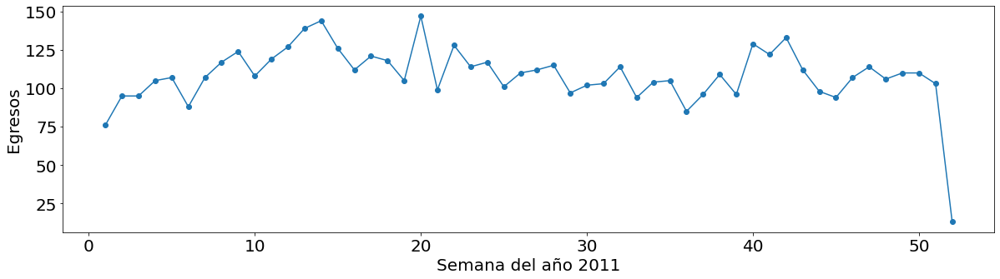


O021


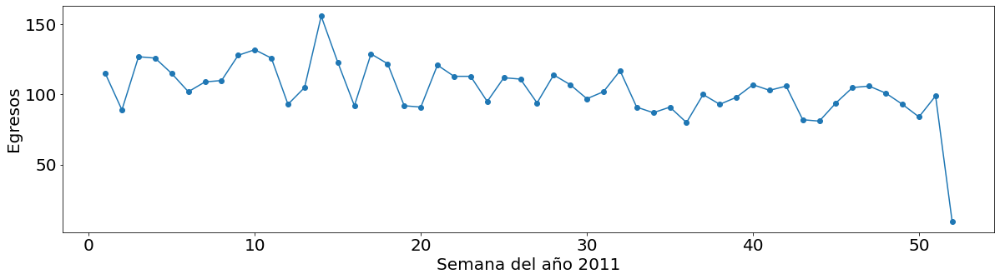


K811


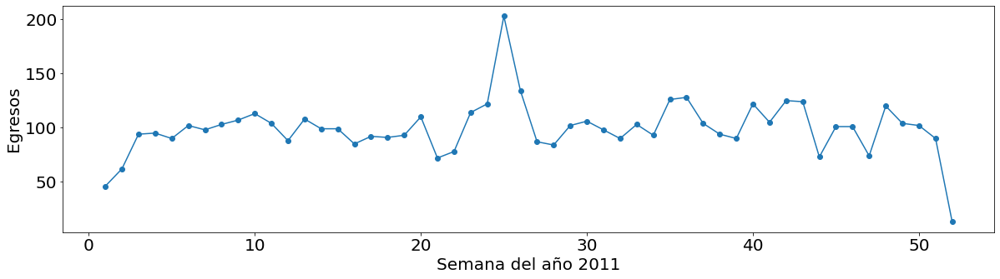


K143


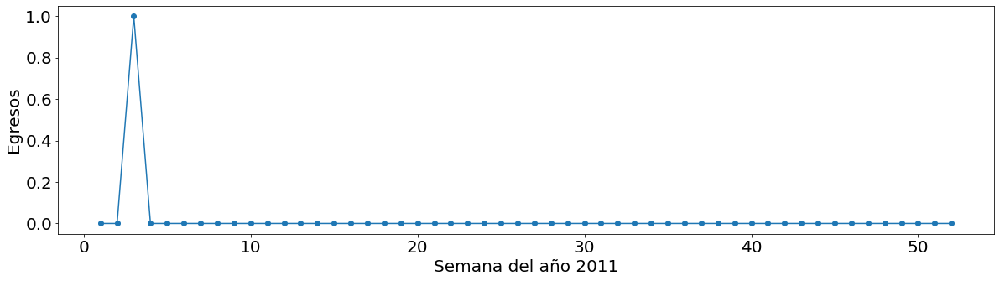


T406


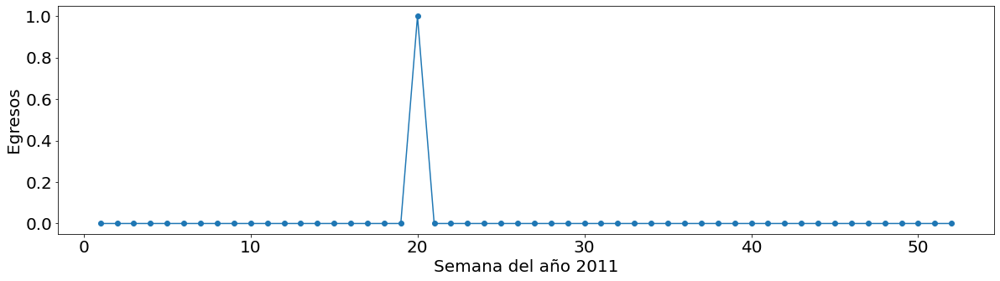


A240


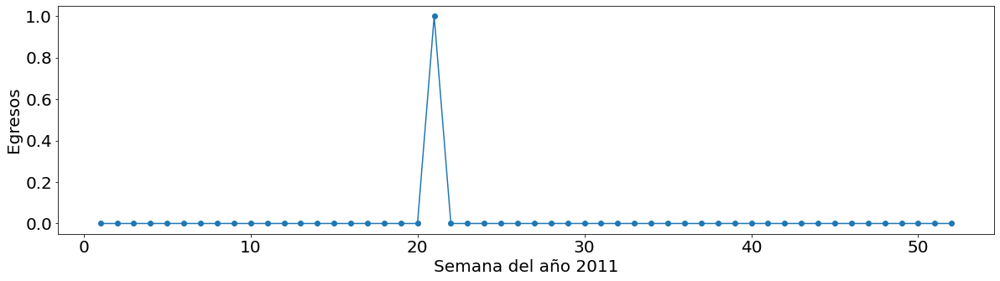


O872


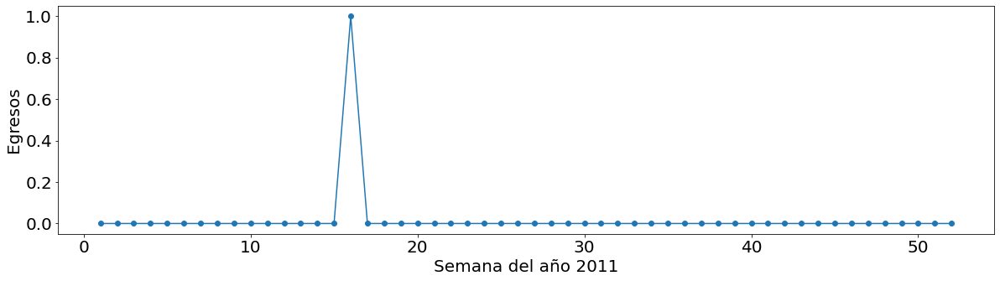


Z350


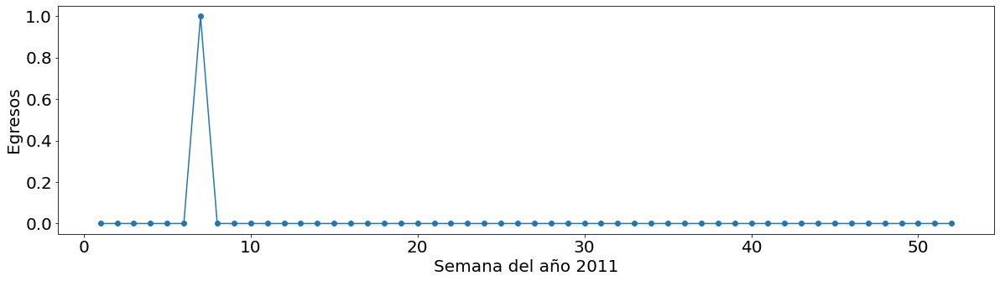

In [130]:
# Se crea el dataframe 'diagnosticos' con los nombre de los diferentes diagnosticos sin repeticion
diagnosticos1 = dataframe1['DIAG_INI'].value_counts()
# Se ordena del diagnostico con mayore numero de egresos al diagnostico con menor numero de egresos
diagnosticos1 = diagnosticos1.sort_values(ascending = False)
# Se crea el dataframe 'cie' con los nombres de los diagnosticos, los numeros de las semanas, y la cantidad de diagnosticos de dicha enfermedad en cada semana
cie1 = dataframe1.groupby(['DIAG_INI', 'sem']).count()

# Se importa la libreria necesaria para la figura
import matplotlib.pyplot as plt

plt.rcParams.update({'font.size': 20})

print('Año ' + año1 + '\n')
# Se inicia un contador para controlar la cantidad de graficos a generar
i1 = 0
ndiagnosticos1 = len(diagnosticos1.index)
maximo1 = ndiagnosticos1-5
# Proceso de generación de las figuras
for name1 in diagnosticos1.index:
    if i1 < 25 or i1 >= maximo1:
        y1 = []
        for index1 in semanas1.index:
            try:
                y1.append(cie1['EGRESO'][name1, index1])
            except:
                y1.append(0)
        print('\n' + name1)
        plt.figure(figsize=(20, 5))
        plt.scatter(semanas1.index, y1)
        plt.plot(semanas1.index, y1)
        plt.xlabel("Semana del año " + año1)
        plt.ylabel("Egresos")
        plt.savefig(año1 + '/' + name1 + '_' + año1 + '.jpg', format='jpg')
        plt.show()
    i1 = i1+1

# 2012

In [5]:
import pandas as pd 

# Se cargan los datos
colums2 = ['EGRESO', 'DIAG_INI']
dataframe2 = pd.read_csv('EGRESO_2012.csv', usecols=colums2).dropna()
dataframe2

,EGRESO,DIAG_INI
0,31/01/2012,N879
1,31/01/2012,O829
2,30/01/2012,O809
3,29/01/2012,O600
4,27/01/2012,O809
...,...,...
1048570,20/08/2012,C509
1048571,20/08/2012,C509
1048572,20/08/2012,C509
1048573,20/08/2012,C504


In [14]:
# Se importan las librerias necesarias
from epiweeks import Week, date

# Se convierten los string a objetos datetime en 'dataframe'
strfdtoriginal2 = '%d/%m/%Y'
dataframe2['EGRESO'] = pd.to_datetime(dataframe2['EGRESO'], errors='coerce', format=strfdtoriginal2)
dataframe2 = dataframe2.dropna()
dataframe2 = dataframe2.reset_index(drop=True)

# Se agrega una columna con los numeros de semana
dataframe2['sem'] = ''
nrows2 = len(dataframe2.index)
for i in range(nrows2):
    dfday2 = dataframe2['EGRESO'][i]
    if dfday2.year == 2012:
        mydate2 = date(dfday2.year, dfday2.month, dfday2.day)
        numberweek2 = Week.fromdate(mydate2)
        dataframe2['sem'][i] = numberweek2.week

dataframe2 = dataframe2.dropna()
dataframe2 = dataframe2.reset_index(drop=True)    
dataframe2

,EGRESO,DIAG_INI,sem
0,2012-01-31,N879,5
1,2012-01-31,O829,5
2,2012-01-30,O809,5
3,2012-01-29,O600,5
4,2012-01-27,O809,4
...,...,...,...
1048539,2012-08-20,C509,34
1048540,2012-08-20,C509,34
1048541,2012-08-20,C509,34
1048542,2012-08-20,C504,34


In [52]:
# Se forma el nuevo dataframe 'semanas' con el numero de semana del año y la cantidad de egresos en cada semana
semanas2 = dataframe2['sem'].value_counts()
semanas2 = semanas2.drop('', axis = 0)
semanas2 = semanas2.sort_index()
semanas2

1     18779
2     21239
3     21814
4     21843
5     21599
6     20500
7     21971
8     21587
9     22496
10    22702
11    22764
12    21001
13    22828
14    20586
15    21345
16    22002
17    22369
18    21219
19    22078
20    22397
21    22780
22    22819
23    22913
24    22732
25    22251
26    19190
27    18462
28    18710
29    18718
30    18512
31    18944
32    18725
33    18393
34    18694
35    19395
36    19720
37    19381
38    18956
39    19045
40    18645
41    18980
42    18468
43    18446
44    17378
45    17753
46    18327
47    16771
48    18050
49    17672
50    17094
51    16777
52     5539
Name: sem, dtype: int64

In [53]:
# Se pasa a un nuevo dataframe
newdf2 = pd.DataFrame()
newdf2['sem'] = semanas2.index 
newdf2['casos'] = ''
nr2 = len(newdf2.index)
for i in range (nr2):
    newdf2['casos'][i] = int(semanas2[i+1])
newdf2

,sem,casos
0,1,18779
1,2,21239
2,3,21814
3,4,21843
4,5,21599
5,6,20500
6,7,21971
7,8,21587
8,9,22496
9,10,22702


Egresos 2012


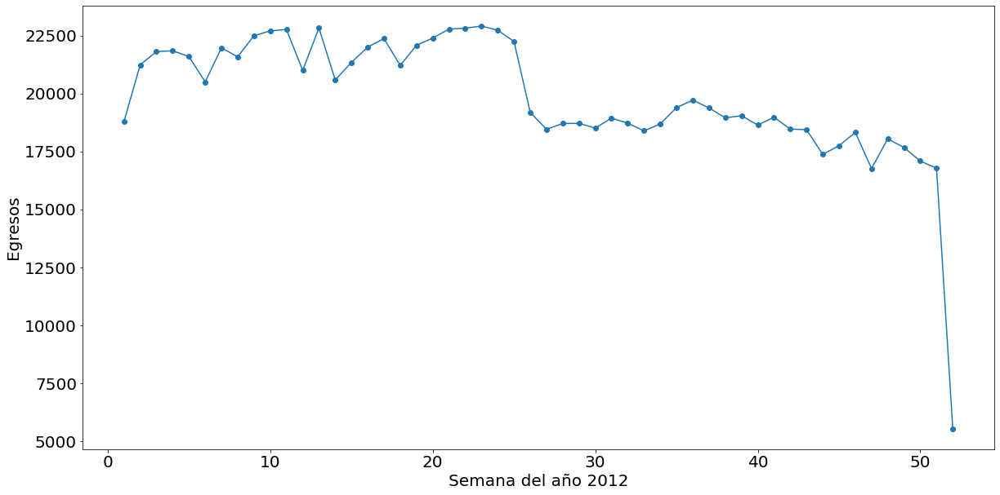

In [131]:
# Se importan las librerias necesarias
import matplotlib.pyplot as plt

año2 = '2012'
print('Egresos ' + año2)
# Se establece el tamaño de la figura
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(20, 10))
# Se define que se unan los puntos en la gráfica
plt.scatter(semanas2.index, newdf2.casos)
# Se definen las coordenadas 'x' y 'y'
plt.plot(semanas2.index, newdf2.casos)
# Se coloca un título para el eje x
plt.xlabel("Semana del año " + año2)
# Se coloca un título para el eje y
plt.ylabel("Egresos")
# Se guarda la figura como un archivo
plt.savefig(año2 + '/Egresos' + año2 + '.jpg', format='jpg')
# Se muestra la figura en la terminal
plt.show()

Año 2012


O809


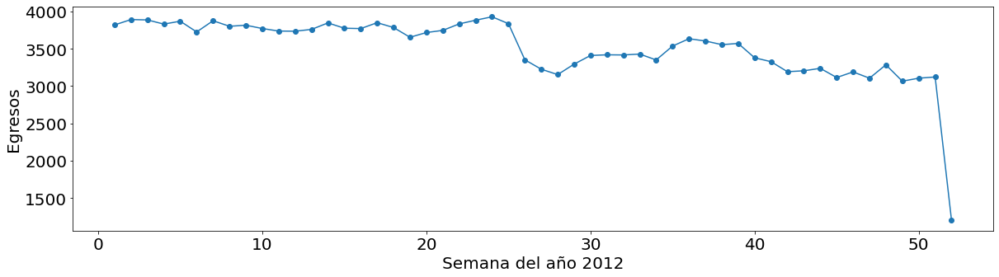


O800


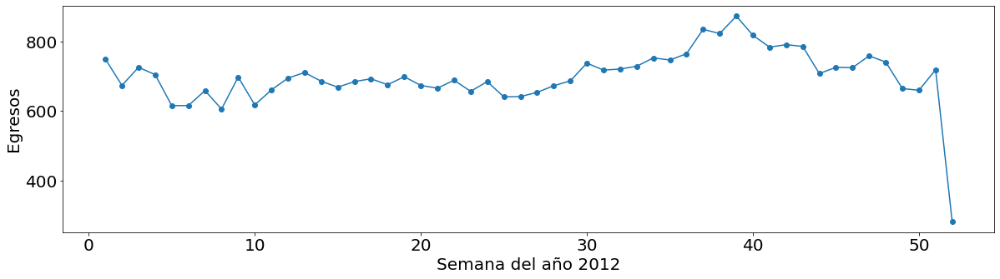


O829


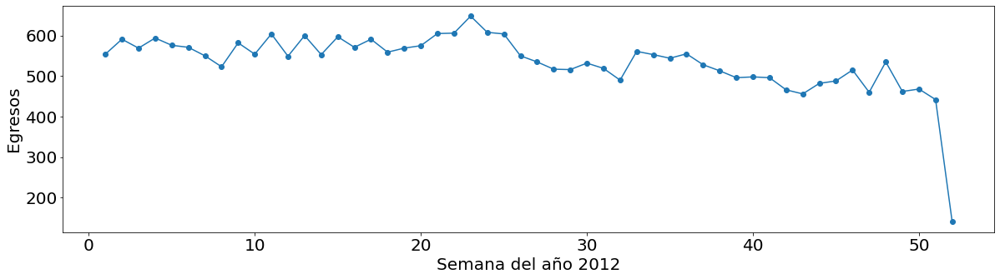


O064


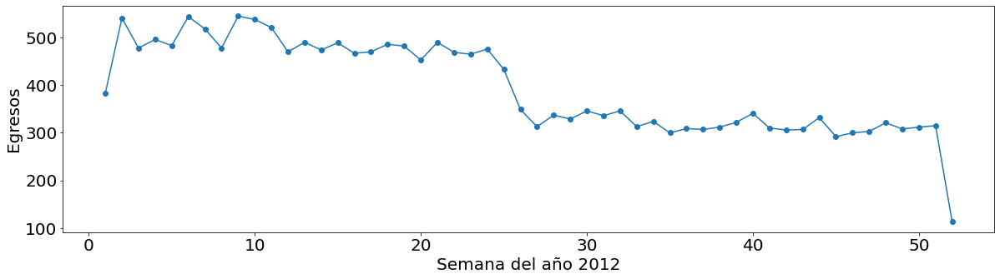


N189


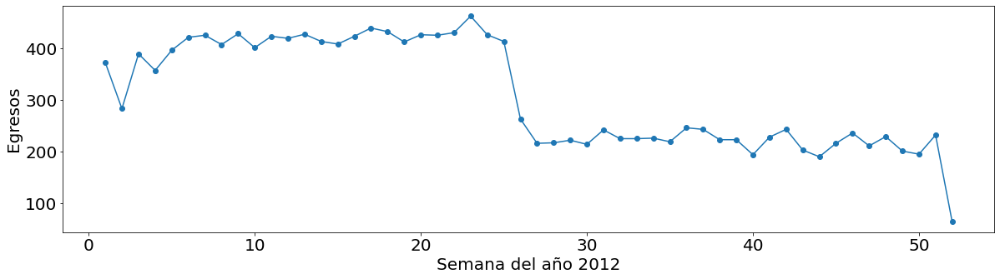


O342


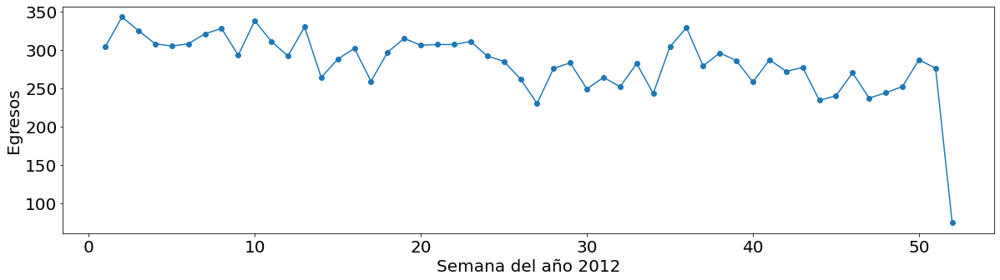


K359


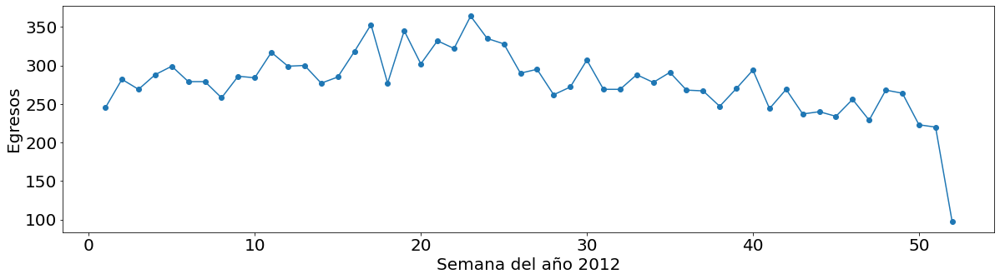


O339


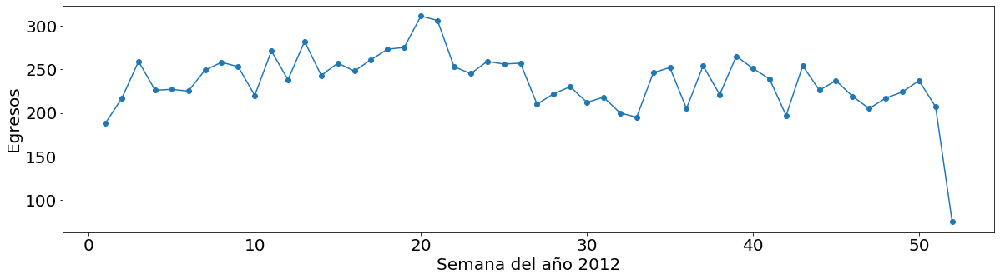


O429


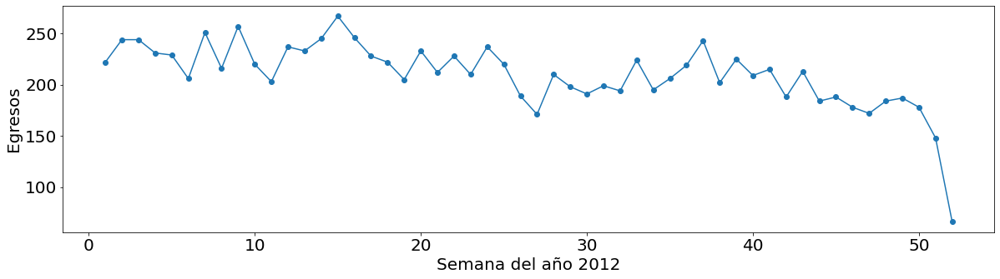


K409


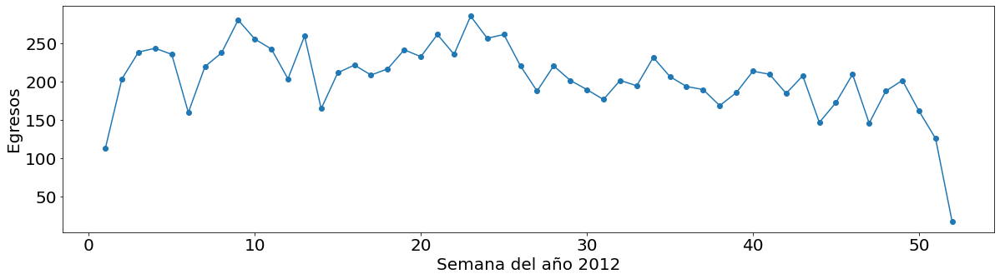


A09X


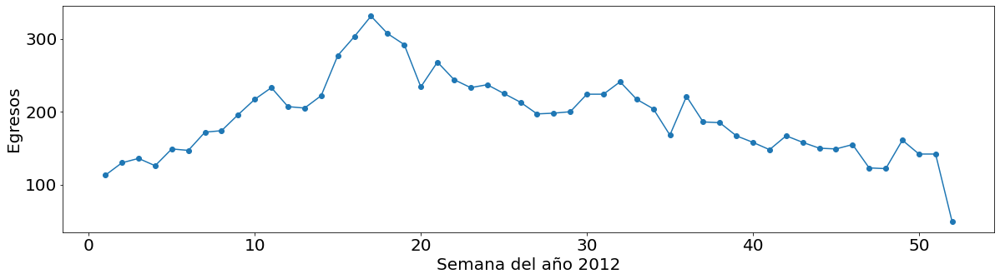


O470


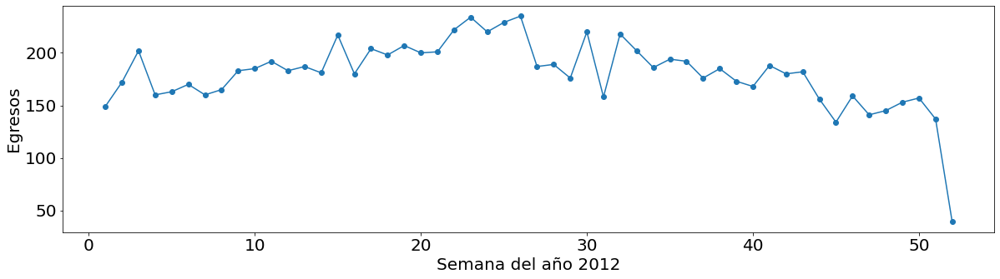


J189


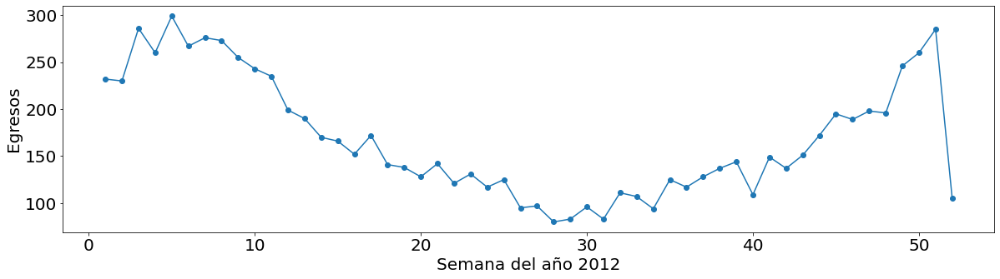


O410


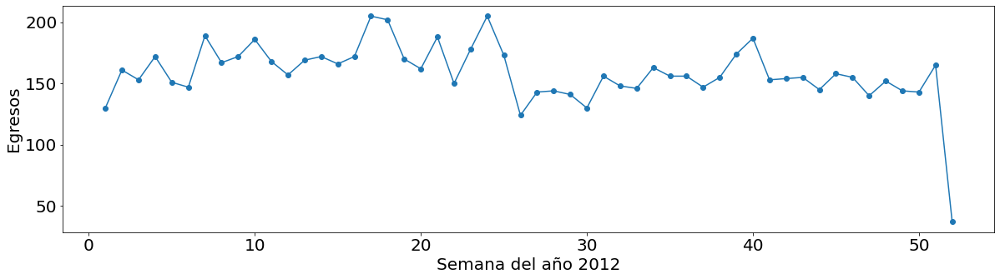


R69X


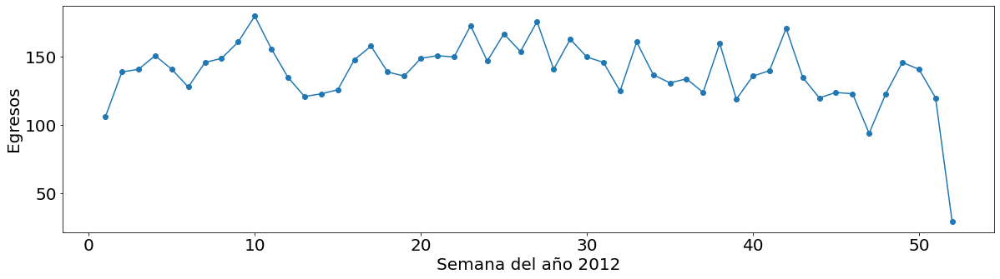


D259


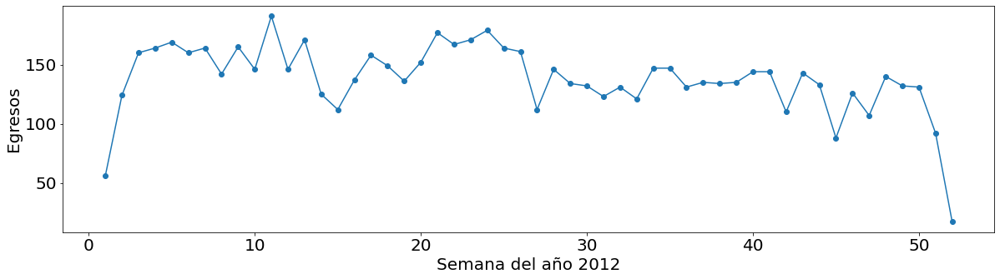


P073


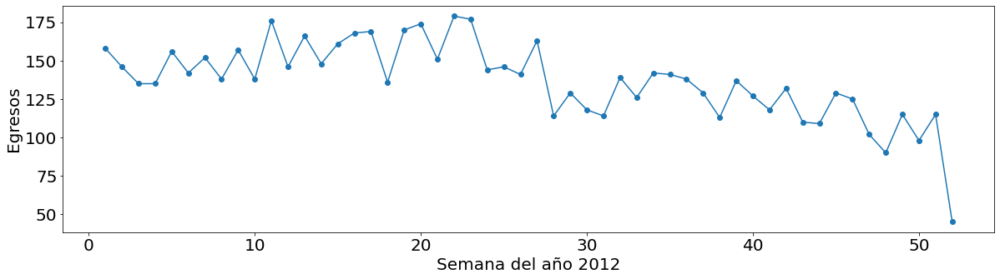


K802


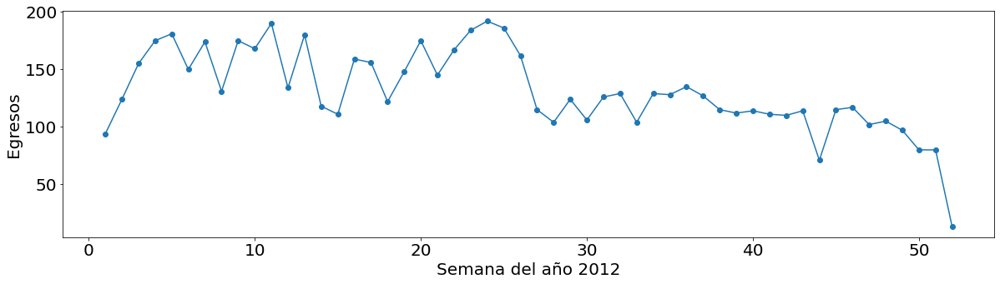


K811


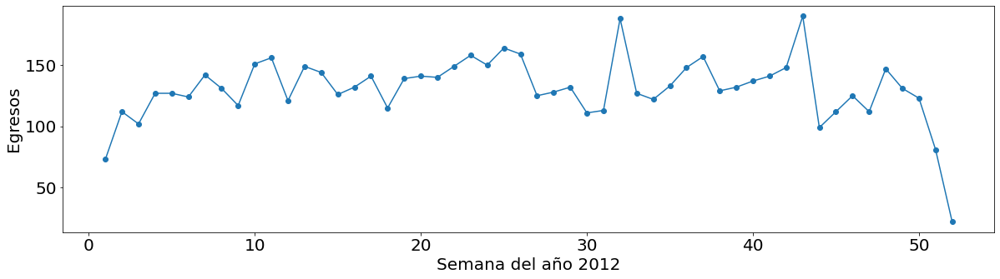


O820


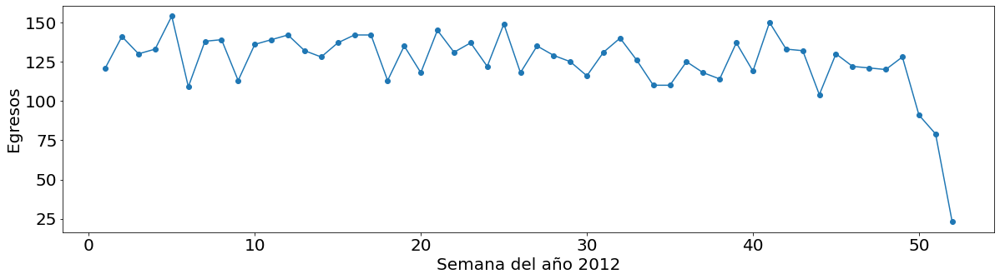


J219


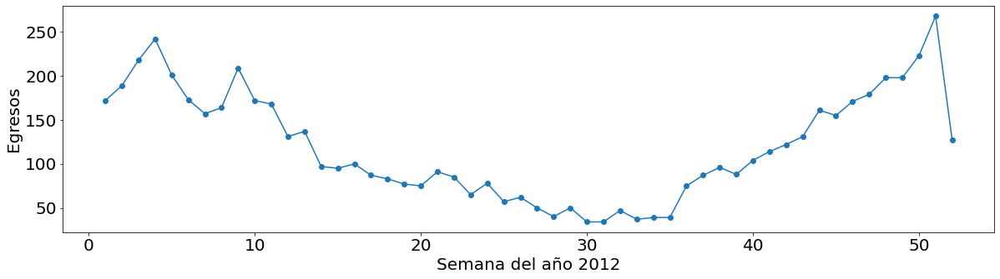


N180


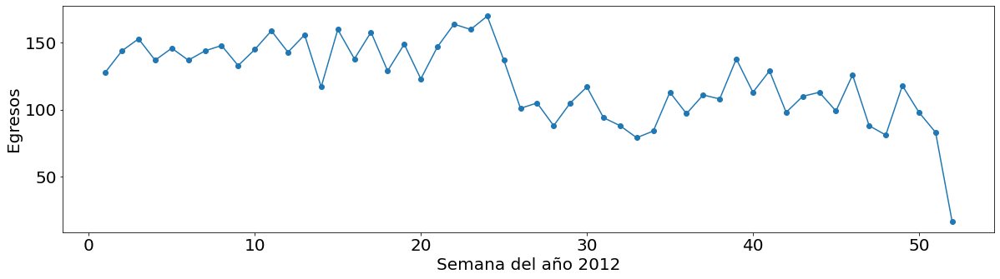


O021


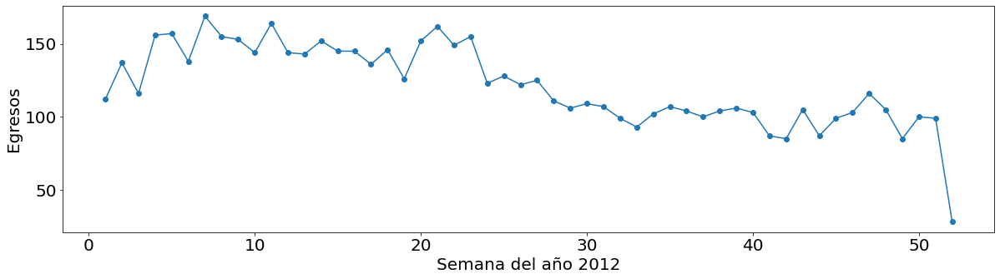


O200


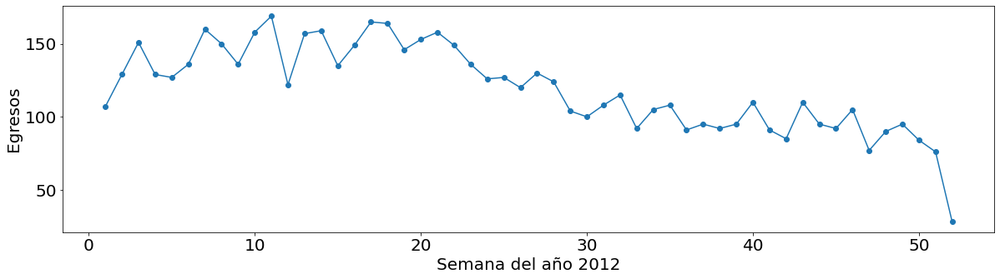


K801


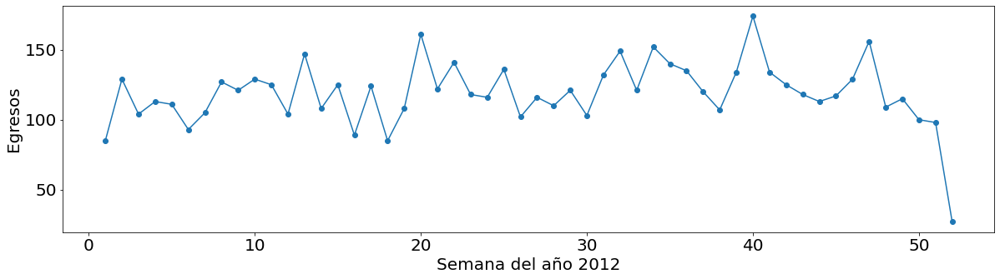


G020


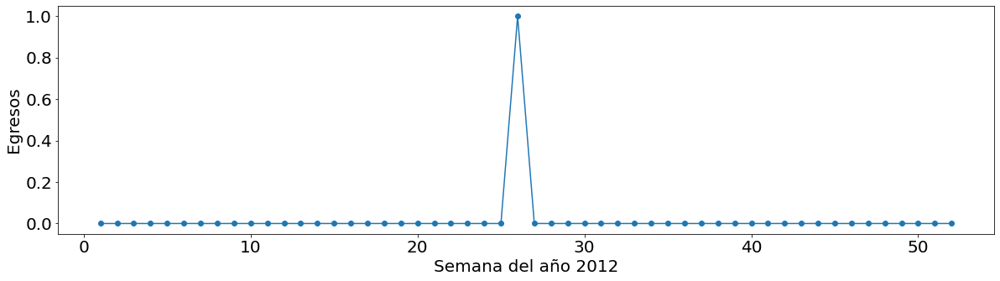


K003


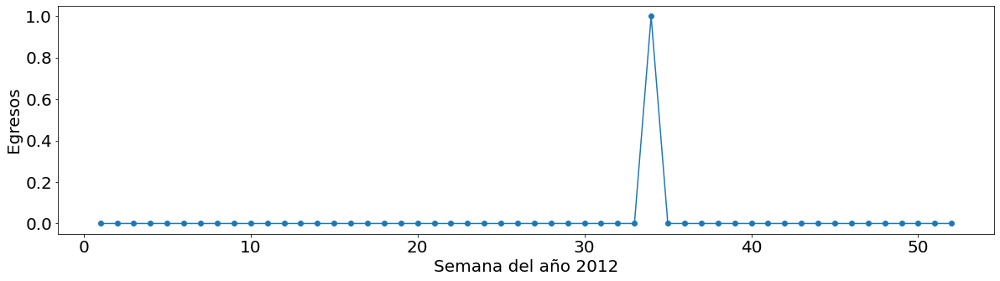


K009


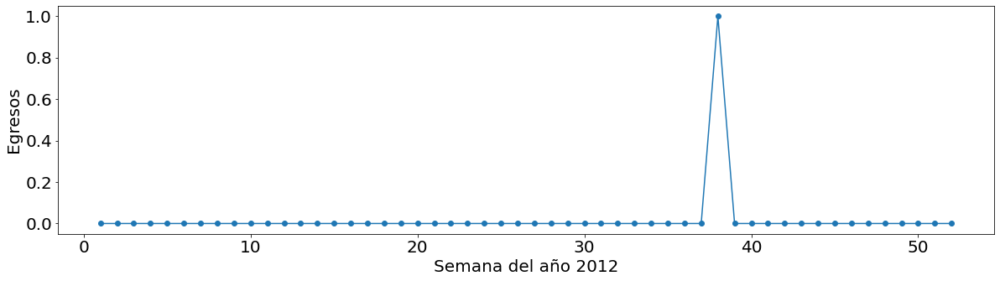


Q434


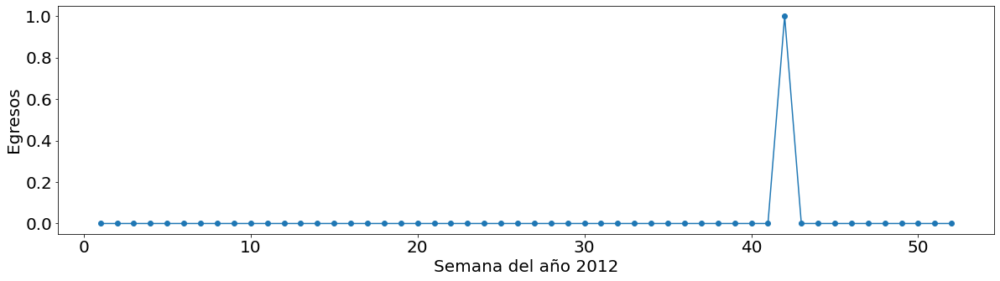


T573


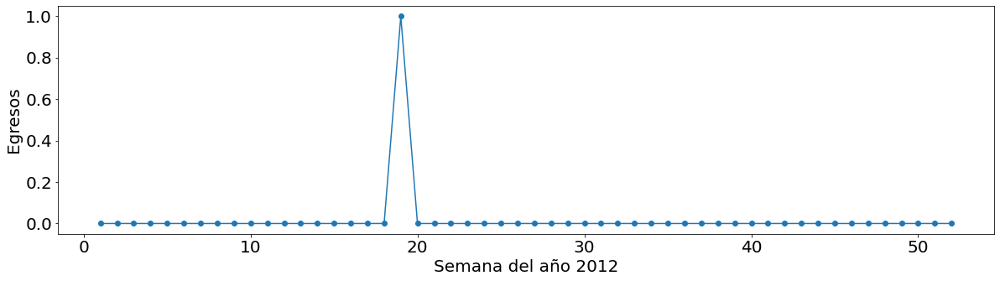

In [132]:
# Se crea el dataframe 'diagnosticos' con los nombre de los diferentes diagnosticos sin repeticion
diagnosticos2 = dataframe2['DIAG_INI'].value_counts()
# Se ordena del diagnostico con mayore numero de egresos al diagnostico con menor numero de egresos
diagnosticos2 = diagnosticos2.sort_values(ascending = False)
# Se crea el dataframe 'cie' con los nombres de los diagnosticos, los numeros de las semanas, y la cantidad de diagnosticos de dicha enfermedad en cada semana
cie2 = dataframe2.groupby(['DIAG_INI', 'sem']).count()

# Se importa la libreria necesaria para la figura
import matplotlib.pyplot as plt

plt.rcParams.update({'font.size': 20})

print('Año ' + año2 + '\n')
# Se inicia un contador para controlar la cantidad de graficos a generar
i2 = 0
ndiagnosticos2 = len(diagnosticos2.index)
maximo2 = ndiagnosticos2-5
# Proceso de generación de las figuras
for name2 in diagnosticos2.index:
    if i2 < 25 or i2 >= maximo2:
        y2 = []
        for index2 in semanas2.index:
            try:
                y2.append(cie2['EGRESO'][name2, index2])
            except:
                y2.append(0)
        print('\n' + name2)
        plt.figure(figsize=(20, 5))
        plt.scatter(semanas2.index, y2)
        plt.plot(semanas2.index, y2)
        plt.xlabel("Semana del año " + año2)
        plt.ylabel("Egresos")
        plt.savefig(año2 + '/' + name2 + '_' + año2 + '.jpg', format='jpg')
        plt.show()
    i2 = i2+1

# 2013

In [6]:
import pandas as pd 

# Se cargan los datos
colums3 = ['EGRESO', 'DIAG_INI']
dataframe3 = pd.read_csv('EGRESO_2013.csv', usecols=colums3).dropna()
dataframe3

,EGRESO,DIAG_INI
0,26/12/2012,O821
1,26/12/2012,O010
2,26/12/2012,O821
3,26/12/2012,O809
4,26/12/2012,O620
...,...,...
2879308,04/08/2013,E145
2879309,03/08/2013,J459
2879310,04/08/2013,S720
2879311,05/07/2013,D443


In [15]:
# Se importan las librerias necesarias
from epiweeks import Week, date

# Se convierten los string a objetos datetime en 'dataframe'
strfdtoriginal3 = '%d/%m/%Y'
dataframe3['EGRESO'] = pd.to_datetime(dataframe3['EGRESO'], errors='coerce', format=strfdtoriginal3)
dataframe3 = dataframe3.dropna()
dataframe3 = dataframe3.reset_index(drop=True)

# Se agrega una columna con los numeros de semana
dataframe3['sem'] = ''
nrows3 = len(dataframe3.index)
for i in range(nrows3):
    dfday3 = dataframe3['EGRESO'][i]
    if dfday3.year==2013:
        mydate3 = date(dfday3.year, dfday3.month, dfday3.day)
        numberweek3 = Week.fromdate(mydate3)
        dataframe3['sem'][i] = numberweek3.week

dataframe3 = dataframe3.dropna()
dataframe3 = dataframe3.reset_index(drop=True)    
dataframe3

,EGRESO,DIAG_INI,sem
0,2012-12-26,O821,
1,2012-12-26,O010,
2,2012-12-26,O821,
3,2012-12-26,O809,
4,2012-12-26,O620,
...,...,...,...
2879308,2013-08-04,E145,32
2879309,2013-08-03,J459,31
2879310,2013-08-04,S720,32
2879311,2013-07-05,D443,27


In [57]:
# Se forma el nuevo dataframe 'semanas' con el numero de semana del año y la cantidad de egresos en cada semana
semanas3 = dataframe3['sem'].value_counts()
semanas3 = semanas3.drop('', axis = 0)
semanas3 = semanas3.sort_index()
semanas3

1     30917
2     51944
3     54767
4     55143
5     56515
6     53178
7     56002
8     55853
9     55571
10    56491
11    56657
12    53958
13    51466
14    52506
15    54445
16    55322
17    55199
18    51481
19    54249
20    54902
21    56010
22    55427
23    55435
24    55423
25    54589
26    54972
27    54102
28    55326
29    54767
30    55215
31    55467
32    56402
33    57405
34    57124
35    58985
36    58378
37    59142
38    55204
39    59186
40    59148
41    59384
42    58773
43    57475
44    56153
45    57378
46    57442
47    53195
48    56061
49    55459
50    54729
51    53190
52    24679
Name: sem, dtype: int64

In [58]:
# Se pasa a un nuevo dataframe
newdf3 = pd.DataFrame()
newdf3['sem'] = semanas3.index 
newdf3['casos'] = ''
nr3 = len(newdf3.index)
for i in range (nr3):
    newdf3['casos'][i] = int(semanas3[i+1])
newdf3

,sem,casos
0,1,30917
1,2,51944
2,3,54767
3,4,55143
4,5,56515
5,6,53178
6,7,56002
7,8,55853
8,9,55571
9,10,56491


Egresos 2013


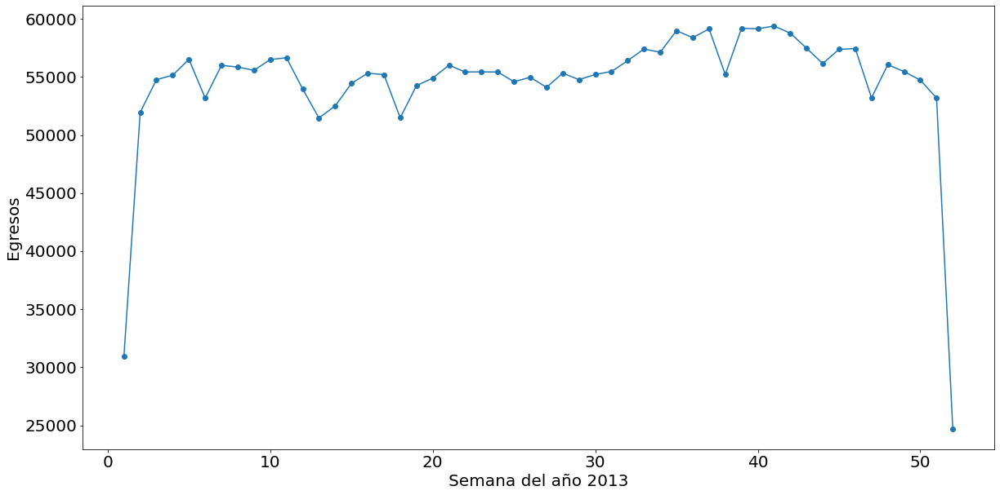

In [133]:
# Se importan las librerias necesarias
import matplotlib.pyplot as plt

año3 = '2013'
print('Egresos ' + año3)
# Se establece el tamaño de la figura
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(20, 10))
# Se define que se unan los puntos en la gráfica
plt.scatter(semanas3.index, newdf3.casos)
# Se definen las coordenadas 'x' y 'y'
plt.plot(semanas3.index, newdf3.casos)
# Se coloca un título para el eje x
plt.xlabel("Semana del año " + año3)
# Se coloca un título para el eje y
plt.ylabel("Egresos")
# Se guarda la figura como un archivo
plt.savefig(año3 + '/Egresos' + año3 + '.jpg', format='jpg')
# Se muestra la figura en la terminal
plt.show()

Año 2013


O809


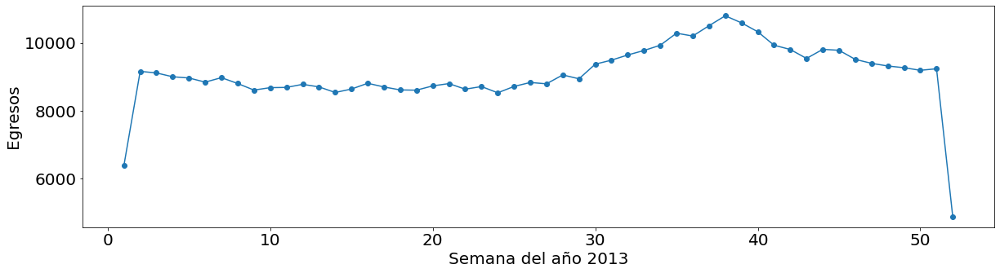


O800


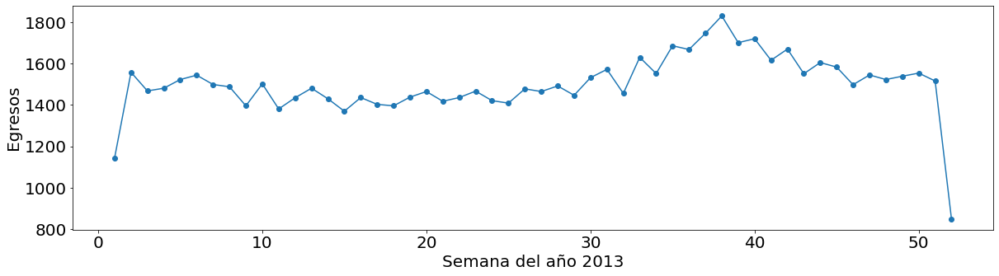


O829


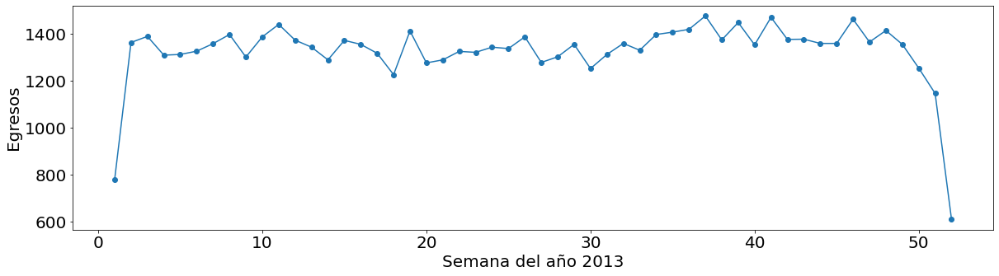


N189


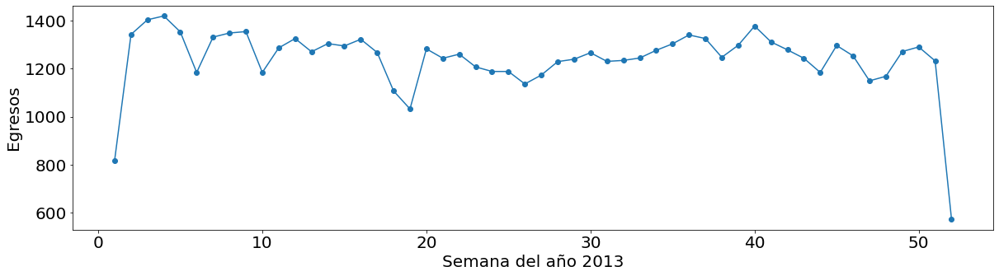


O064


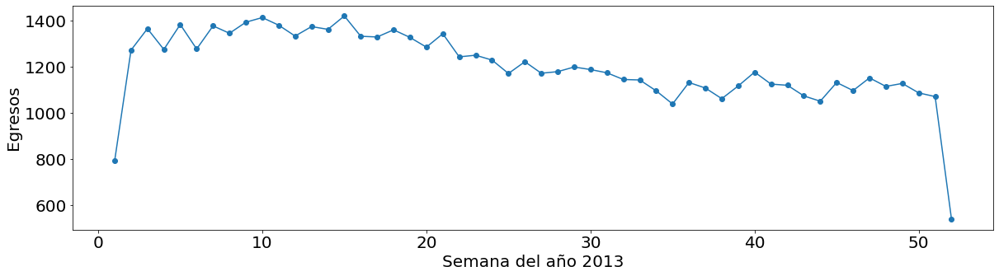


O342


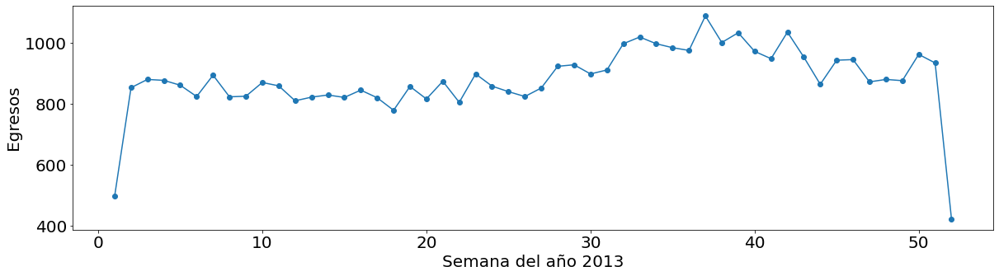


K359


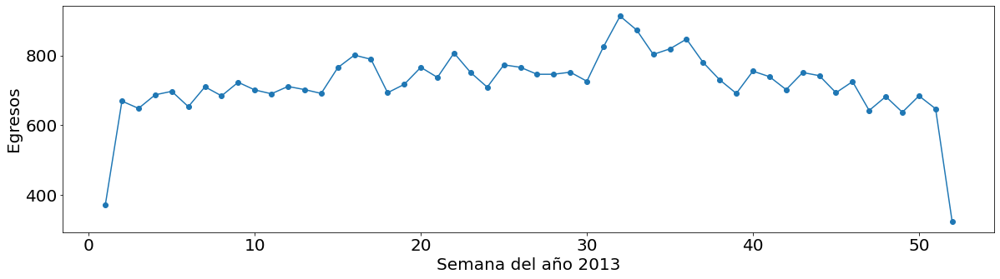


O339


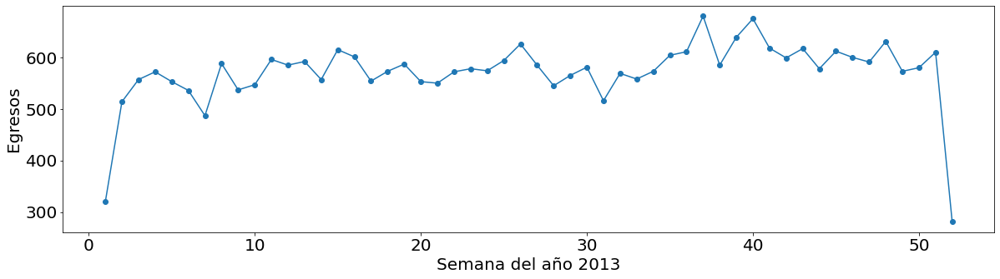


O429


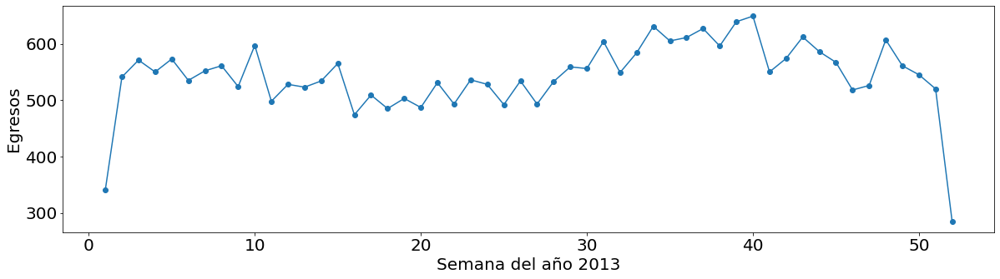


J189


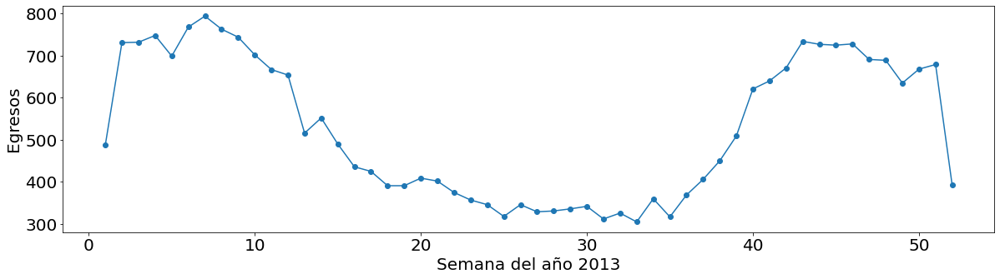


K409


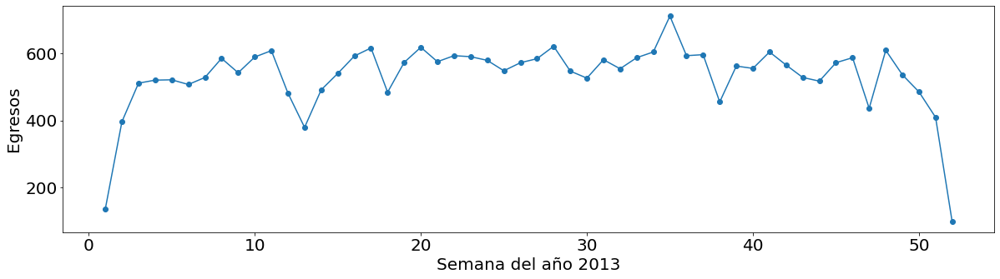


O470


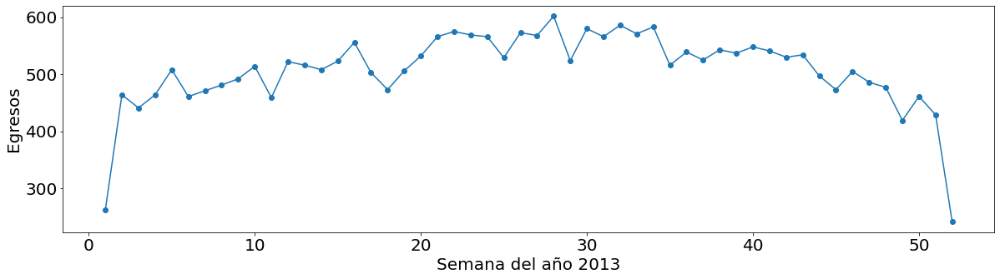


N180


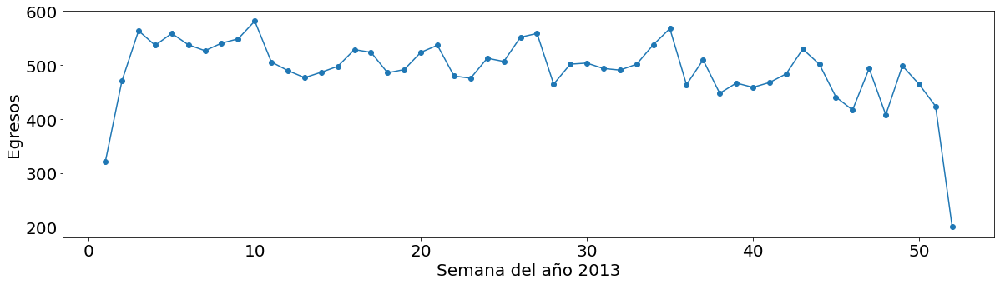


O410


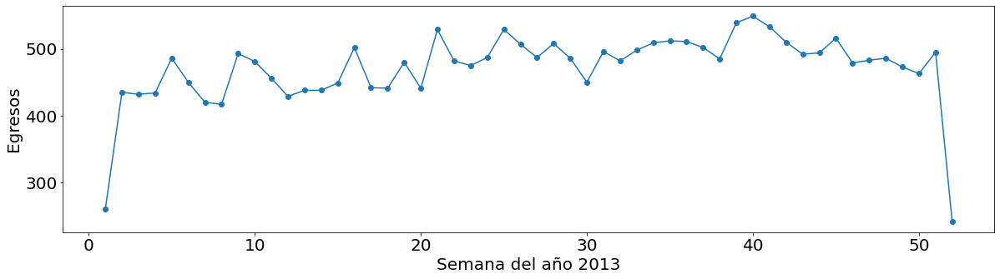


K801


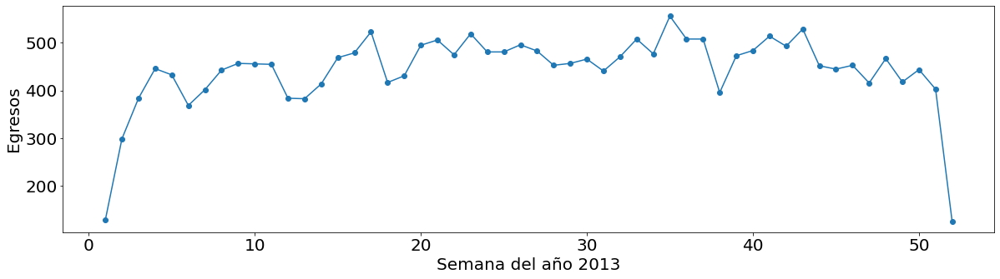


D259


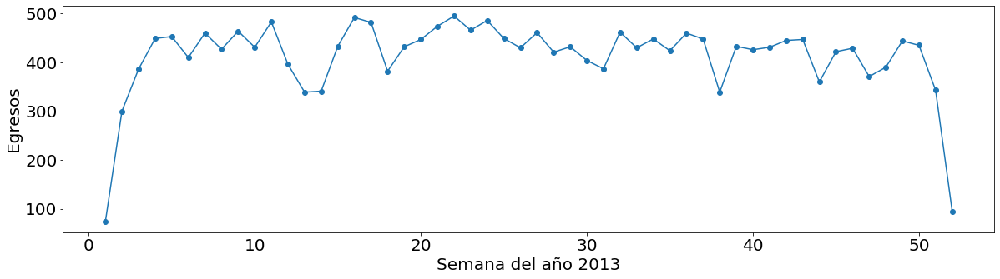


R69X


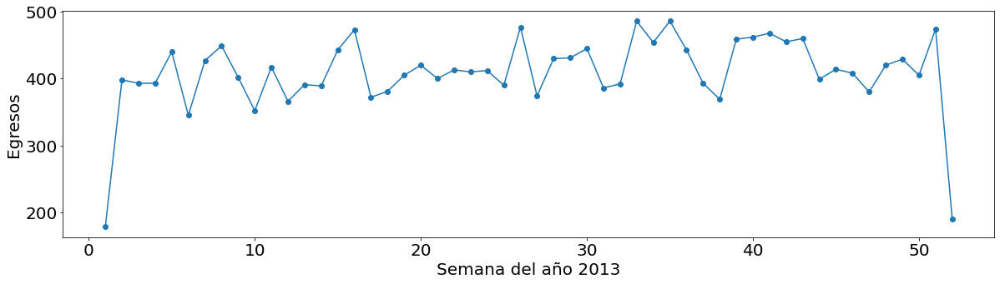


P073


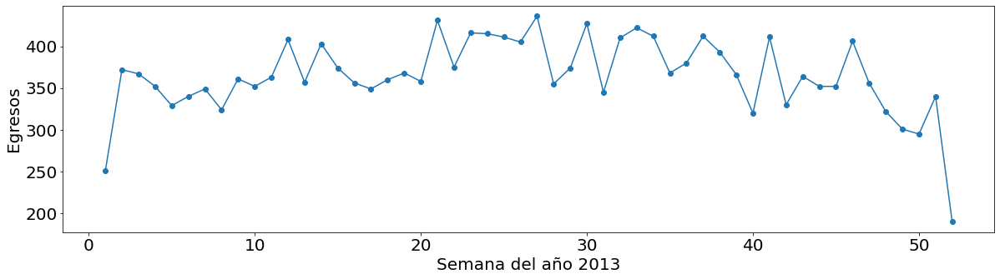


A09X


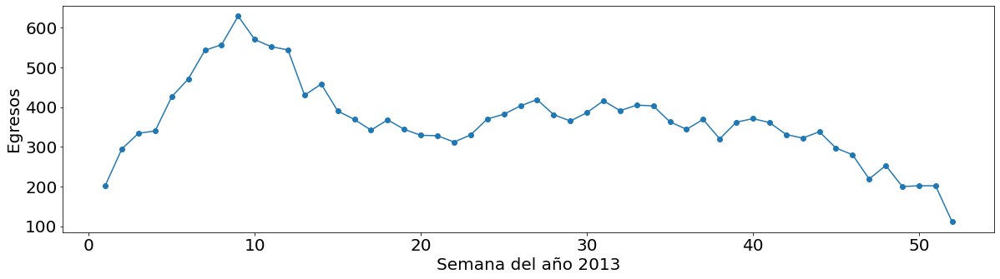


K811


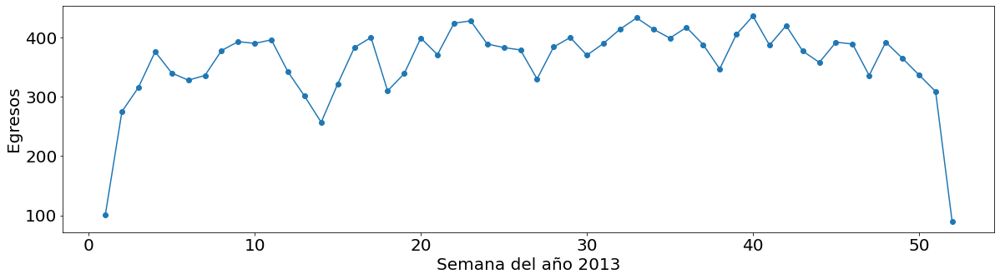


C509


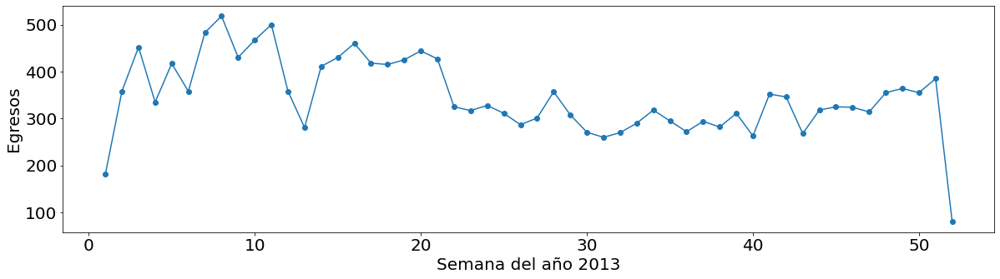


C910


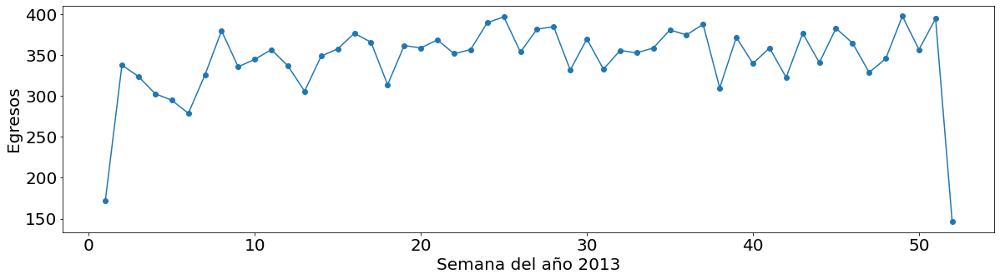


O13X


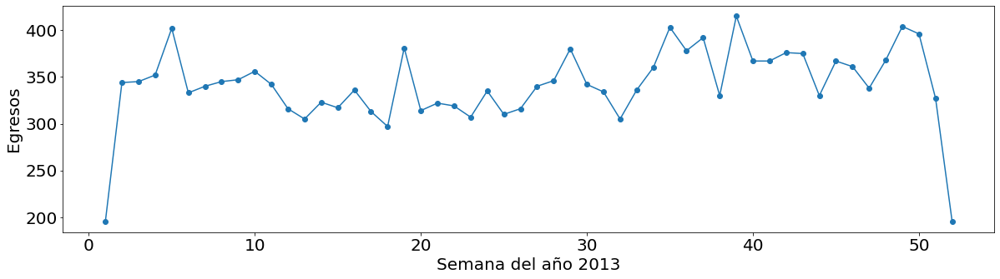


O200


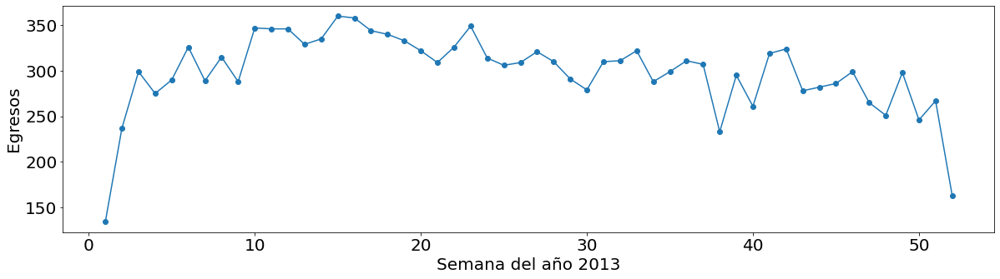


E119


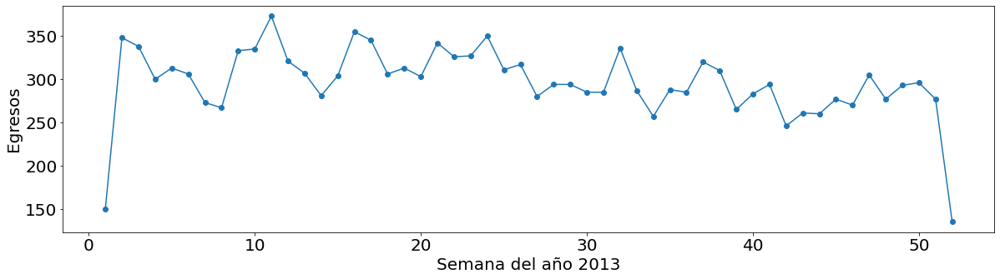


G590


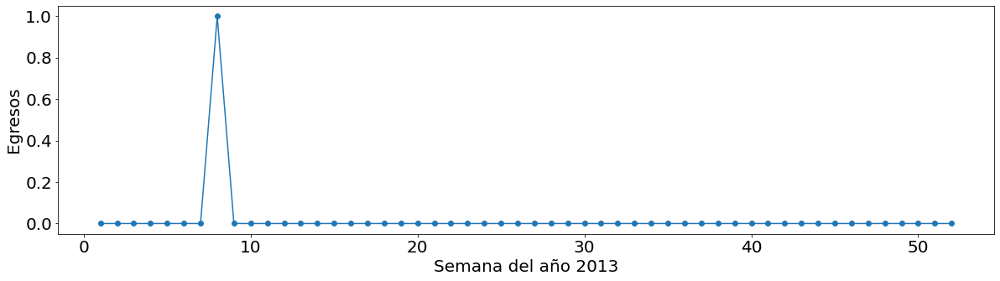


L683


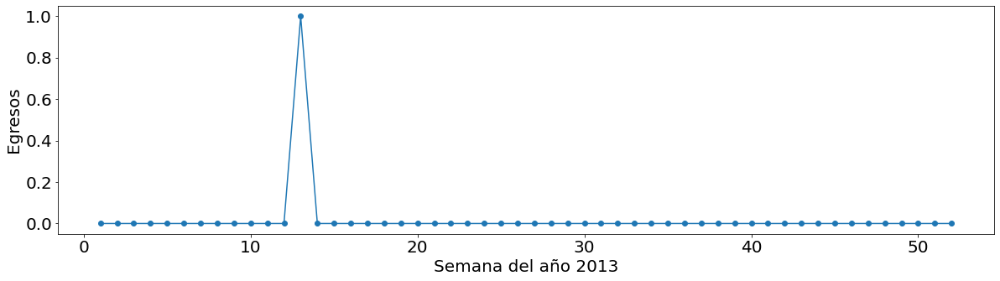


T593


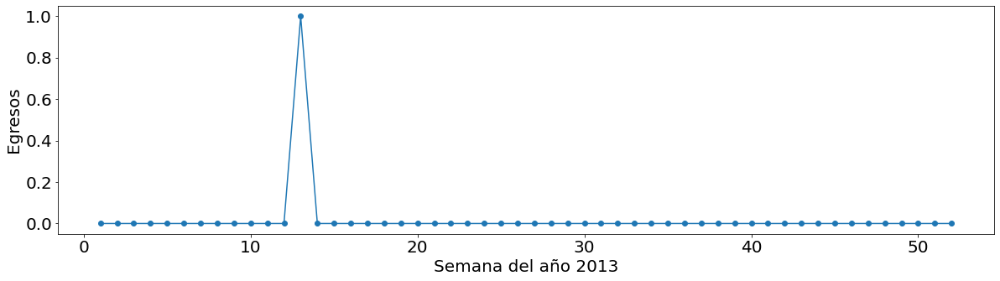


M051


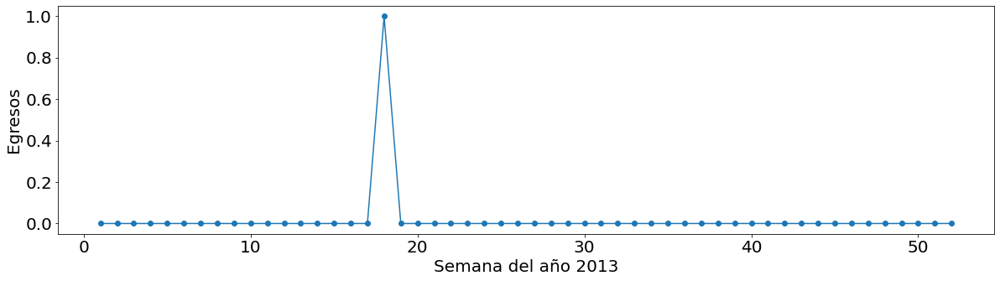


Z749


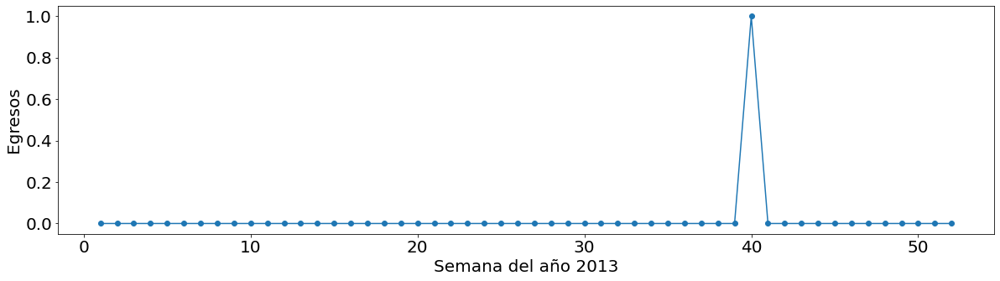

In [134]:
# Se crea el dataframe 'diagnosticos' con los nombre de los diferentes diagnosticos sin repeticion
diagnosticos3 = dataframe3['DIAG_INI'].value_counts()
# Se ordena del diagnostico con mayore numero de egresos al diagnostico con menor numero de egresos
diagnosticos3 = diagnosticos3.sort_values(ascending = False)
# Se crea el dataframe 'cie' con los nombres de los diagnosticos, los numeros de las semanas, y la cantidad de diagnosticos de dicha enfermedad en cada semana
cie3 = dataframe3.groupby(['DIAG_INI', 'sem']).count()

# Se importa la libreria necesaria para la figura
import matplotlib.pyplot as plt

plt.rcParams.update({'font.size': 20})

print('Año ' + año3 + '\n')
# Se inicia un contador para controlar la cantidad de graficos a generar
i3 = 0
ndiagnosticos3 = len(diagnosticos3.index)
maximo3 = ndiagnosticos3-5
# Proceso de generación de las figuras
for name3 in diagnosticos3.index:
    if i3 < 25 or i3 >= maximo3:
        y3 = []
        for index3 in semanas3.index:
            try:
                y3.append(cie3['EGRESO'][name3, index3])
            except:
                y3.append(0)
        print('\n' + name3)
        plt.figure(figsize=(20, 5))
        plt.scatter(semanas3.index, y3)
        plt.plot(semanas3.index, y3)
        plt.xlabel("Semana del año " + año3)
        plt.ylabel("Egresos")
        plt.savefig(año3 + '/' + name3 + '_' + año3 + '.jpg', format='jpg')
        plt.show()
    i3 = i3+1

# 2014

In [7]:
import pandas as pd 

# Se cargan los datos
colums4 = ['EGRESO', 'DIAG_INI']
dataframe4 = pd.read_csv('EGRESO_2014.csv', usecols=colums4).dropna()
dataframe4

,EGRESO,DIAG_INI
0,2014-11-20 00:00:00,P220
1,2014-09-17 00:00:00,O829
2,2014-09-10 00:00:00,O809
3,2014-09-05 00:00:00,O689
4,2014-09-04 00:00:00,O809
...,...,...
2959192,2014-10-02 00:00:00,O649
2959193,2014-11-18 00:00:00,O809
2959194,2014-12-19 00:00:00,O470
2959195,2014-01-14 00:00:00,O809


In [16]:
# Se importan las librerias necesarias
from epiweeks import Week, date

# Se convierten los string a objetos datetime en 'dataframe'
strfdtoriginal4 = '%Y-%m-%d %H:%M:%S'
dataframe4['EGRESO'] = pd.to_datetime(dataframe4['EGRESO'], errors='coerce', format=strfdtoriginal4)
dataframe4 = dataframe4.dropna()
dataframe4 = dataframe4.reset_index(drop=True)

# Se agrega una columna con los numeros de semana
dataframe4['sem'] = ''
nrows4 = len(dataframe4.index)
for i in range(nrows4):
    dfday4 = dataframe4['EGRESO'][i]
    if dfday4.year==2014:
        mydate4 = date(dfday4.year, dfday4.month, dfday4.day)
        numberweek4 = Week.fromdate(mydate4)
        dataframe4['sem'][i] = numberweek4.week
    
dataframe4 = dataframe4.dropna()
dataframe4 = dataframe4.reset_index(drop=True)    
dataframe4

,EGRESO,DIAG_INI,sem
0,2014-11-20,P220,47
1,2014-09-17,O829,38
2,2014-09-10,O809,37
3,2014-09-05,O689,36
4,2014-09-04,O809,36
...,...,...,...
2959192,2014-10-02,O649,40
2959193,2014-11-18,O809,47
2959194,2014-12-19,O470,51
2959195,2014-01-14,O809,3


In [61]:
# Se forma el nuevo dataframe 'semanas' con el numero de semana del año y la cantidad de egresos en cada semana
semanas4 = dataframe4['sem'].value_counts()
semanas4 = semanas4.drop('', axis = 0)
semanas4 = semanas4.sort_index()
semanas4

1     23312
2     51774
3     55426
4     55220
5     57112
6     53354
7     55606
8     56075
9     56113
10    56754
11    57918
12    54352
13    58534
14    57541
15    57472
16    51809
17    53967
18    53470
19    52428
20    56835
21    56361
22    58079
23    58118
24    57917
25    57070
26    57280
27    56855
28    57669
29    58157
30    57816
31    57907
32    57712
33    57097
34    57984
35    60024
36    60197
37    61139
38    56277
39    60859
40    61418
41    61557
42    59699
43    58636
44    59131
45    57958
46    59866
47    54846
48    59227
49    57866
50    57841
51    56454
52    34577
Name: sem, dtype: int64

In [69]:
# Se pasa a un nuevo dataframe
newdf4 = pd.DataFrame()
newdf4['sem'] = semanas4.index 
newdf4['casos'] = ''
nr4 = len(newdf4.index)
for i in range (nr4):
    newdf4['casos'][i] = int(semanas4[i+1])
newdf4

,sem,casos
0,1,23312
1,2,51774
2,3,55426
3,4,55220
4,5,57112
5,6,53354
6,7,55606
7,8,56075
8,9,56113
9,10,56754


Egresos 2014


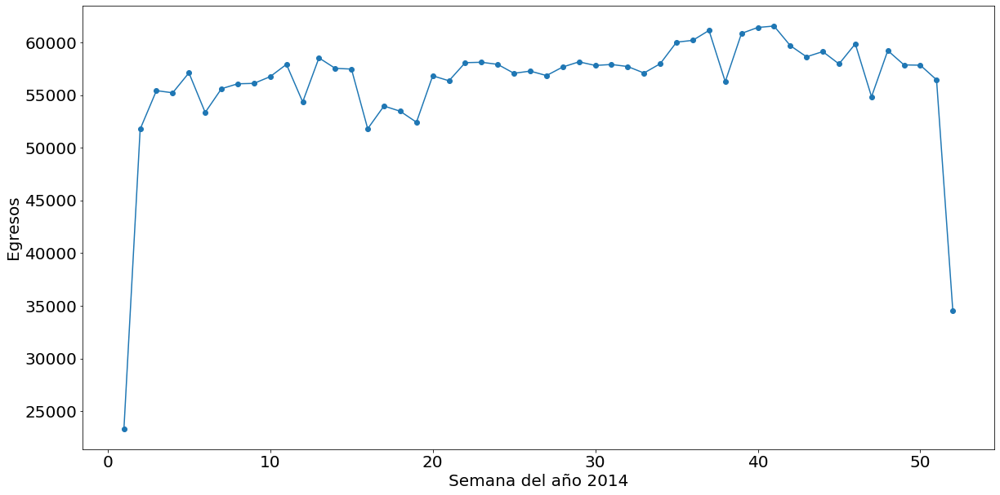

In [135]:
# Se importan las librerias necesarias
import matplotlib.pyplot as plt

año4 = '2014'
print('Egresos ' + año4)
# Se establece el tamaño de la figura
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(20, 10))
# Se define que se unan los puntos en la gráfica
plt.scatter(semanas4.index, newdf4.casos)
# Se definen las coordenadas 'x' y 'y'
plt.plot(semanas4.index, newdf4.casos)
# Se coloca un título para el eje x
plt.xlabel("Semana del año " + año4)
# Se coloca un título para el eje y
plt.ylabel("Egresos")
# Se guarda la figura como un archivo
plt.savefig(año4 + '/Egresos' + año4 + '.jpg', format='jpg')
# Se muestra la figura en la terminal
plt.show()

Año 2014


O809


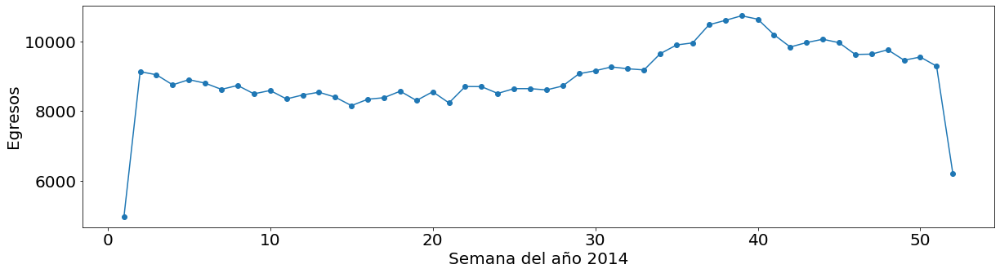


O800


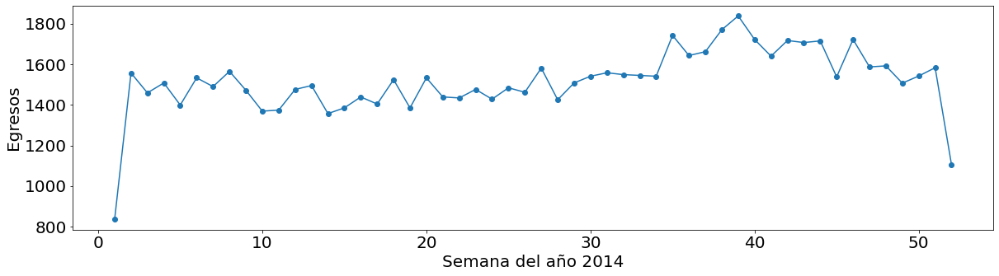


N189


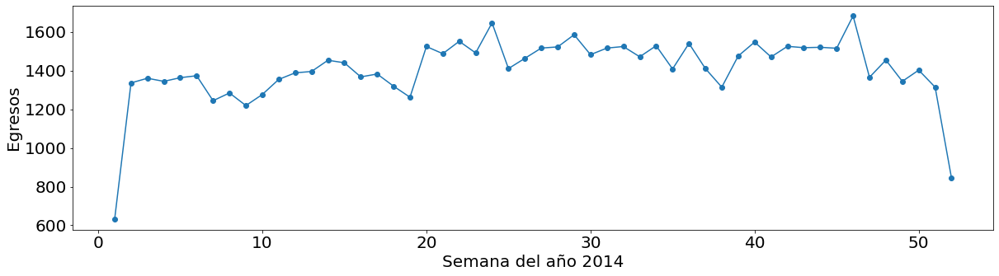


O829


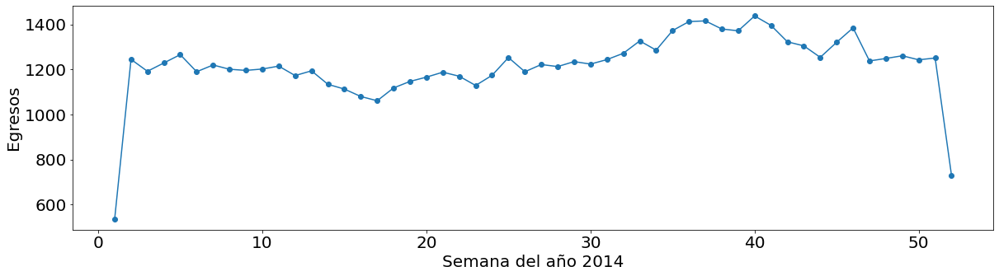


O064


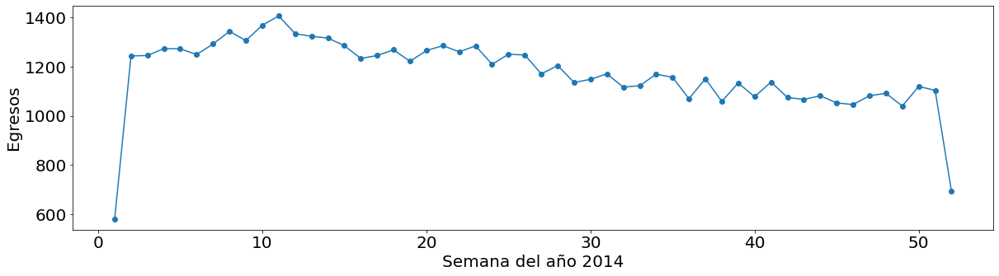


O342


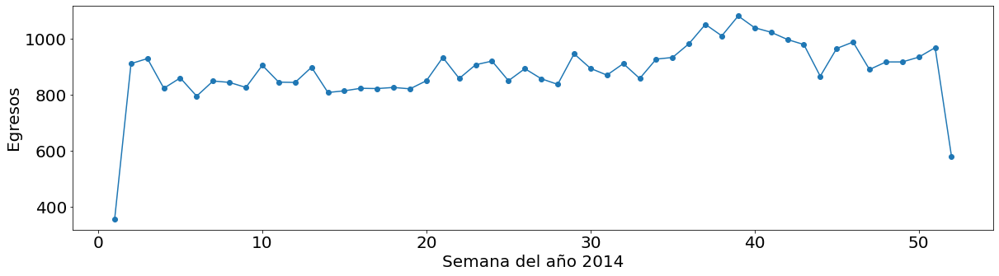


N185


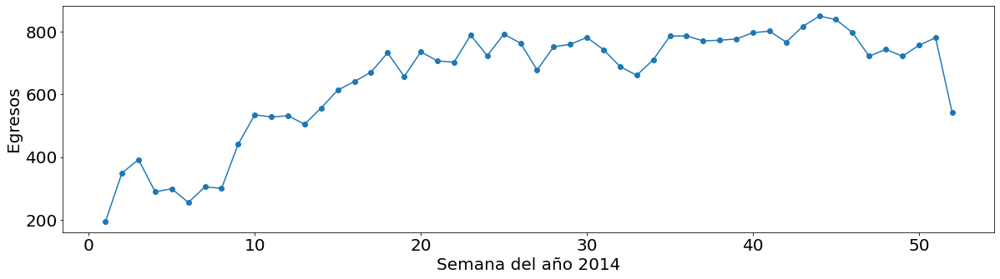


K358


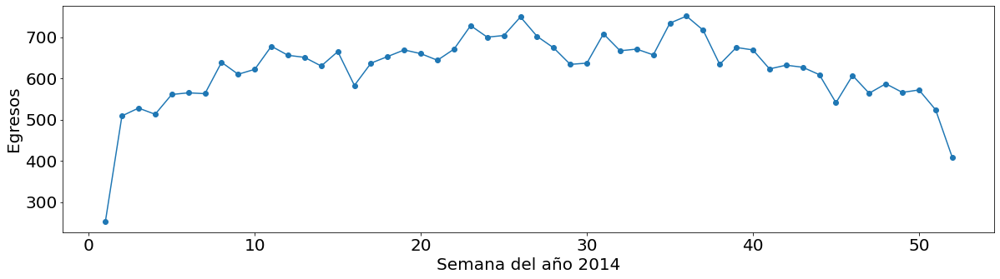


O429


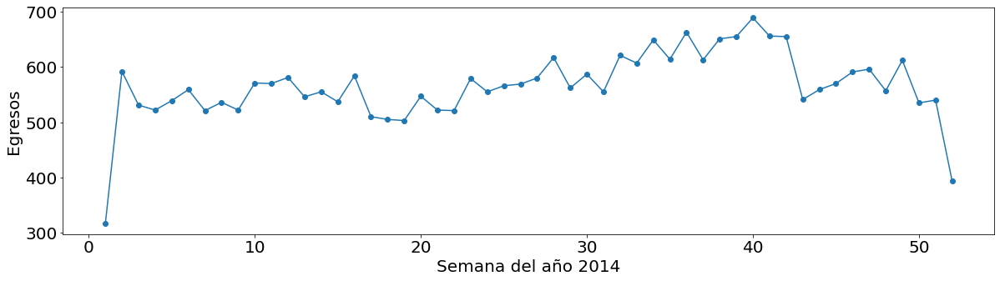


O339


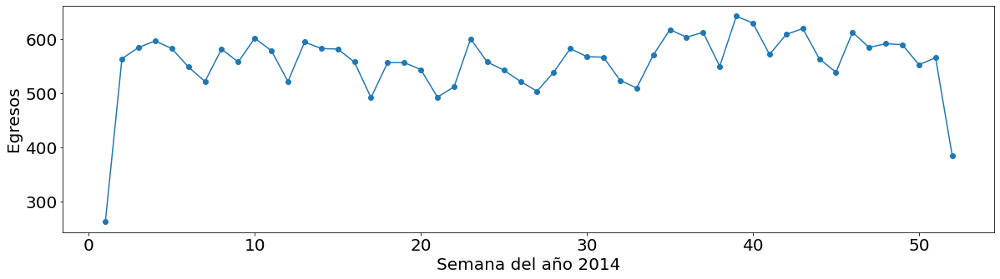


J189


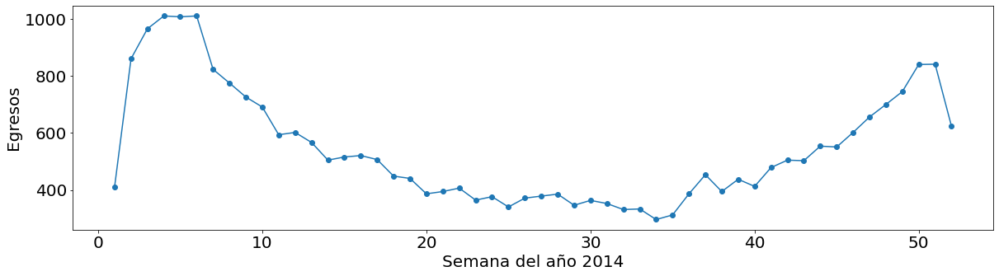


K409


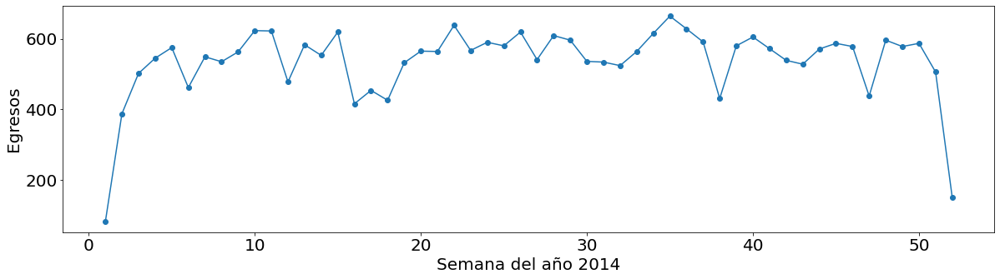


O470


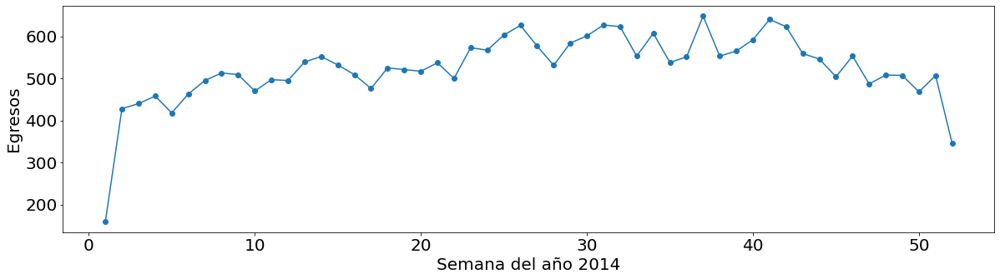


O410


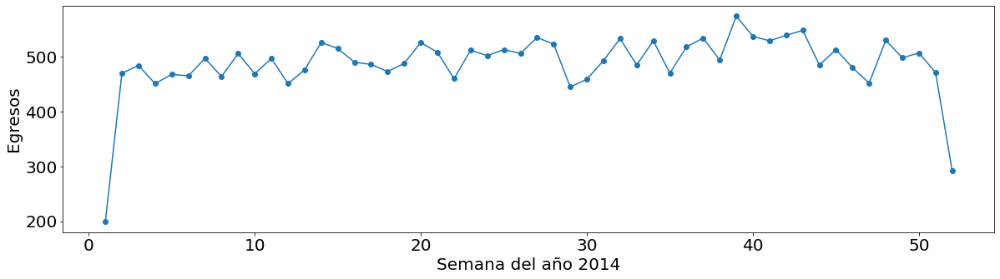


K801


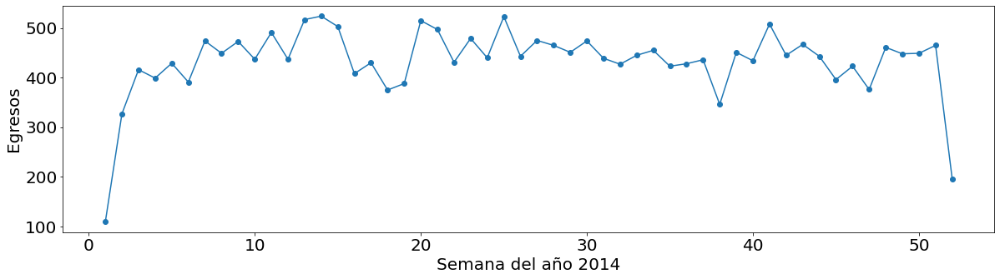


C509


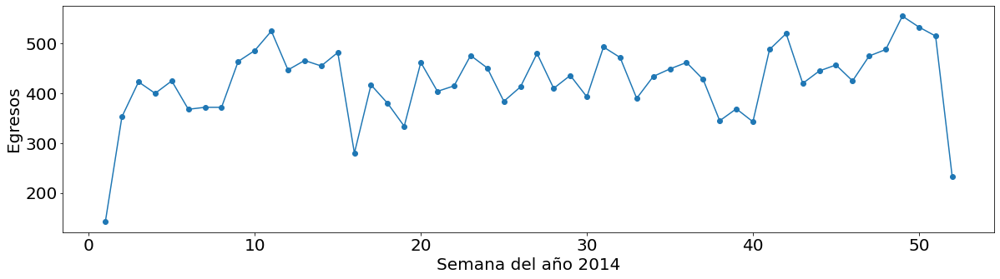


D259


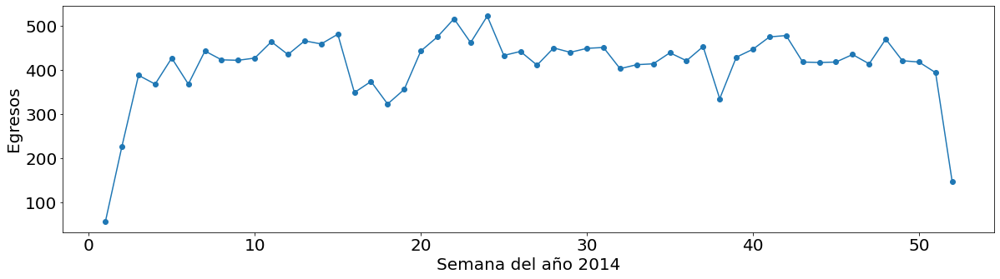


Z491


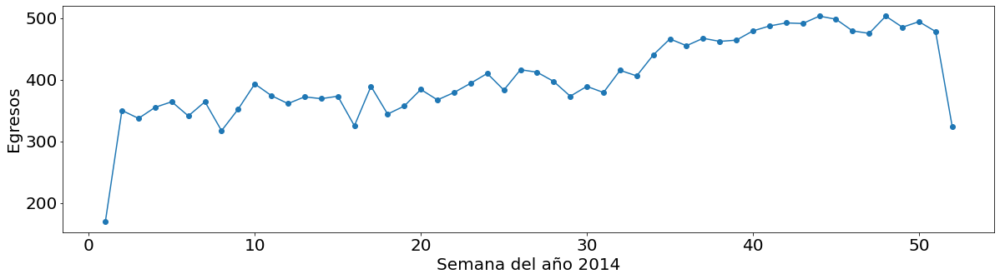


K37X


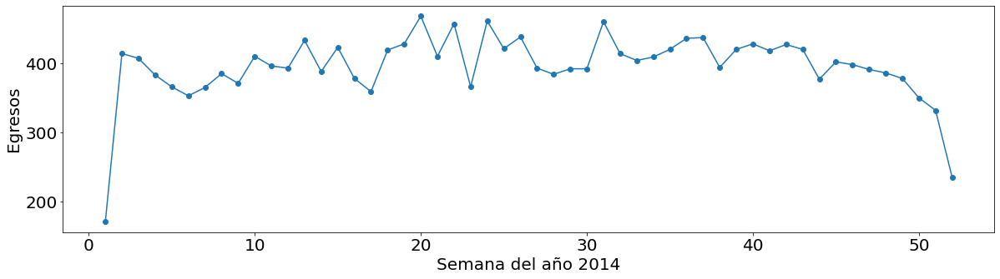


K811


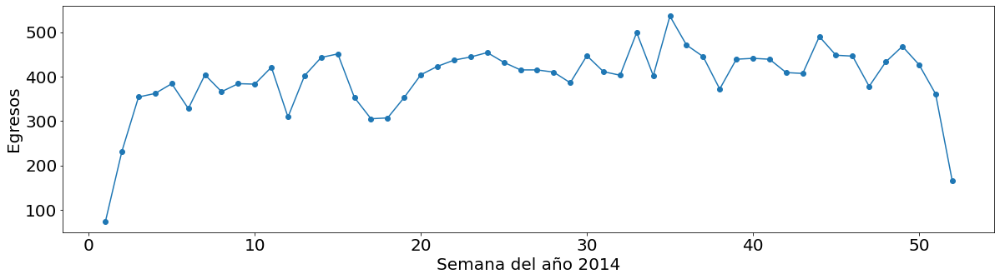


C910


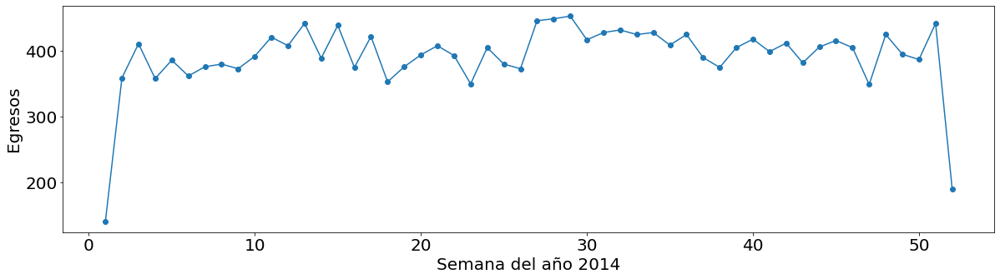


P073


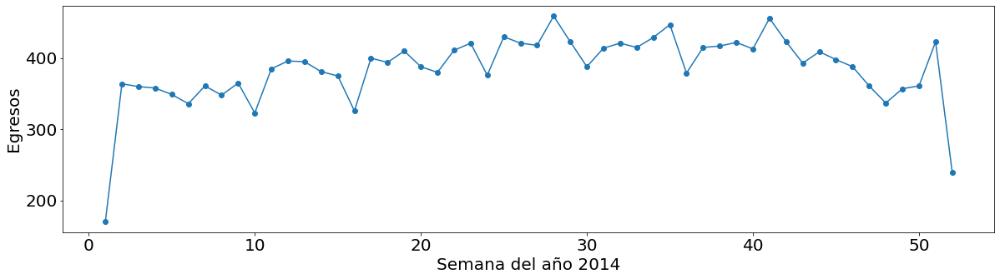


R69X


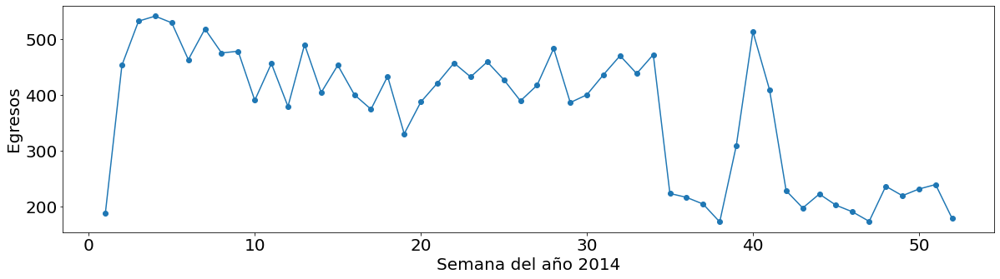


O13X


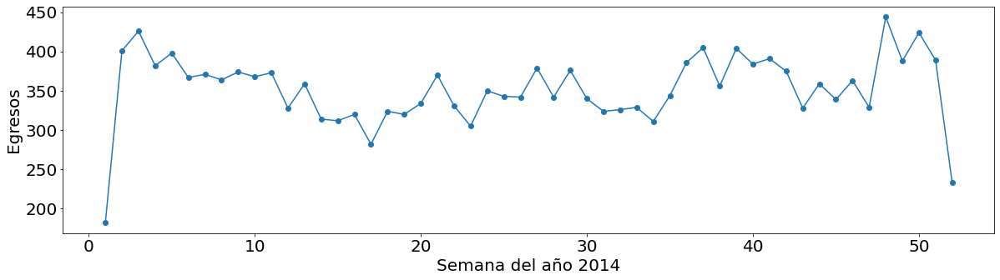


E119


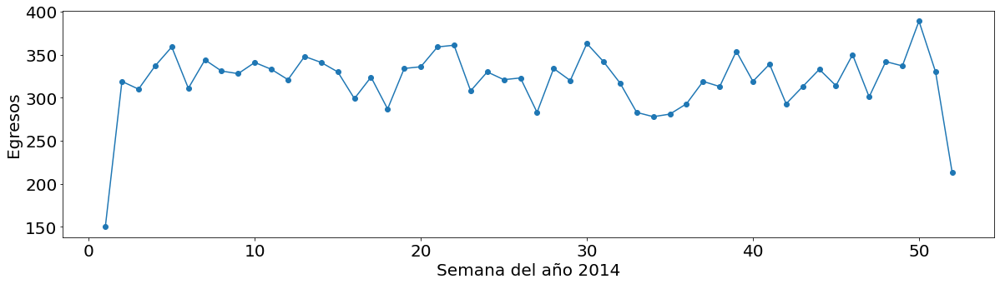


Q978


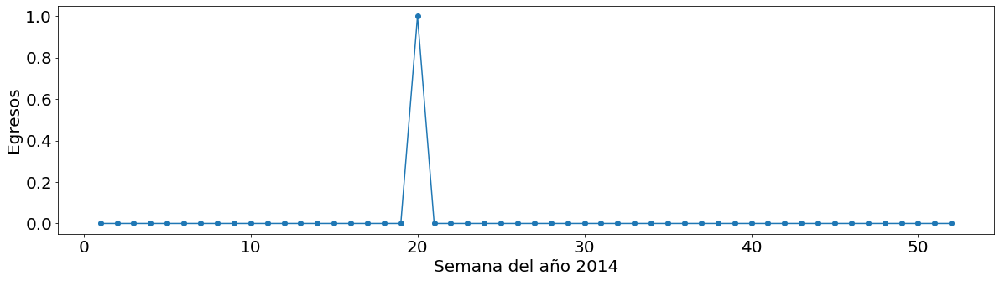


E770


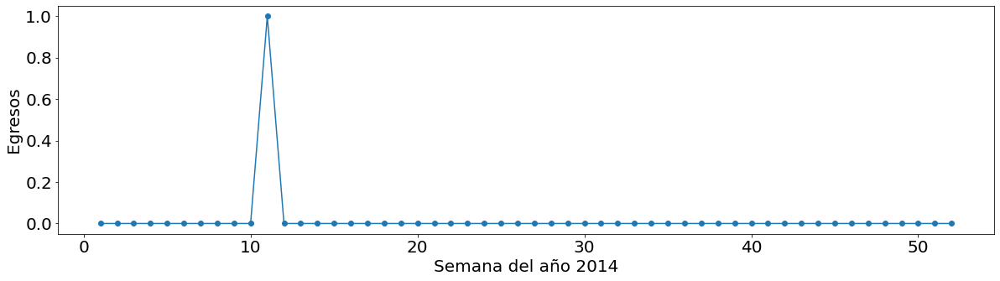


T690


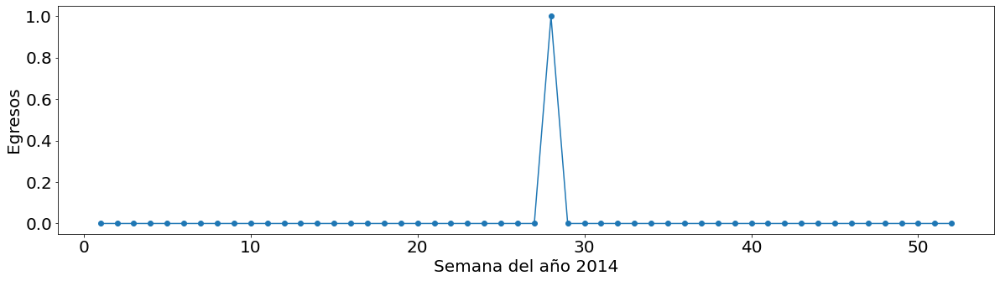


C674


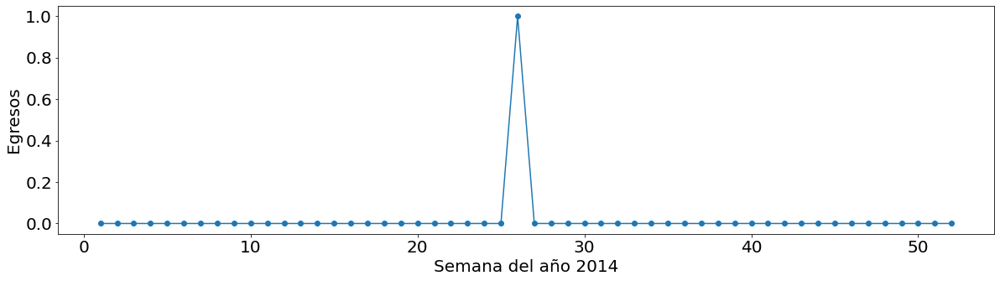


Z749


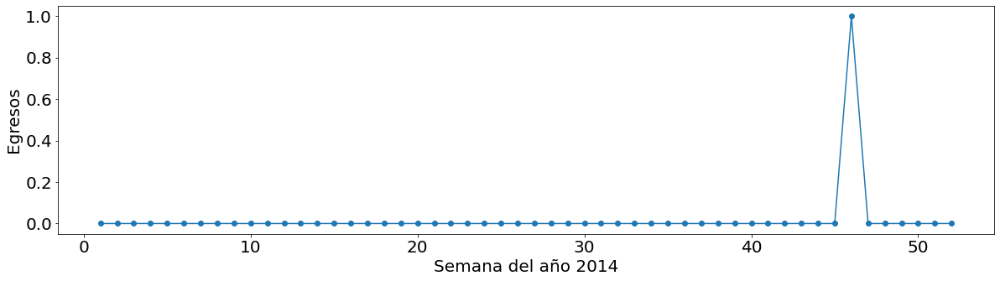

In [136]:
# Se crea el dataframe 'diagnosticos' con los nombre de los diferentes diagnosticos sin repeticion
diagnosticos4 = dataframe4['DIAG_INI'].value_counts()
# Se ordena del diagnostico con mayore numero de egresos al diagnostico con menor numero de egresos
diagnosticos4 = diagnosticos4.sort_values(ascending = False)
# Se crea el dataframe 'cie' con los nombres de los diagnosticos, los numeros de las semanas, y la cantidad de diagnosticos de dicha enfermedad en cada semana
cie4 = dataframe4.groupby(['DIAG_INI', 'sem']).count()

# Se importa la libreria necesaria para la figura
import matplotlib.pyplot as plt

plt.rcParams.update({'font.size': 20})

print('Año ' + año4 + '\n')
# Se inicia un contador para controlar la cantidad de graficos a generar
i4 = 0
ndiagnosticos4 = len(diagnosticos4.index)
maximo4 = ndiagnosticos4-5
# Proceso de generación de las figuras
for name4 in diagnosticos4.index:
    if i4 < 25 or i4 >= maximo4:
        y4 = []
        for index4 in semanas4.index:
            try:
                y4.append(cie4['EGRESO'][name4, index4])
            except:
                y4.append(0)
        print('\n' + name4)
        plt.figure(figsize=(20, 5))
        plt.scatter(semanas4.index, y4)
        plt.plot(semanas4.index, y4)
        plt.xlabel("Semana del año " + año4)
        plt.ylabel("Egresos")
        plt.savefig(año4 + '/' + name4 + '_' + año4 + '.jpg', format='jpg')
        plt.show()
    i4 = i4+1

# 2015

In [8]:
import pandas as pd 

# Se cargan los datos
colums5 = ['EGRESO', 'DIAG_INI']
dataframe5 = pd.read_csv('EGRESO_2015.csv', usecols=colums5, nrows=2500000).dropna()
dataframe5

,EGRESO,DIAG_INI
0,2015-01-03 00:00:00,C910
1,2015-01-03 00:00:00,C845
2,2015-01-03 00:00:00,C189
3,2015-01-03 00:00:00,C509
4,2015-01-03 00:00:00,C220
...,...,...
2499995,2015-02-09 00:00:00,O410
2499996,2015-03-12 00:00:00,K811
2499997,2015-04-08 00:00:00,O809
2499998,2015-05-10 00:00:00,O054


In [17]:
# Se importan las librerias necesarias
from epiweeks import Week, date

# Se convierten los string a objetos datetime en 'dataframe'
strfdtoriginal5 = '%Y-%m-%d %H:%M:%S'
dataframe5['EGRESO'] = pd.to_datetime(dataframe5['EGRESO'], errors='coerce', format=strfdtoriginal5)
dataframe5 = dataframe5.dropna()
dataframe5 = dataframe5.reset_index(drop=True)

# Se agrega una columna con los numeros de semana
dataframe5['sem'] = ''
nrows5 = len(dataframe5.index)
for i in range(nrows5):
    dfday5 = dataframe5['EGRESO'][i]
    if dfday5.year==2015:
        mydate5 = date(dfday5.year, dfday5.month, dfday5.day)
        numberweek5 = Week.fromdate(mydate5)
        dataframe5['sem'][i] = numberweek5.week
    
dataframe5 = dataframe5.dropna()
dataframe5 = dataframe5.reset_index(drop=True)    
dataframe5

,EGRESO,DIAG_INI,sem
0,2015-01-03,C910,53
1,2015-01-03,C845,53
2,2015-01-03,C189,53
3,2015-01-03,C509,53
4,2015-01-03,C220,53
...,...,...,...
2499995,2015-02-09,O410,6
2499996,2015-03-12,K811,10
2499997,2015-04-08,O809,14
2499998,2015-05-10,O054,19


In [83]:
# Se forma el nuevo dataframe 'semanas' con el numero de semana del año y la cantidad de egresos en cada semana
semanas5 = dataframe5['sem'].value_counts()
semanas5 = semanas5.drop('', axis = 0)
semanas5 = semanas5.sort_index()
semanas5

1     44314
2     47507
3     48330
4     49381
5     46542
6     49035
7     48313
8     49213
9     48990
10    49905
11    46079
12    49712
13    44580
14    46364
15    47680
16    48058
17    47197
18    44426
19    47733
20    48187
21    48794
22    48484
23    48844
24    47430
25    46821
26    48245
27    49058
28    48403
29    48423
30    49374
31    49081
32    49114
33    49120
34    49473
35    49948
36    50555
37    46763
38    50028
39    50709
40    51615
41    49976
42    48570
43    49416
44    46316
45    49821
46    45952
47    49110
48    49021
49    47650
50    46348
51    35336
53    14149
Name: sem, dtype: int64

In [85]:
semanas5[52] = 0
semanas5 = semanas5.sort_index()
semanas5

1     44314
2     47507
3     48330
4     49381
5     46542
6     49035
7     48313
8     49213
9     48990
10    49905
11    46079
12    49712
13    44580
14    46364
15    47680
16    48058
17    47197
18    44426
19    47733
20    48187
21    48794
22    48484
23    48844
24    47430
25    46821
26    48245
27    49058
28    48403
29    48423
30    49374
31    49081
32    49114
33    49120
34    49473
35    49948
36    50555
37    46763
38    50028
39    50709
40    51615
41    49976
42    48570
43    49416
44    46316
45    49821
46    45952
47    49110
48    49021
49    47650
50    46348
51    35336
52        0
53    14149
Name: sem, dtype: int64

In [86]:
# Se pasa a un nuevo dataframe
newdf5 = pd.DataFrame()
newdf5['sem'] = semanas5.index 
newdf5['casos'] = ''
nr5 = len(newdf5.index)
for i in range (nr5):
    newdf5['casos'][i] = int(semanas5[i+1])
newdf5

,sem,casos
0,1,44314
1,2,47507
2,3,48330
3,4,49381
4,5,46542
5,6,49035
6,7,48313
7,8,49213
8,9,48990
9,10,49905


Egresos 2015


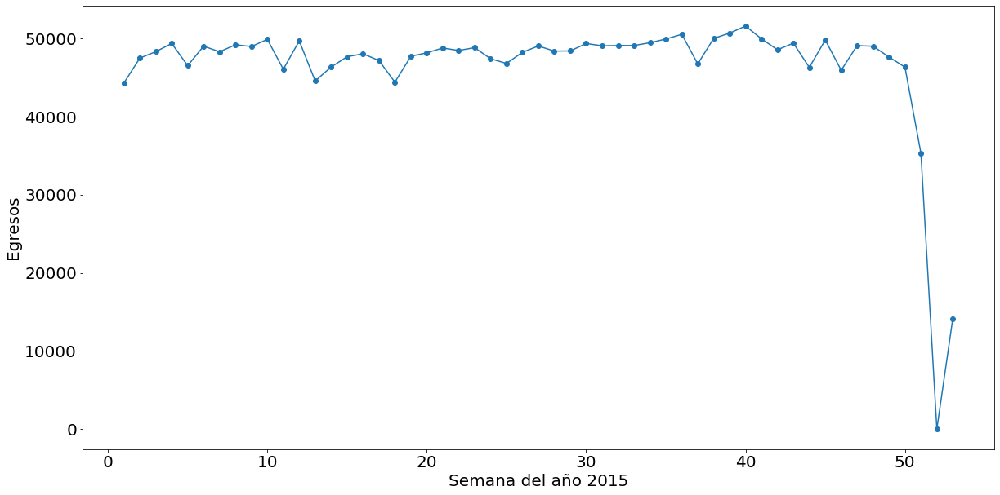

In [137]:
# Se importan las librerias necesarias
import matplotlib.pyplot as plt

año5 = '2015'
print('Egresos ' + año5)
# Se establece el tamaño de la figura
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(20, 10))
# Se define que se unan los puntos en la gráfica
plt.scatter(semanas5.index, newdf5.casos)
# Se definen las coordenadas 'x' y 'y'
plt.plot(semanas5.index, newdf5.casos)
# Se coloca un título para el eje x
plt.xlabel("Semana del año " + año5)
# Se coloca un título para el eje y
plt.ylabel("Egresos")
# Se guarda la figura como un archivo
plt.savefig(año5 + '/Egresos' + año5 + '.jpg', format='jpg')
# Se muestra la figura en la terminal
plt.show()

Año 2015


O809


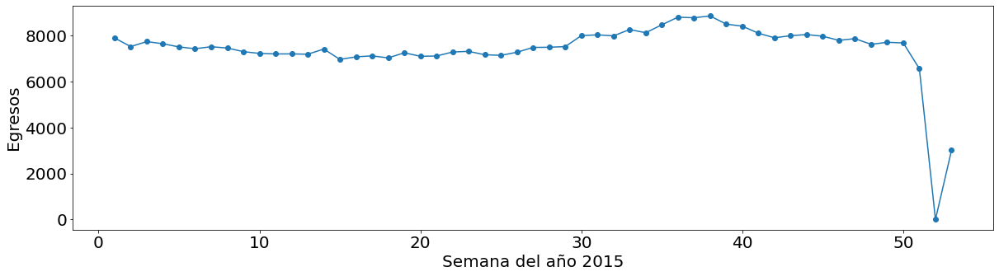


N189


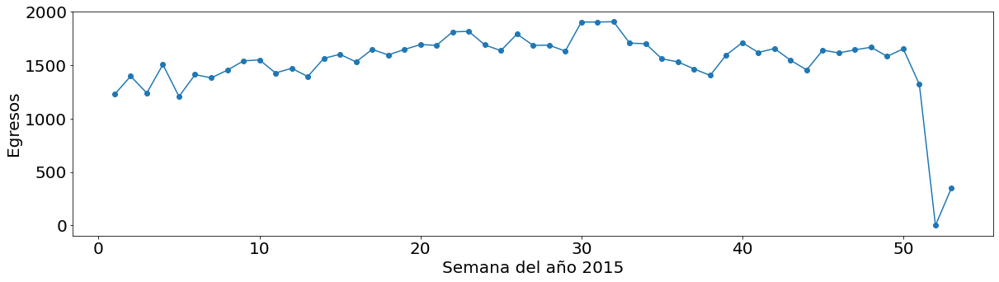


O800


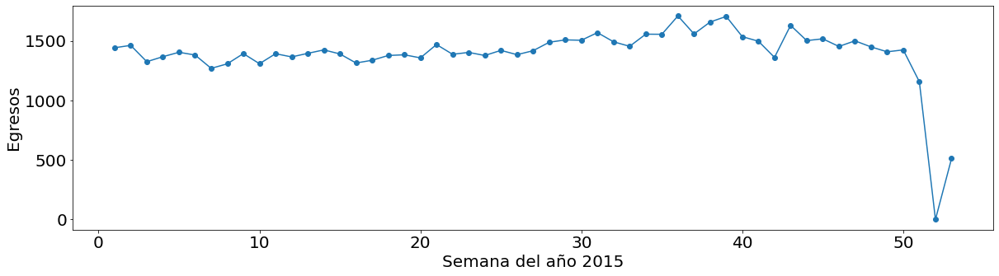


O829


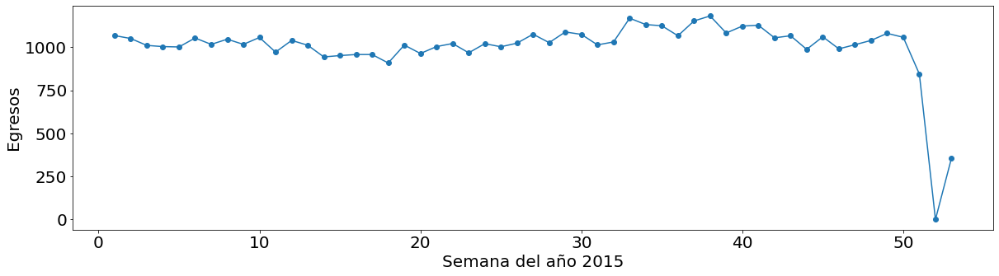


O064


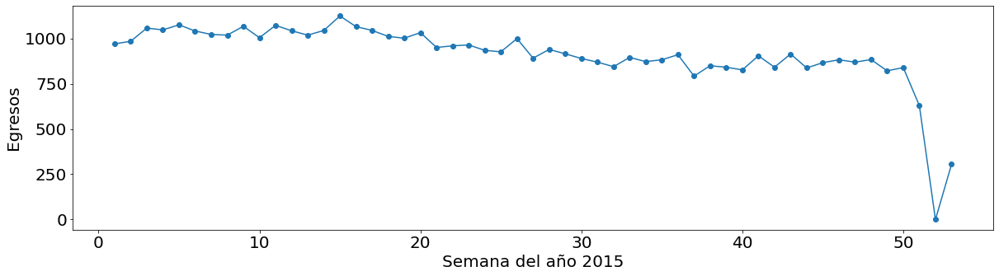


O342


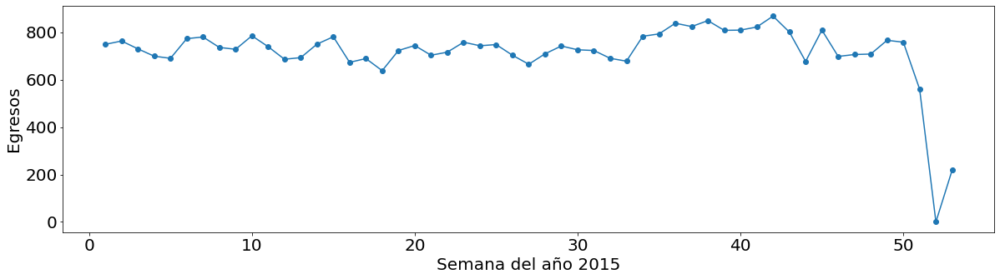


K358


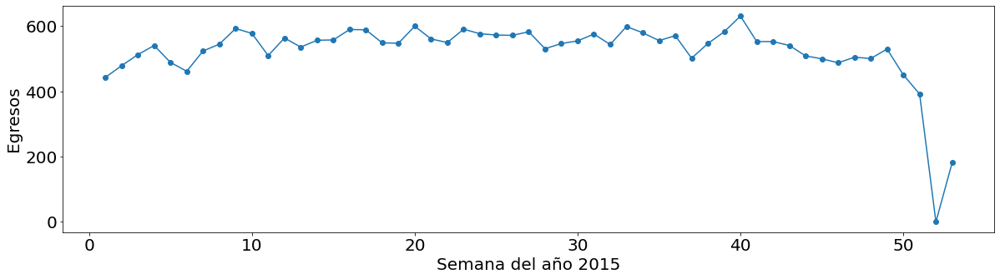


Z491


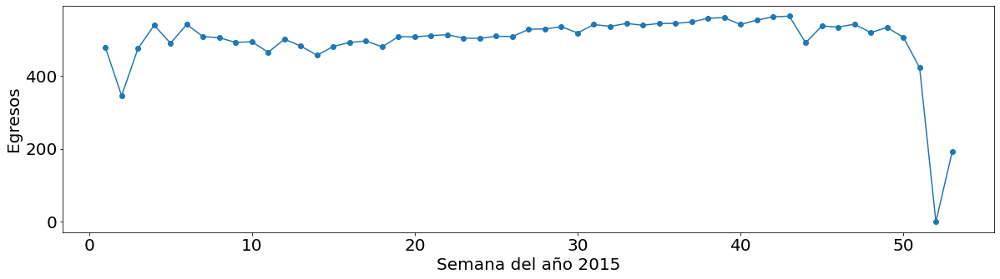


O429


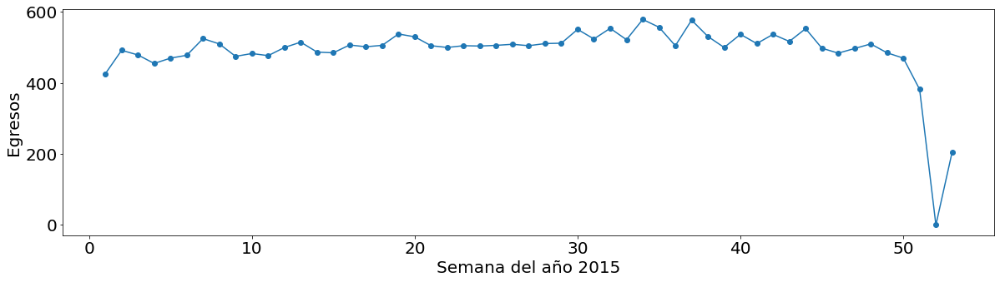


J189


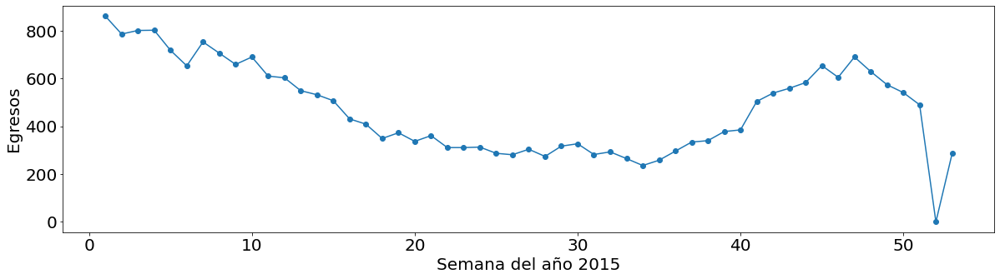


K409


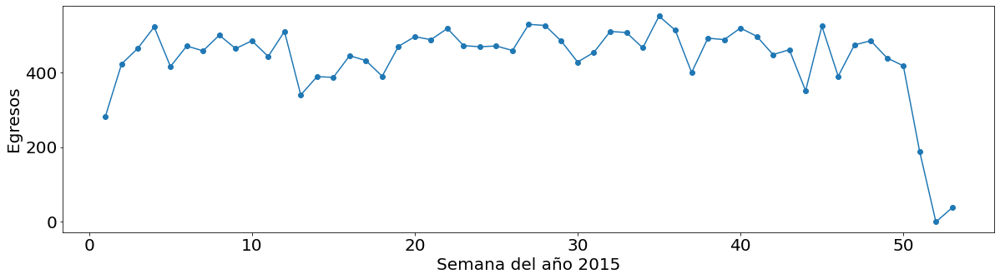


N185


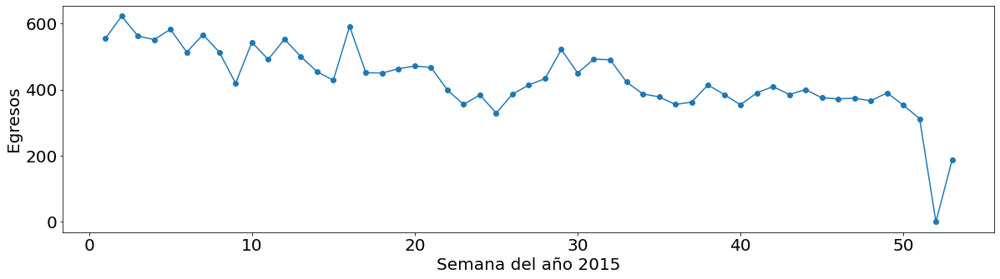


O470


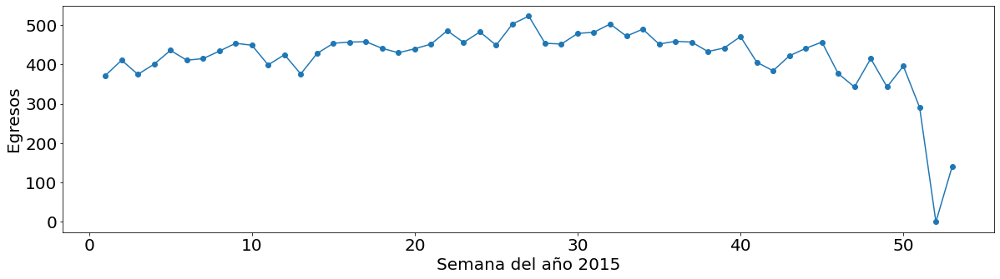


O410


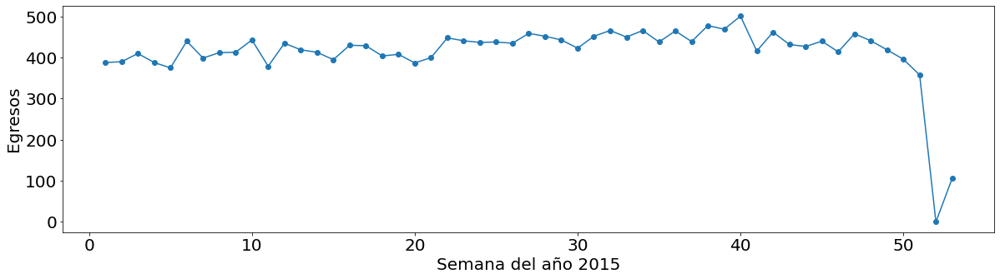


C509


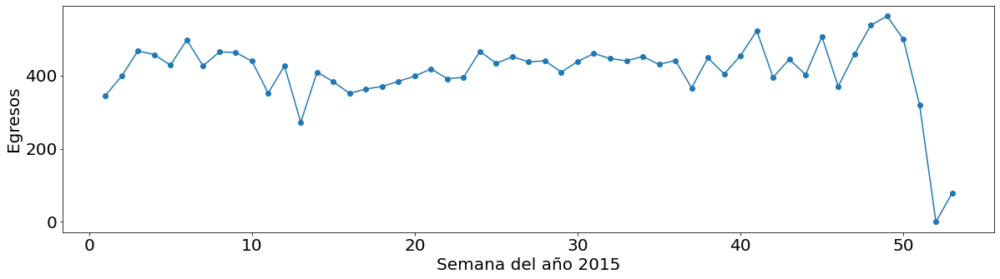


O339


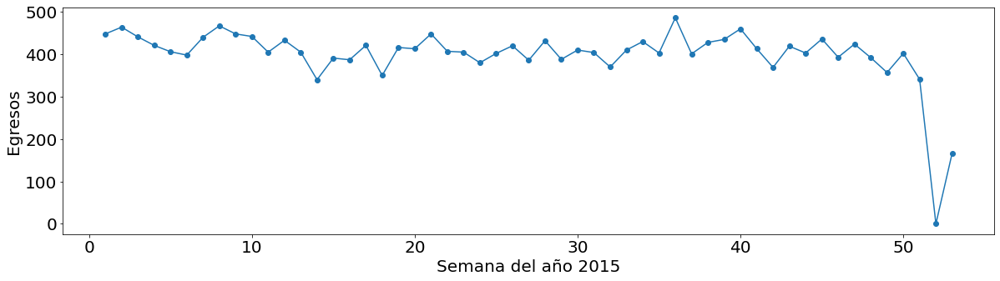


K811


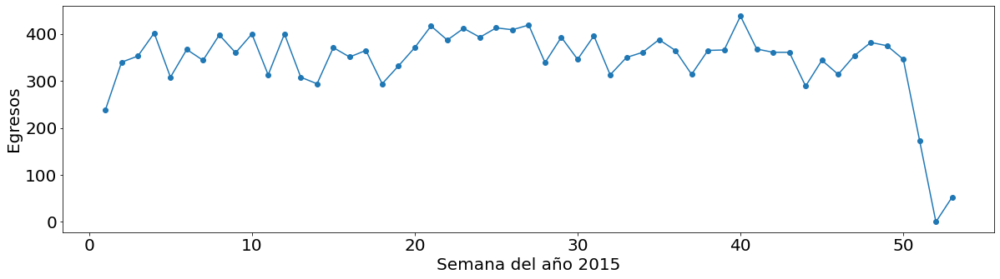


D259


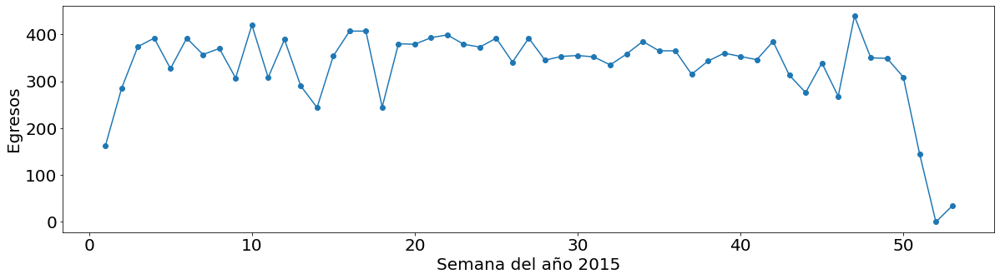


K801


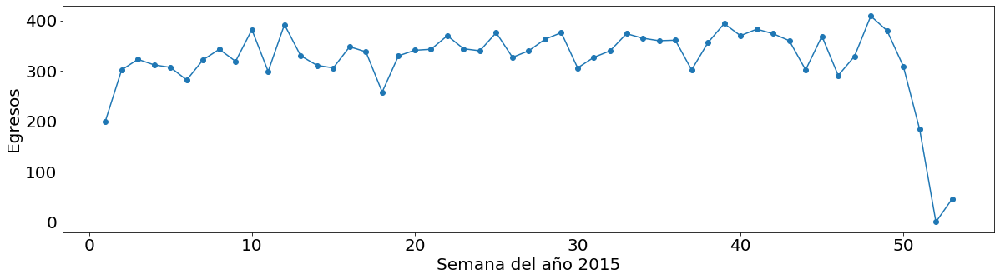


C910


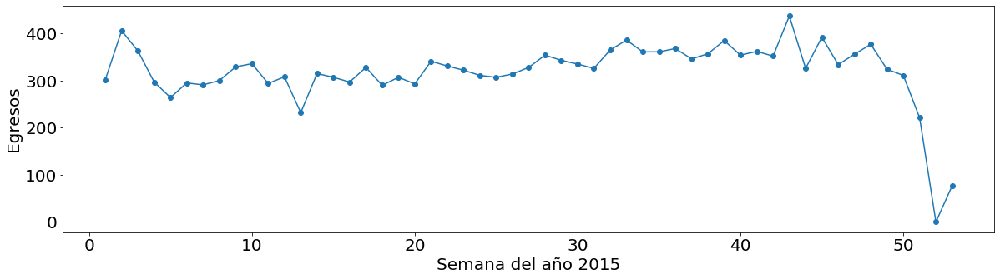


P073


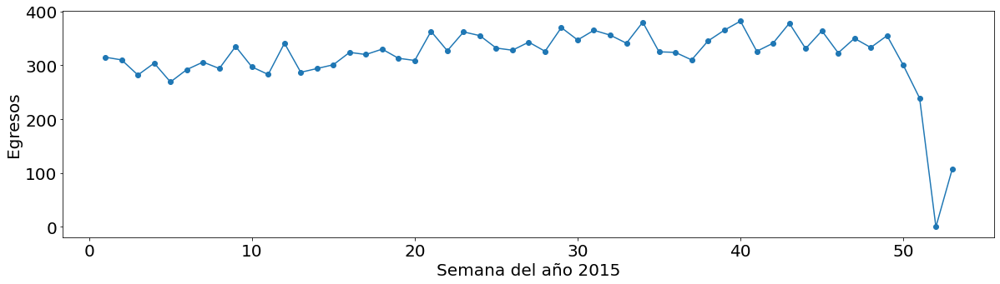


K37X


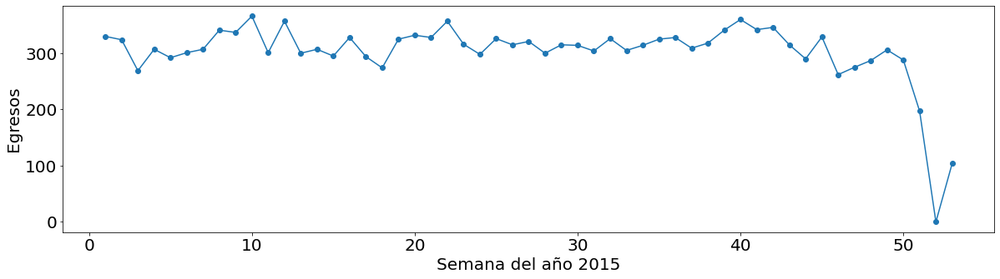


O13X


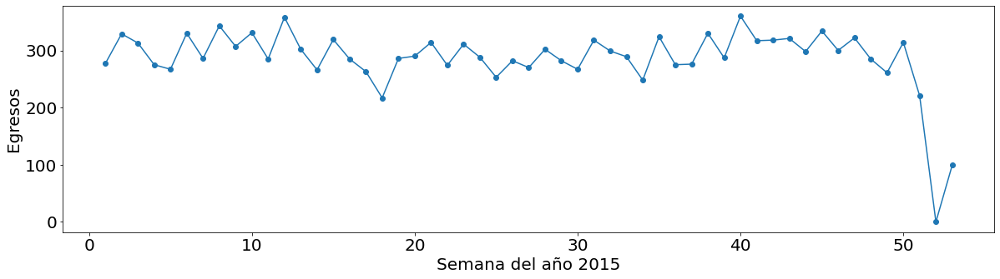


E119


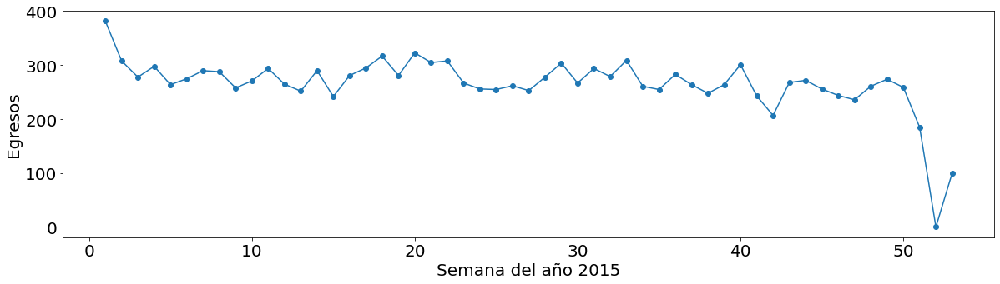


O200


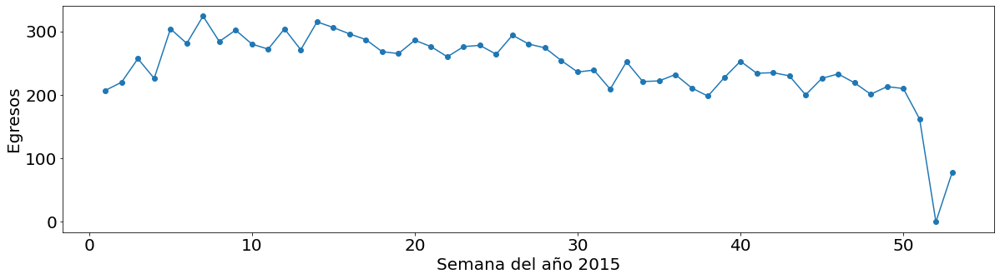


Z910


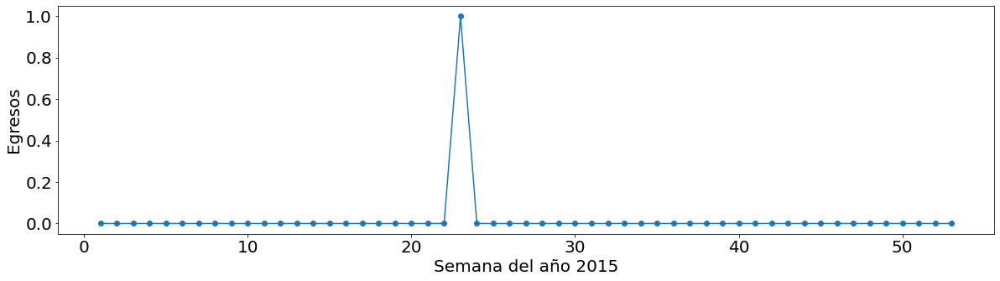


E070


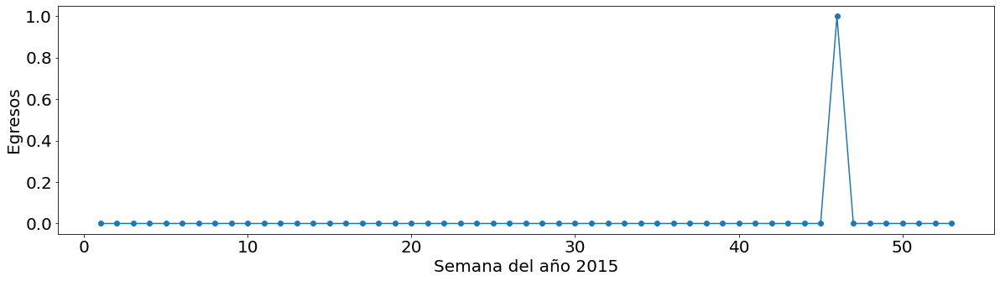


C882


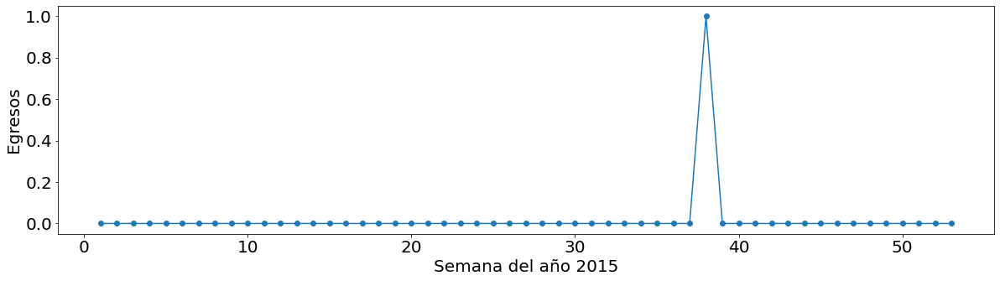


M962


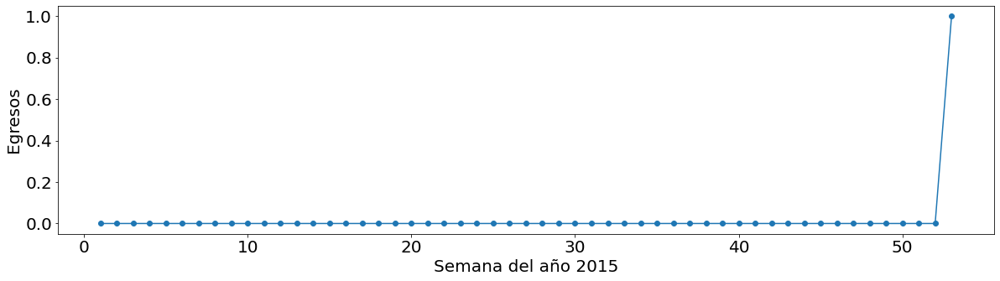


F136


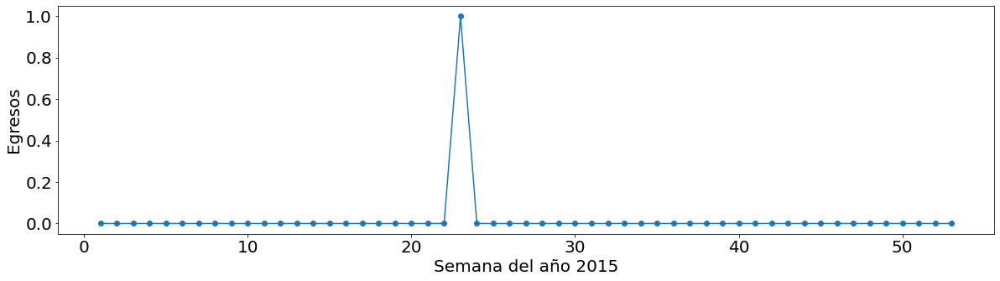

In [138]:
# Se crea el dataframe 'diagnosticos' con los nombre de los diferentes diagnosticos sin repeticion
diagnosticos5 = dataframe5['DIAG_INI'].value_counts()
# Se ordena del diagnostico con mayore numero de egresos al diagnostico con menor numero de egresos
diagnosticos5 = diagnosticos5.sort_values(ascending = False)
# Se crea el dataframe 'cie' con los nombres de los diagnosticos, los numeros de las semanas, y la cantidad de diagnosticos de dicha enfermedad en cada semana
cie5 = dataframe5.groupby(['DIAG_INI', 'sem']).count()

# Se importa la libreria necesaria para la figura
import matplotlib.pyplot as plt

plt.rcParams.update({'font.size': 20})

print('Año ' + año5 + '\n')
# Se inicia un contador para controlar la cantidad de graficos a generar
i5 = 0
ndiagnosticos5 = len(diagnosticos5.index)
maximo5 = ndiagnosticos5-5
# Proceso de generación de las figuras
for name5 in diagnosticos5.index:
    if i5 < 25 or i5 >= maximo5:
        y5 = []
        for index5 in semanas5.index:
            try:
                y5.append(cie5['EGRESO'][name5, index5])
            except:
                y5.append(0)
        print('\n' + name5)
        plt.figure(figsize=(20, 5))
        plt.scatter(semanas5.index, y5)
        plt.plot(semanas5.index, y5)
        plt.xlabel("Semana del año " + año5)
        plt.ylabel("Egresos")
        plt.savefig(año5 + '/' + name5 + '_' + año5 + '.jpg', format='jpg')
        plt.show()
    i5 = i5+1

# 2016

In [9]:
import pandas as pd 

# Se cargan los datos
colums6 = ['EGRESO', 'DIAG_INI']
dataframe6 = pd.read_csv('EGRESO_2016.csv', usecols=colums6).dropna()
dataframe6

,EGRESO,DIAG_INI
0,12/30/2015 00:00,N185
1,12/31/2015 00:00,N185
2,12/31/2015 00:00,N185
3,01/02/2016 00:00,N185
4,01/02/2016 00:00,N185
...,...,...
1048570,08/24/2016 00:00,E115
1048571,08/17/2016 00:00,O809
1048572,08/21/2016 00:00,O809
1048573,08/22/2016 00:00,O809


In [18]:
# Se importan las librerias necesarias
from epiweeks import Week, date

# Se convierten los string a objetos datetime en 'dataframe'
strfdtoriginal6 = '%m/%d/%Y %H:%M'
dataframe6['EGRESO'] = pd.to_datetime(dataframe6['EGRESO'], errors='coerce', format=strfdtoriginal6)
dataframe6 = dataframe6.dropna()
dataframe6 = dataframe6.reset_index(drop=True)

# Se agrega una columna con los numeros de semana
dataframe6['sem'] = ''
nrows6 = len(dataframe6.index)
for i in range(nrows6):
    dfday6 = dataframe6['EGRESO'][i]
    if dfday6.year==2016:
        mydate6 = date(dfday6.year, dfday6.month, dfday6.day)
        numberweek6 = Week.fromdate(mydate6)
        dataframe6['sem'][i] = numberweek6.week
    
dataframe6 = dataframe6.dropna()
dataframe6 = dataframe6.reset_index(drop=True)    
dataframe6

,EGRESO,DIAG_INI,sem
0,2015-12-30,N185,
1,2015-12-31,N185,
2,2015-12-31,N185,
3,2016-01-02,N185,52
4,2016-01-02,N185,52
...,...,...,...
1048569,2016-08-24,E115,34
1048570,2016-08-17,O809,33
1048571,2016-08-21,O809,34
1048572,2016-08-22,O809,34


In [89]:
# Se forma el nuevo dataframe 'semanas' con el numero de semana del año y la cantidad de egresos en cada semana
semanas6 = dataframe6['sem'].value_counts()
semanas6 = semanas6.drop('', axis = 0)
semanas6 = semanas6.sort_index()
semanas6

1     17589
2     19491
3     19832
4     20191
5     19086
6     20157
7     19888
8     20511
9     20626
10    20529
11    20988
12    17365
13    19319
14    20001
15    20455
16    19735
17    20120
18    19200
19    19319
20    19965
21    20731
22    19958
23    20423
24    20138
25    19626
26    19910
27    20014
28    20014
29    20375
30    20131
31    20075
32    20357
33    20336
34    20555
35    20810
36    21251
37    20265
38    21211
39    21159
40    20842
41    20627
42    20497
43    20288
44    18737
45    19961
46    19748
47    18405
48    19142
49    18985
50    18585
51    18338
52    16945
Name: sem, dtype: int64

In [90]:
# Se pasa a un nuevo dataframe
newdf6 = pd.DataFrame()
newdf6['sem'] = semanas6.index 
newdf6['casos'] = ''
nr6 = len(newdf6.index)
for i in range (nr6):
    newdf6['casos'][i] = int(semanas6[i+1])
newdf6

,sem,casos
0,1,17589
1,2,19491
2,3,19832
3,4,20191
4,5,19086
5,6,20157
6,7,19888
7,8,20511
8,9,20626
9,10,20529


Egresos 2016


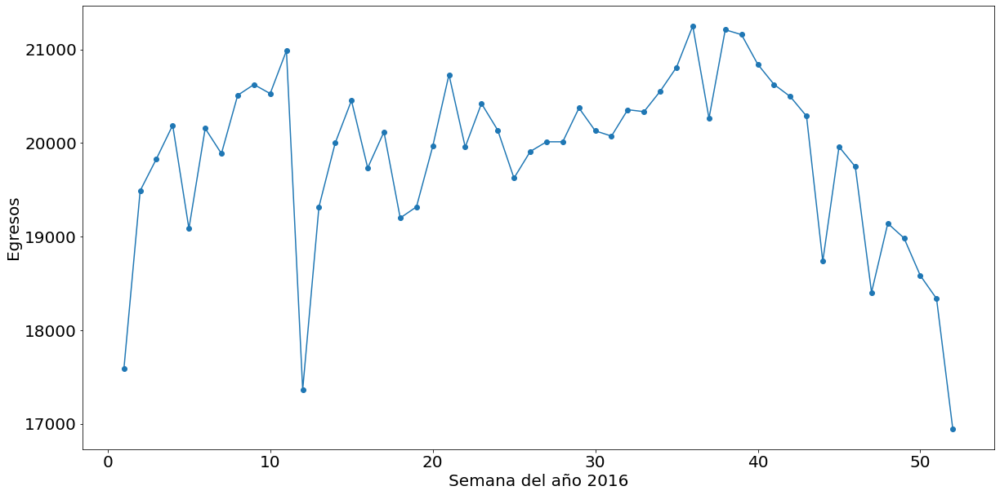

In [139]:
# Se importan las librerias necesarias
import matplotlib.pyplot as plt

año6 = '2016'
print('Egresos ' + año6)
# Se establece el tamaño de la figura
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(20, 10))
# Se define que se unan los puntos en la gráfica
plt.scatter(semanas6.index, newdf6.casos)
# Se definen las coordenadas 'x' y 'y'
plt.plot(semanas6.index, newdf6.casos)
# Se coloca un título para el eje x
plt.xlabel("Semana del año " + año6)
# Se coloca un título para el eje y
plt.ylabel("Egresos")
# Se guarda la figura como un archivo
plt.savefig(año6 + '/Egresos' + año6 + '.jpg', format='jpg')
# Se muestra la figura en la terminal
plt.show()

Año 2016


O809


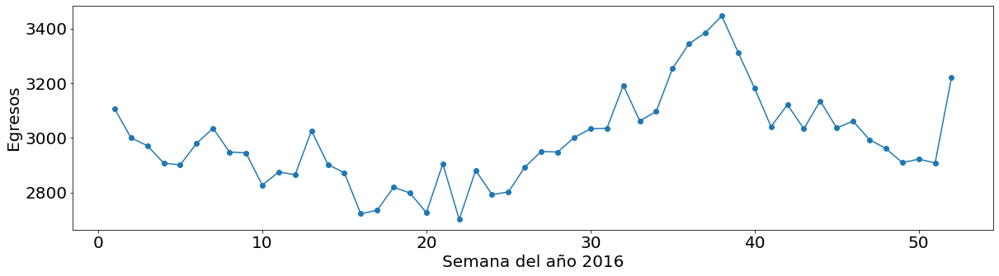


O800


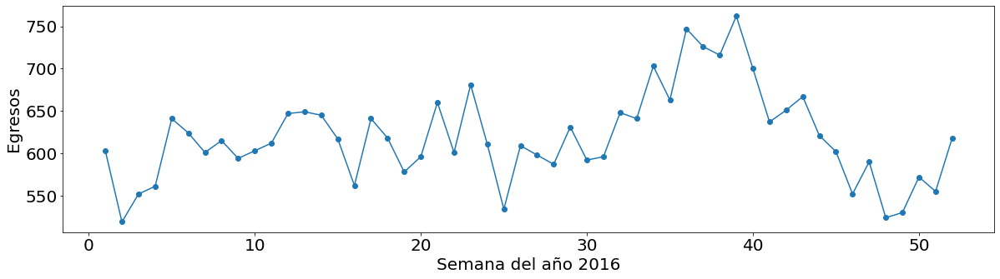


O829


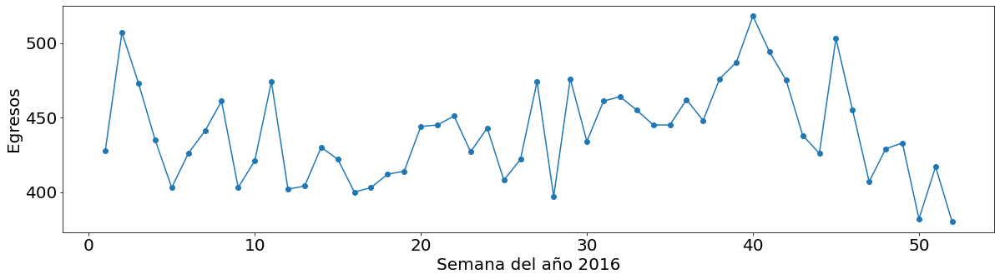


O064


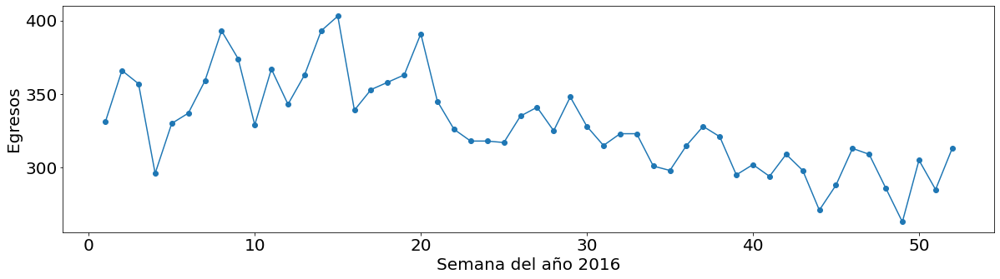


N189


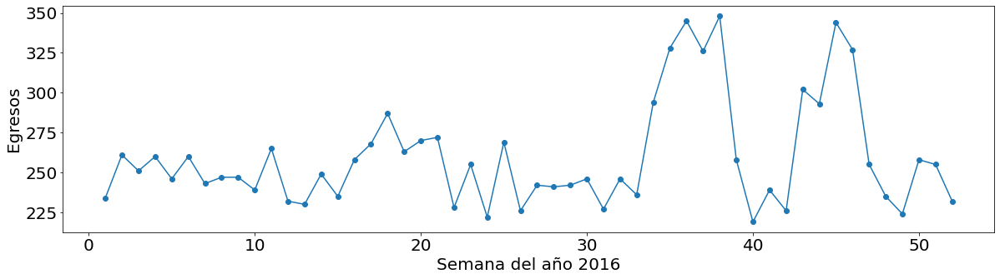


O342


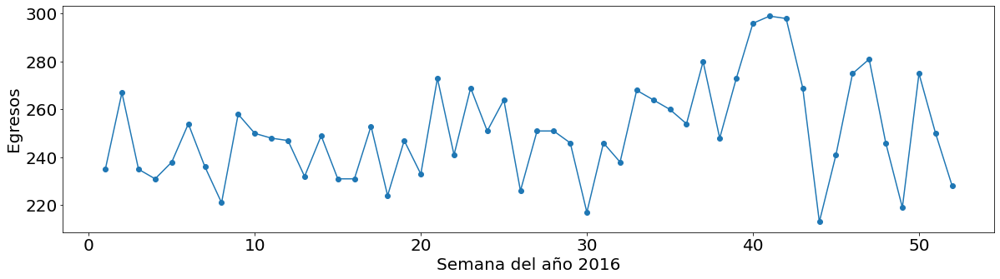


K358


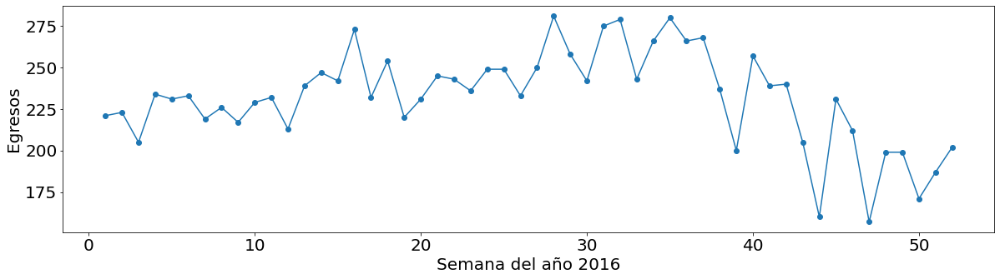


J189


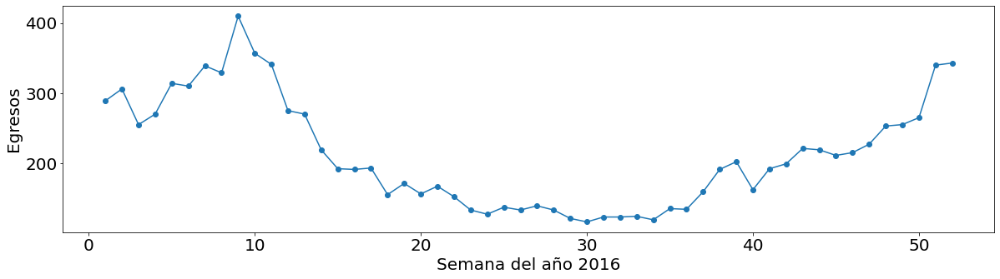


O429


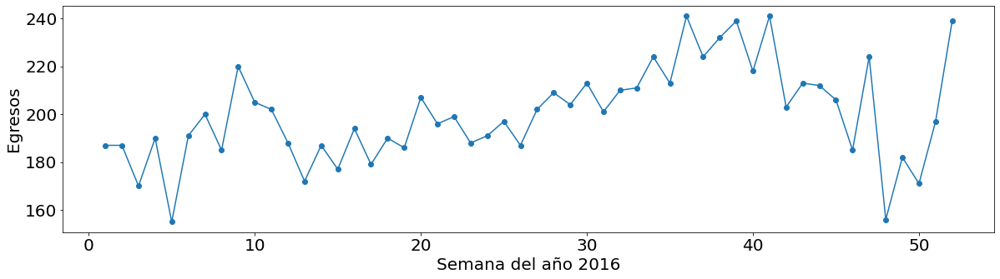


C910


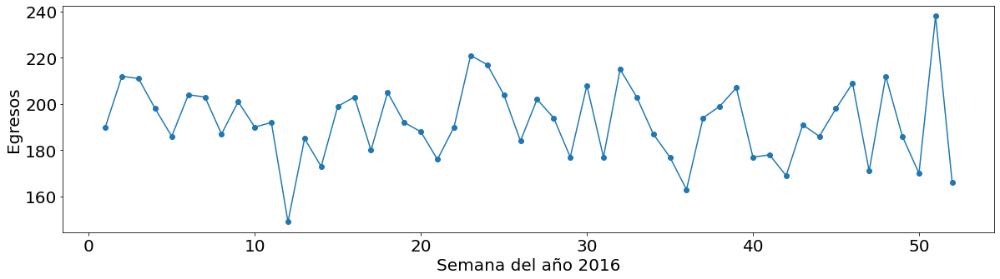


O410


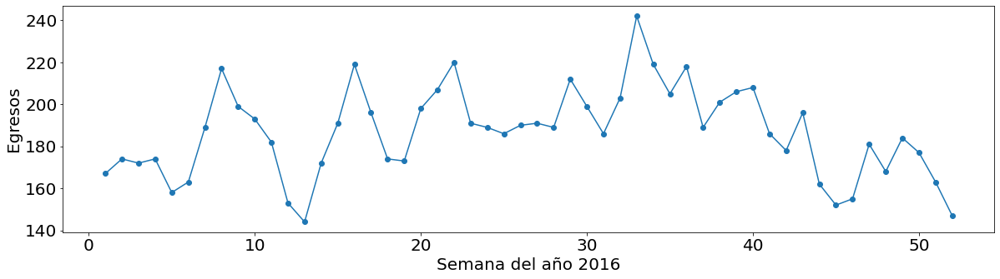


K409


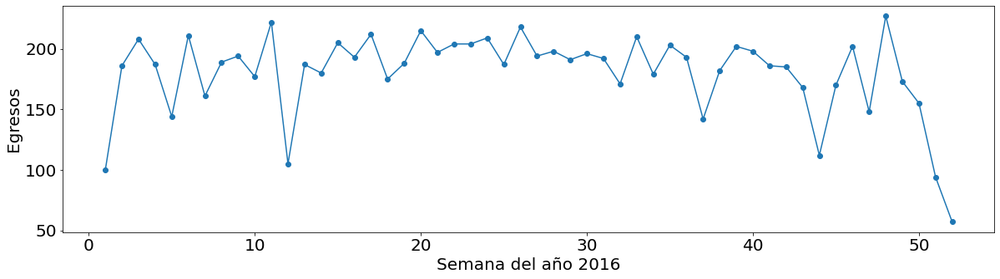


O470


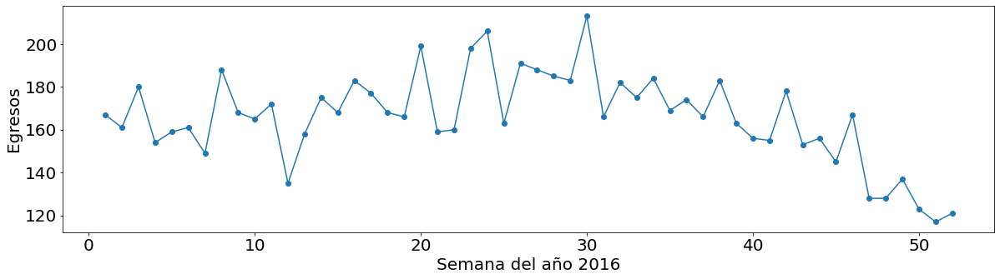


K801


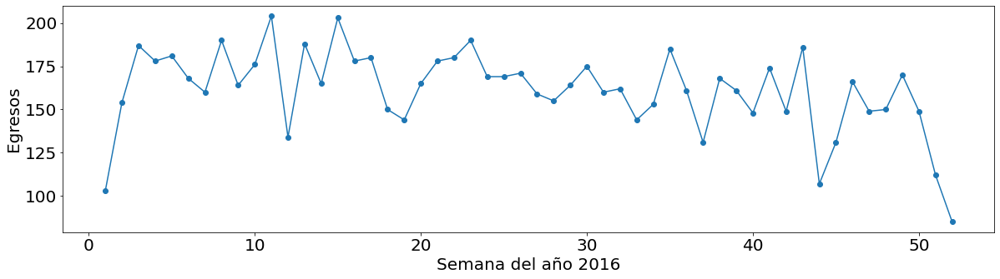


O339


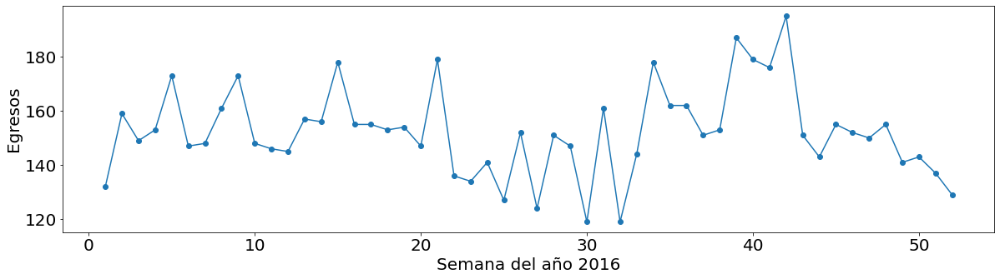


N185


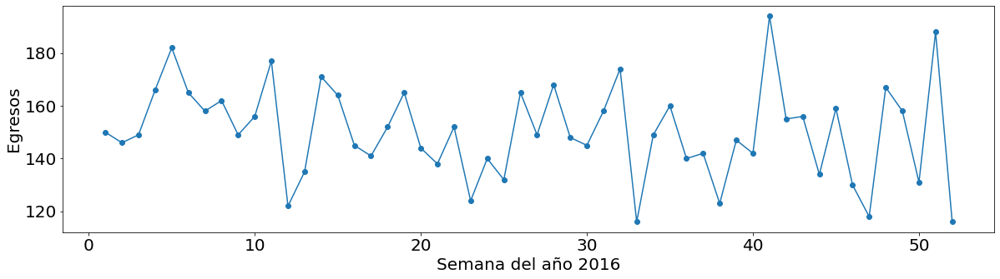


P073


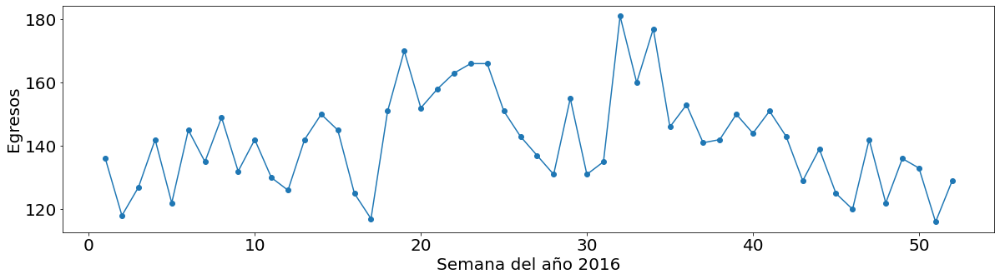


D259


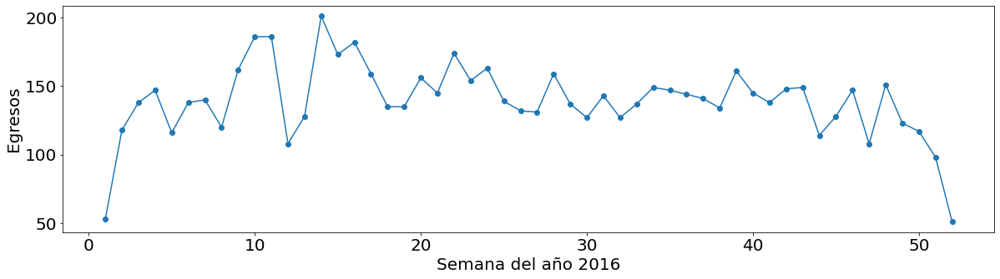


K37X


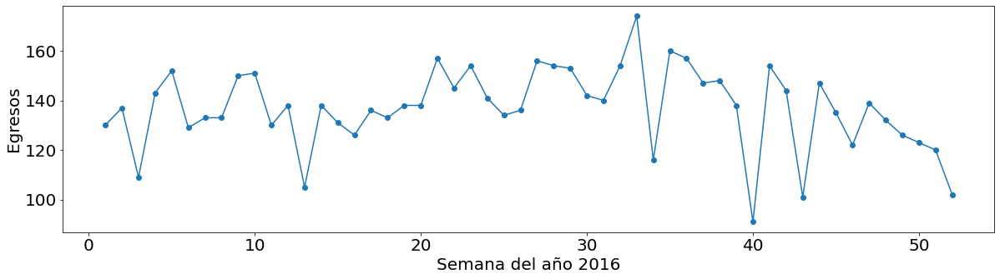


K811


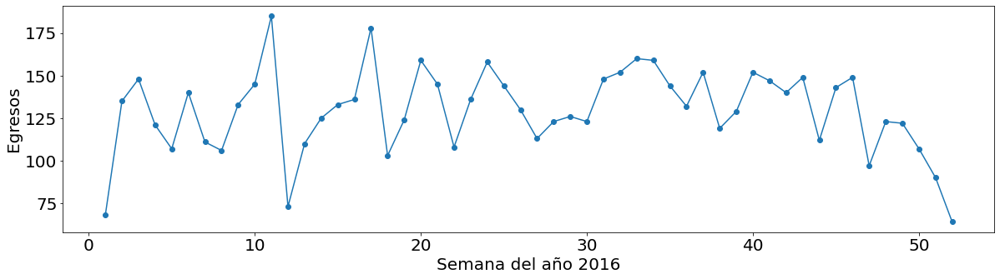


O021


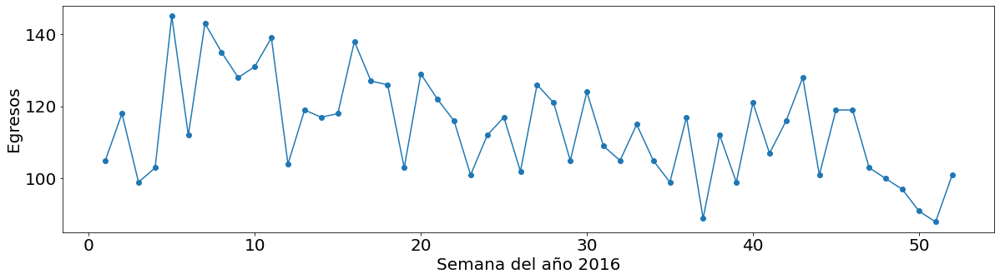


O13X


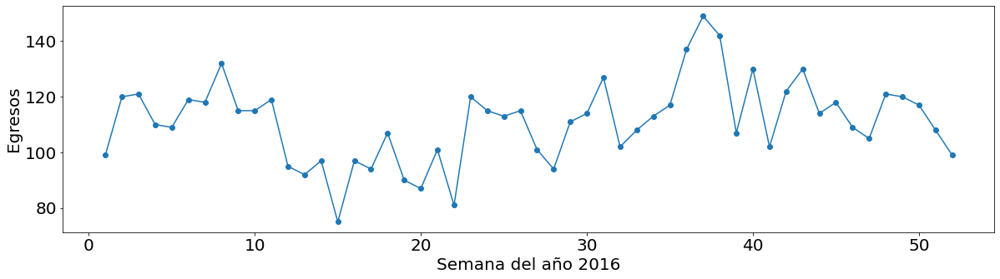


C509


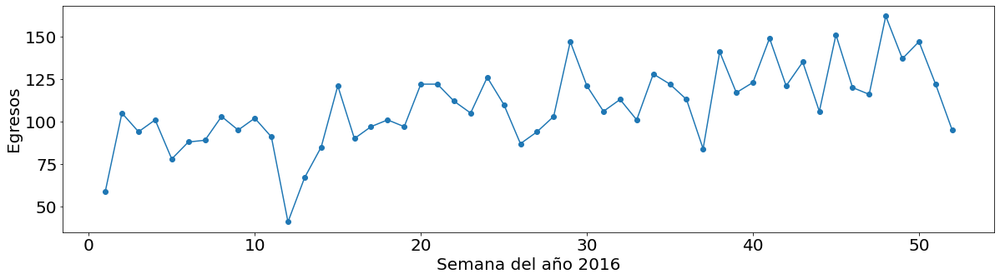


S069


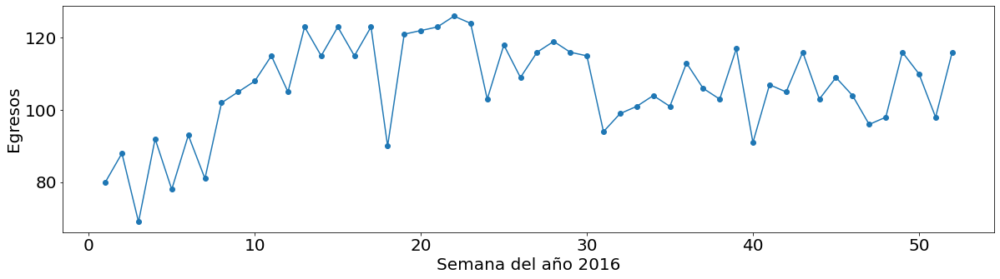


A099


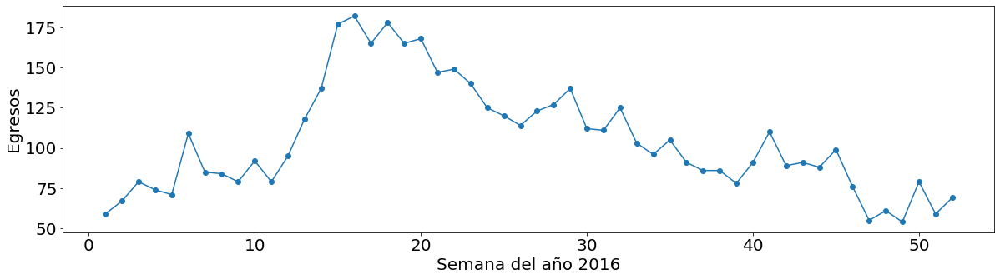


A929


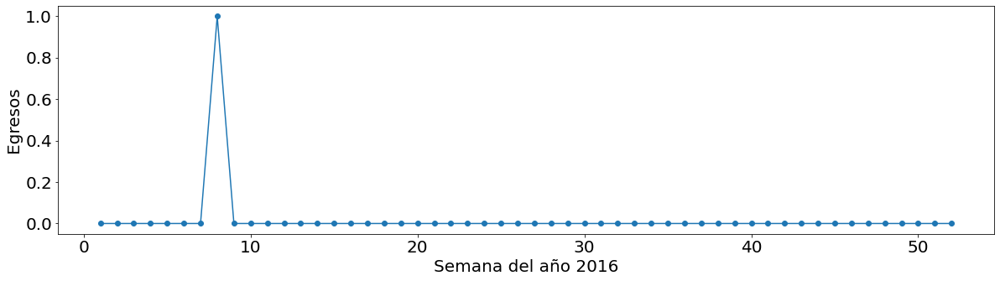


K834


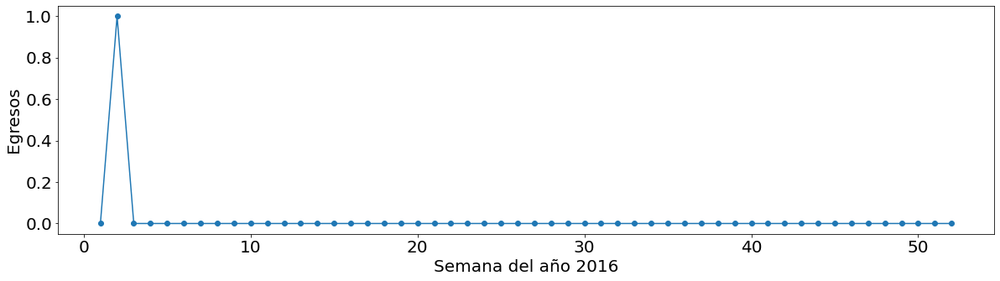


G371


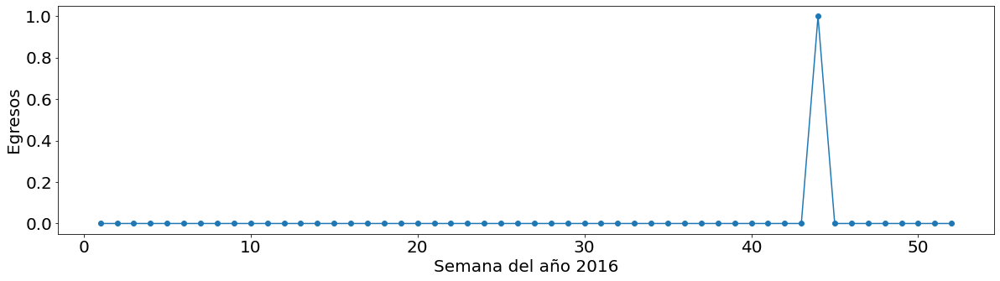


B217


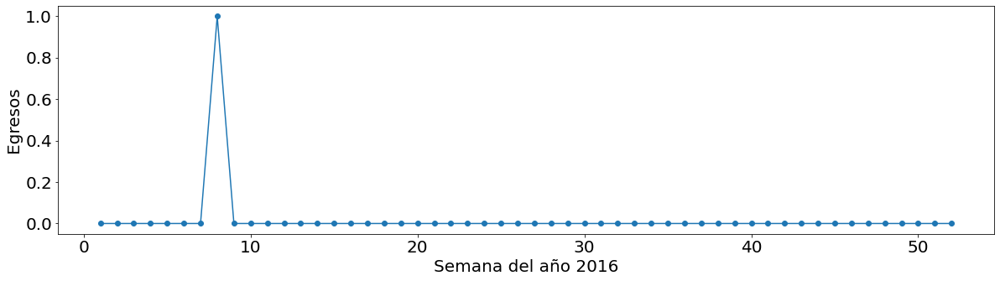


H938


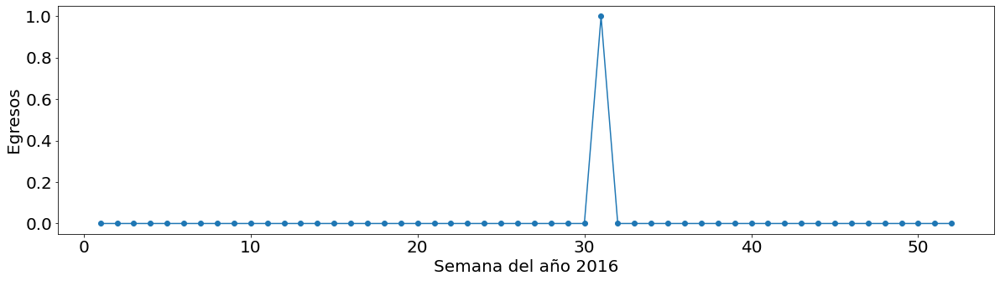

In [140]:
# Se crea el dataframe 'diagnosticos' con los nombre de los diferentes diagnosticos sin repeticion
diagnosticos6 = dataframe6['DIAG_INI'].value_counts()
# Se ordena del diagnostico con mayore numero de egresos al diagnostico con menor numero de egresos
diagnosticos6 = diagnosticos6.sort_values(ascending = False)
# Se crea el dataframe 'cie' con los nombres de los diagnosticos, los numeros de las semanas, y la cantidad de diagnosticos de dicha enfermedad en cada semana
cie6 = dataframe6.groupby(['DIAG_INI', 'sem']).count()

# Se importa la libreria necesaria para la figura
import matplotlib.pyplot as plt

plt.rcParams.update({'font.size': 20})

print('Año ' + año6 + '\n')
# Se inicia un contador para controlar la cantidad de graficos a generar
i6 = 0
ndiagnosticos6 = len(diagnosticos6.index)
maximo6 = ndiagnosticos6-5
# Proceso de generación de las figuras
for name6 in diagnosticos6.index:
    if i6 < 25 or i6 >= maximo6:
        y6 = []
        for index6 in semanas6.index:
            try:
                y6.append(cie6['EGRESO'][name6, index6])
            except:
                y6.append(0)
        print('\n' + name6)
        plt.figure(figsize=(20, 5))
        plt.scatter(semanas6.index, y6)
        plt.plot(semanas6.index, y6)
        plt.xlabel("Semana del año " + año6)
        plt.ylabel("Egresos")
        plt.savefig(año6 + '/' + name6 + '_' + año6 + '.jpg', format='jpg')
        plt.show()
    i6 = i6+1

# 2017

In [10]:
import pandas as pd 

# Se cargan los datos
colums7 = ['EGRESO', 'DIAG_INI']
dataframe7 = pd.read_csv('EGRESO_2017.csv', sep='|', usecols=colums7, nrows=1500000).dropna()
dataframe7

,EGRESO,DIAG_INI
0,2017-02-13 00:00:00,O809
1,2017-03-12 00:00:00,O809
2,2017-04-12 00:00:00,E86X
3,2017-05-13 00:00:00,O809
4,2017-06-14 00:00:00,I219
...,...,...
1499995,2017-08-04 00:00:00,O809
1499996,2017-08-04 00:00:00,O809
1499997,2017-08-04 00:00:00,O064
1499998,2017-08-04 00:00:00,O064


In [19]:
# Se importan las librerias necesarias
from epiweeks import Week, date

# Se convierten los string a objetos datetime en 'dataframe'
strfdtoriginal7 = '%Y-%m-%d %H:%M:%S'
dataframe7['EGRESO'] = pd.to_datetime(dataframe7['EGRESO'], errors='coerce', format=strfdtoriginal7)
dataframe7 = dataframe7.dropna()
dataframe7 = dataframe7.reset_index(drop=True)

# Se agrega una columna con los numeros de semana
dataframe7['sem'] = ''
nrows7 = len(dataframe7.index)
for i in range(nrows7):
    dfday7 = dataframe7['EGRESO'][i]
    if dfday7.year==2017:
        mydate7 = date(dfday7.year, dfday7.month, dfday7.day)
        numberweek7 = Week.fromdate(mydate7)
        dataframe7['sem'][i] = numberweek7.week
    
dataframe7 = dataframe7.dropna()
dataframe7 = dataframe7.reset_index(drop=True)    
dataframe7

,EGRESO,DIAG_INI,sem
0,2017-02-13,O809,7
1,2017-03-12,O809,11
2,2017-04-12,E86X,15
3,2017-05-13,O809,19
4,2017-06-14,I219,24
...,...,...,...
1499995,2017-08-04,O809,31
1499996,2017-08-04,O809,31
1499997,2017-08-04,O064,31
1499998,2017-08-04,O064,31


In [94]:
# Se forma el nuevo dataframe 'semanas' con el numero de semana del año y la cantidad de egresos en cada semana
semanas7 = dataframe7['sem'].value_counts()
# semanas7 = semanas7.drop('', axis = 0)
semanas7 = semanas7.sort_index()
semanas7

1     29887
2     30924
3     32383
4     32156
5     32001
6     30230
7     32552
8     31518
9     31718
10    32476
11    31829
12    29294
13    29940
14    28557
15    26151
16    26885
17    27700
18    24600
19    26186
20    27410
21    27306
22    26797
23    27708
24    28105
25    27789
26    27284
27    27648
28    27696
29    27579
30    26725
31    27417
32    28836
33    28370
34    28507
35    29005
36    29782
37    30581
38    30630
39    29696
40    30454
41    30531
42    30724
43    30116
44    28700
45    30153
46    30218
47    26720
48    28416
49    28652
50    27196
51    25701
52    20561
Name: sem, dtype: int64

In [95]:
# Se pasa a un nuevo dataframe
newdf7 = pd.DataFrame()
newdf7['sem'] = semanas7.index 
newdf7['casos'] = ''
nr7 = len(newdf7.index)
for i in range (nr7):
    newdf7['casos'][i] = int(semanas7[i+1])
newdf7

,sem,casos
0,1,29887
1,2,30924
2,3,32383
3,4,32156
4,5,32001
5,6,30230
6,7,32552
7,8,31518
8,9,31718
9,10,32476


Egresos 2017


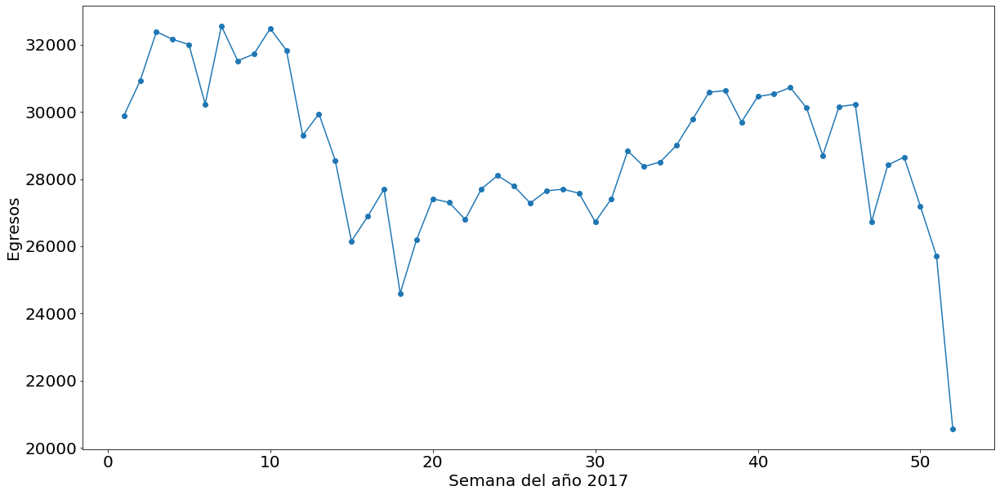

In [141]:
# Se importan las librerias necesarias
import matplotlib.pyplot as plt

año7 = '2017'
print('Egresos ' + año7)
# Se establece el tamaño de la figura
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(20, 10))
# Se define que se unan los puntos en la gráfica
plt.scatter(semanas7.index, newdf7.casos)
# Se definen las coordenadas 'x' y 'y'
plt.plot(semanas7.index, newdf7.casos)
# Se coloca un título para el eje x
plt.xlabel("Semana del año " + año7)
# Se coloca un título para el eje y
plt.ylabel("Egresos")
# Se guarda la figura como un archivo
plt.savefig(año7 + '/Egresos' + año7 + '.jpg', format='jpg')
# Se muestra la figura en la terminal
plt.show()

Año 2017


O809


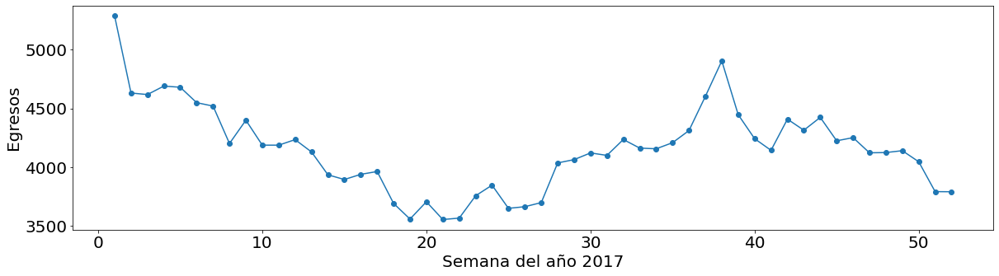


N189


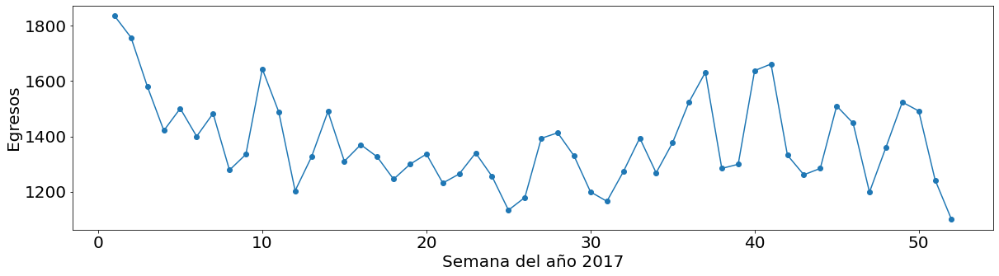


O800


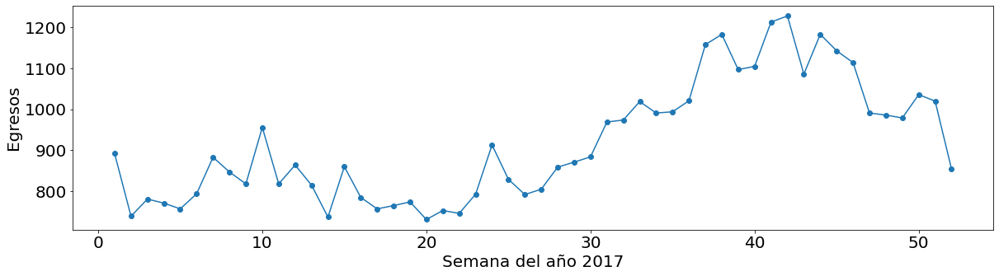


O829


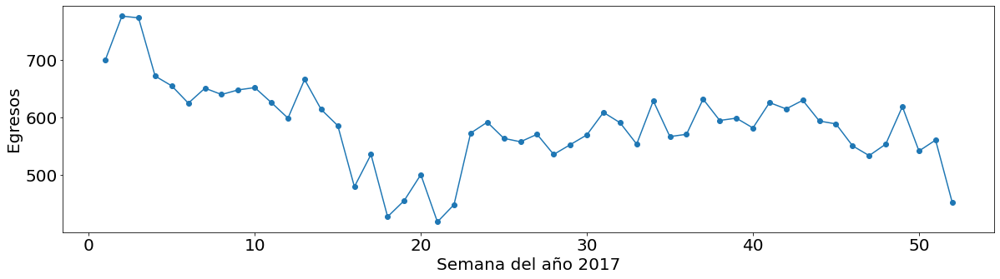


O064


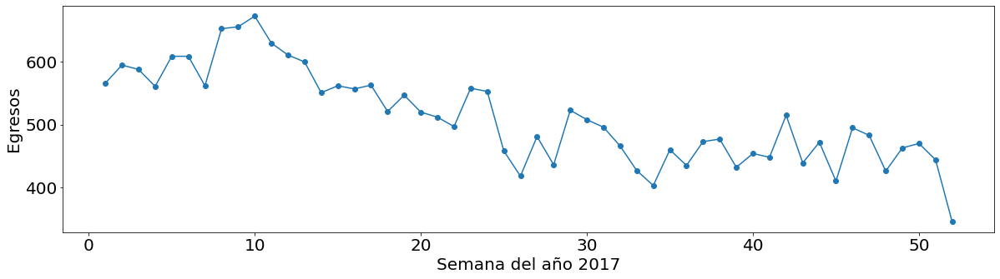


N185


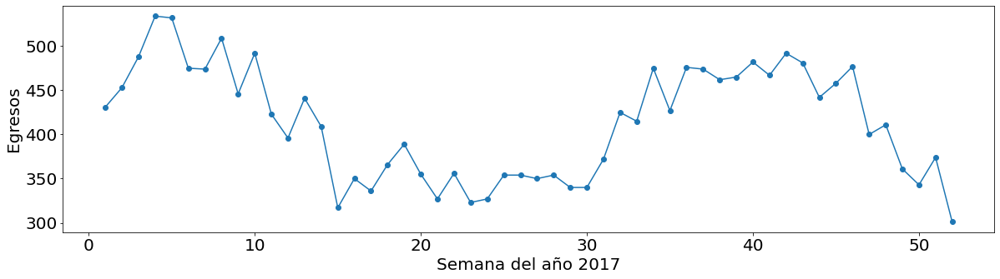


C509


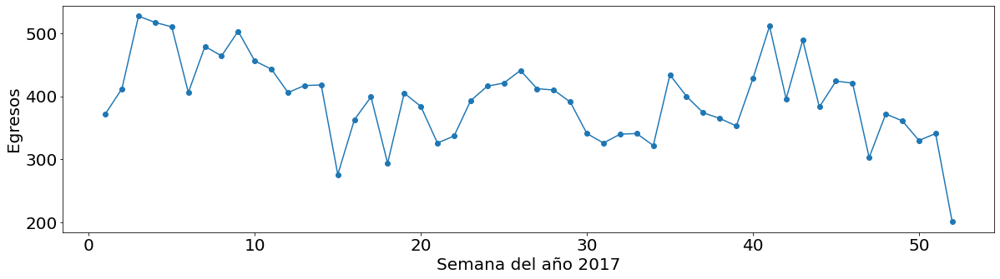


O342


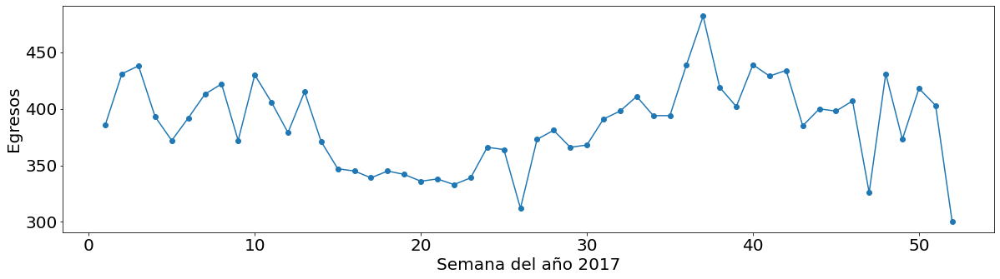


O429


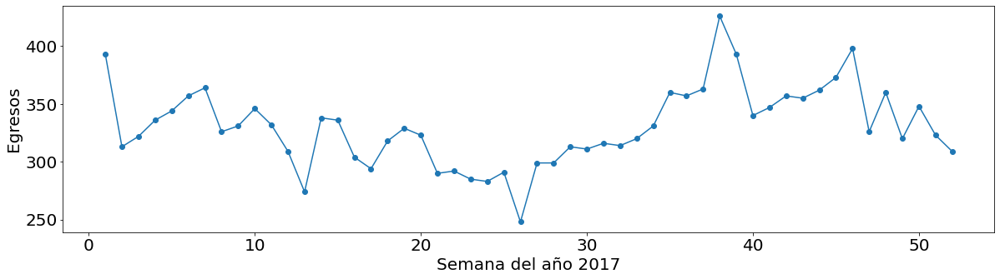


K358


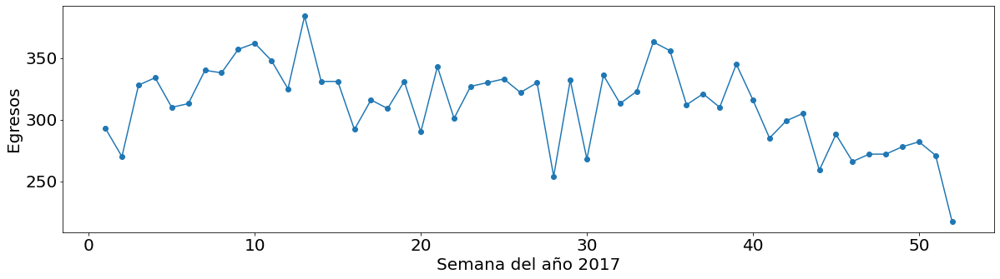


J189


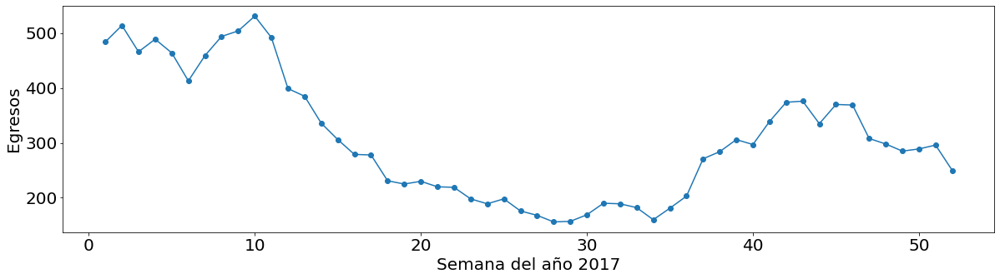


C910


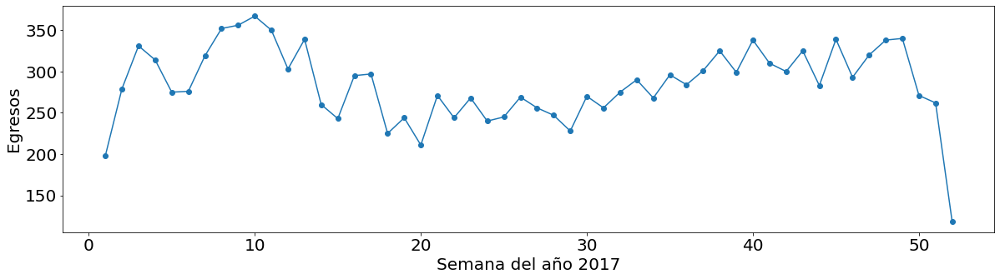


K409


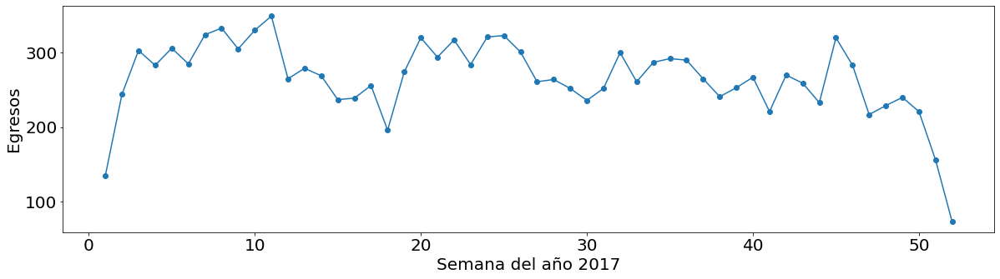


O410


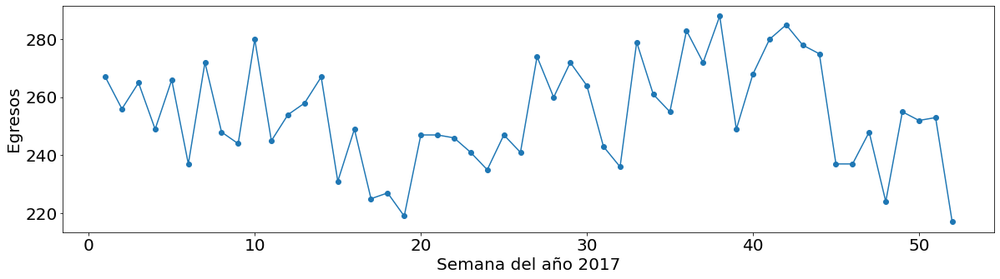


Z491


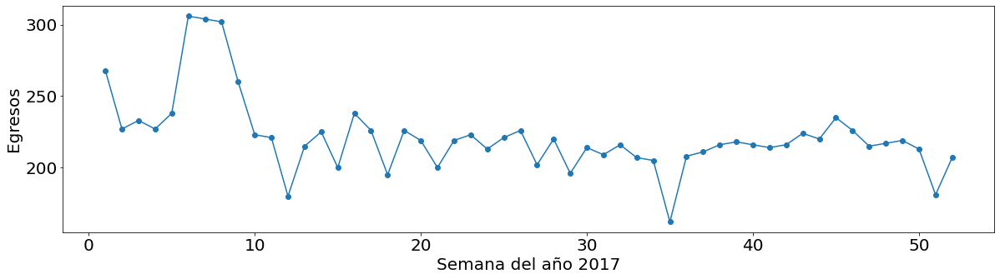


O339


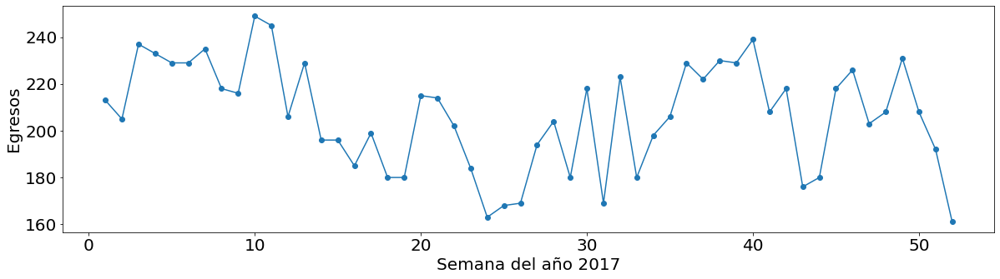


O470


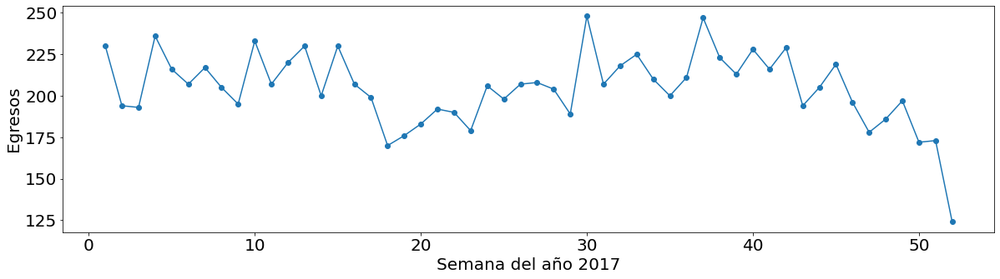


P073


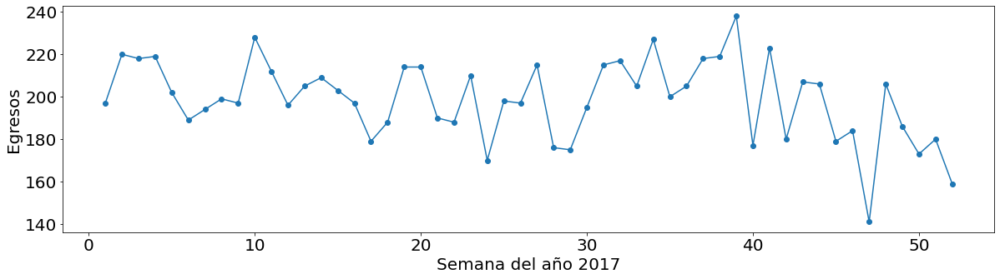


K811


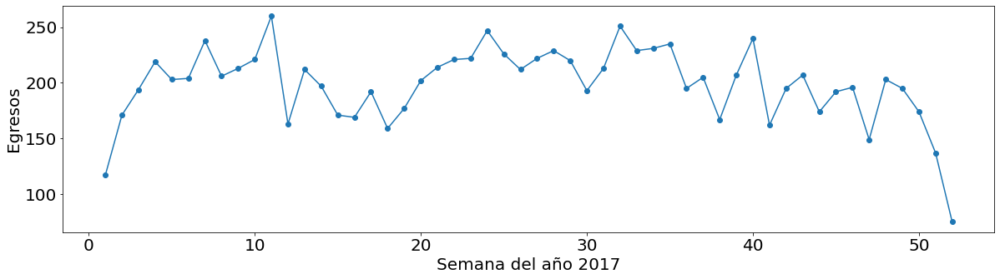


D259


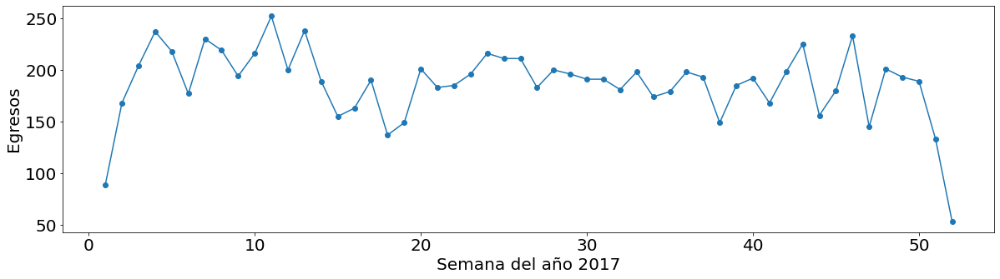


O13X


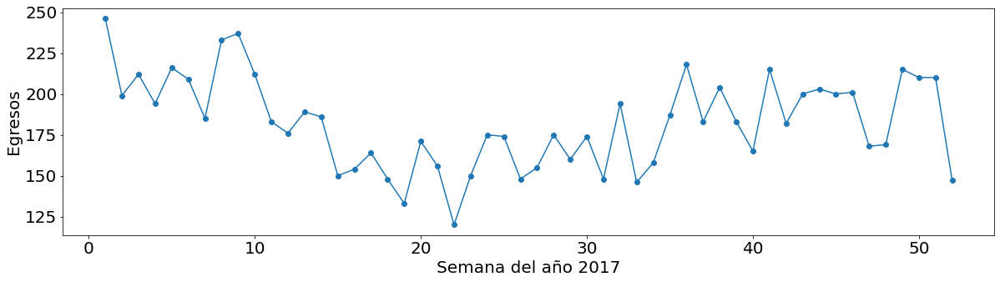


K37X


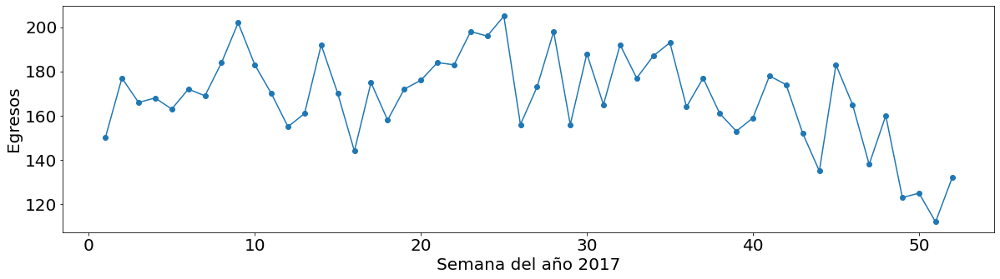


Z992


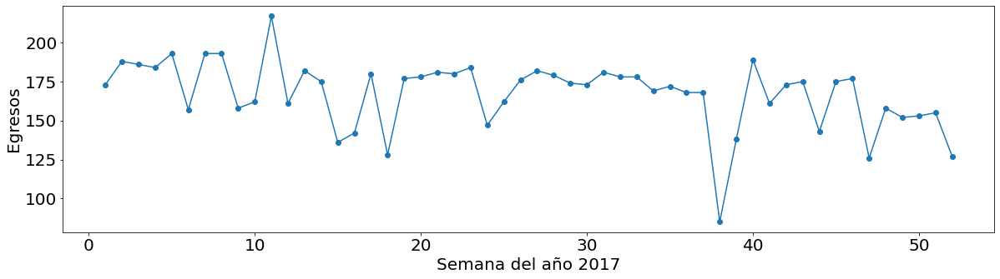


K801


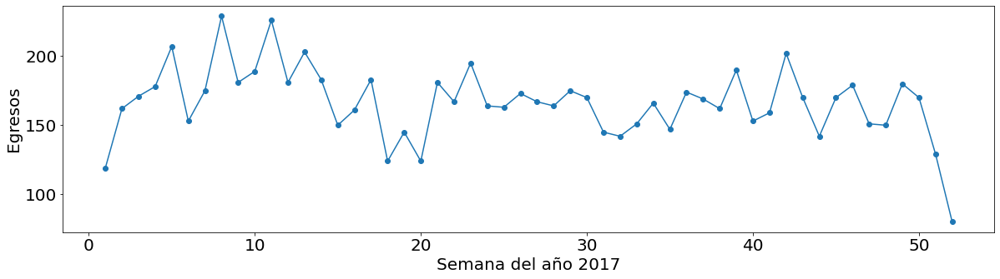


K802


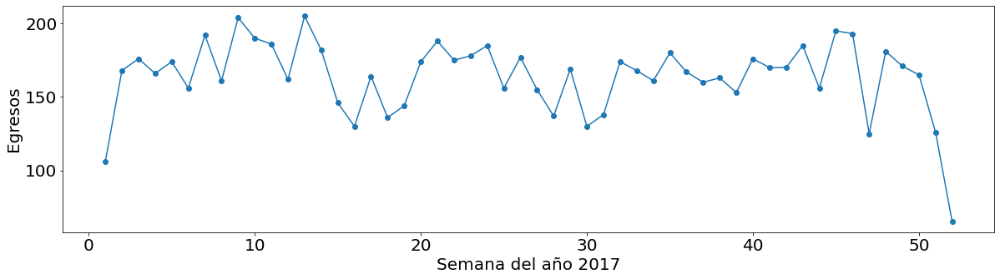


F88X


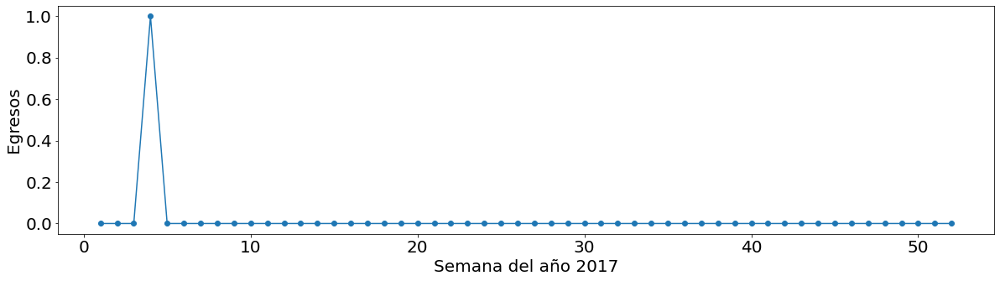


T236


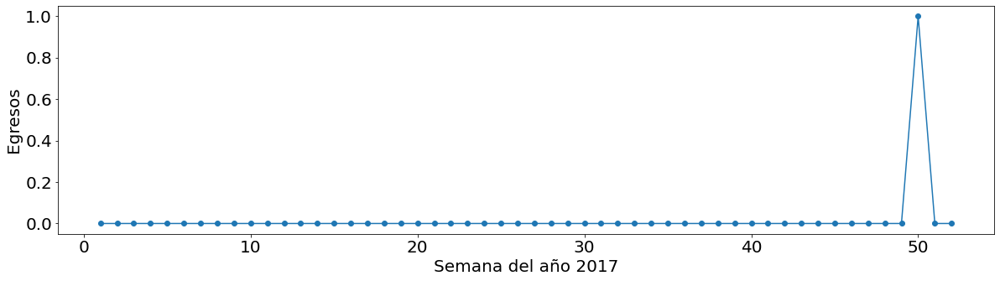


D590


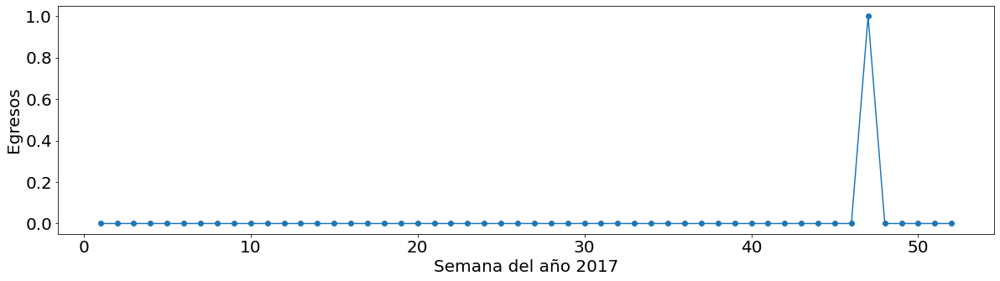


p369


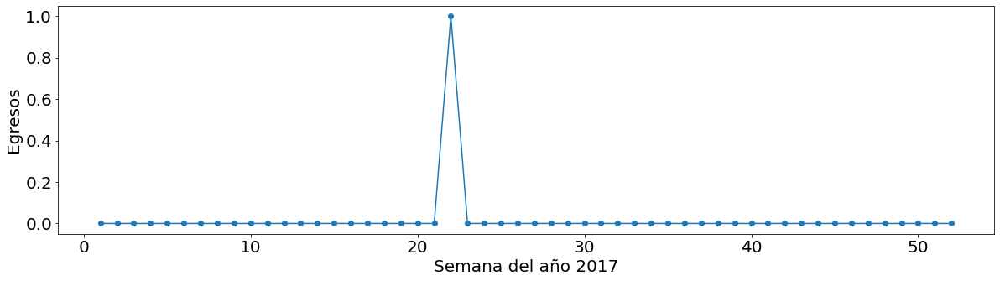


Z749


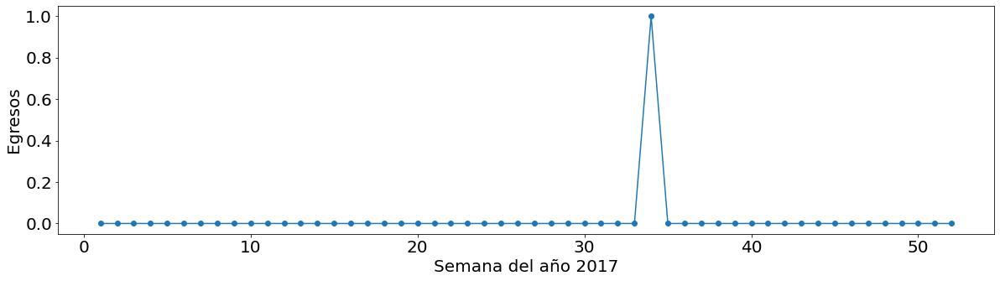

In [142]:
# Se crea el dataframe 'diagnosticos' con los nombre de los diferentes diagnosticos sin repeticion
diagnosticos7 = dataframe7['DIAG_INI'].value_counts()
# Se ordena del diagnostico con mayore numero de egresos al diagnostico con menor numero de egresos
diagnosticos7 = diagnosticos7.sort_values(ascending = False)
# Se crea el dataframe 'cie' con los nombres de los diagnosticos, los numeros de las semanas, y la cantidad de diagnosticos de dicha enfermedad en cada semana
cie7 = dataframe7.groupby(['DIAG_INI', 'sem']).count()

# Se importa la libreria necesaria para la figura
import matplotlib.pyplot as plt

plt.rcParams.update({'font.size': 20})

print('Año ' + año7 + '\n')
# Se inicia un contador para controlar la cantidad de graficos a generar
i7 = 0
ndiagnosticos7 = len(diagnosticos7.index)
maximo7 = ndiagnosticos7-5
# Proceso de generación de las figuras
for name7 in diagnosticos7.index:
    if i7 < 25 or i7 >= maximo7:
        y7 = []
        for index7 in semanas7.index:
            try:
                y7.append(cie7['EGRESO'][name7, index7])
            except:
                y7.append(0)
        print('\n' + name7)
        plt.figure(figsize=(20, 5))
        plt.scatter(semanas7.index, y7)
        plt.plot(semanas7.index, y7)
        plt.xlabel("Semana del año " + año7)
        plt.ylabel("Egresos")
        plt.savefig(año7 + '/' + name7 + '_' + año7 + '.jpg', format='jpg')
        plt.show()
    i7 = i7+1

# 2018

In [11]:
import pandas as pd 

# Se cargan los datos
colums8 = ['EGRESO', 'DIAG_INI']
dataframe8 = pd.read_csv('EGRESO_2018.csv', usecols=colums8, nrows=1000000).dropna()
dataframe8

,EGRESO,DIAG_INI
0,2018-03-11 00:00:00.000,Z524
1,2018-03-15 00:00:00.000,D259
2,2018-04-07 00:00:00.000,M169
3,2018-04-06 00:00:00.000,Q539
4,2018-04-19 00:00:00.000,N185
...,...,...
999995,2018-04-24 00:00:00.000,E042
999996,2018-04-24 00:00:00.000,K802
999997,2018-04-27 00:00:00.000,K603
999998,2018-04-28 00:00:00.000,R69X


In [20]:
# Se importan las librerias necesarias
from epiweeks import Week, date

# Se convierten los string a objetos datetime en 'dataframe'
strfdtoriginal8 = '%Y-%m-%d %H:%M:%S.000'
dataframe8['EGRESO'] = pd.to_datetime(dataframe8['EGRESO'], errors='coerce', format=strfdtoriginal8)
dataframe8 = dataframe8.dropna()
dataframe8 = dataframe8.reset_index(drop=True)

# Se agrega una columna con los numeros de semana
dataframe8['sem'] = ''
nrows8 = len(dataframe8.index)
for i in range(nrows8):
    dfday8 = dataframe8['EGRESO'][i]
    if dfday8.year==2018:
        mydate8 = date(dfday8.year, dfday8.month, dfday8.day)
        numberweek8 = Week.fromdate(mydate8)
        dataframe8['sem'][i] = numberweek8.week
    
dataframe8 = dataframe8.dropna()
dataframe8 = dataframe8.reset_index(drop=True)    
dataframe8

,EGRESO,DIAG_INI,sem
0,2018-03-11,Z524,11
1,2018-03-15,D259,11
2,2018-04-07,M169,14
3,2018-04-06,Q539,14
4,2018-04-19,N185,16
...,...,...,...
999995,2018-04-24,E042,17
999996,2018-04-24,K802,17
999997,2018-04-27,K603,17
999998,2018-04-28,R69X,17


In [99]:
# Se forma el nuevo dataframe 'semanas' con el numero de semana del año y la cantidad de egresos en cada semana
semanas8 = dataframe8['sem'].value_counts()
# semanas8 = semanas8.drop('', axis = 0)
semanas8 = semanas8.sort_index()
semanas8

1     17995
2     18415
3     19382
4     19381
5     19586
6     18117
7     19495
8     19463
9     19664
10    19664
11    20214
12    19257
13    17852
14    18507
15    19268
16    19680
17    19987
18    18283
19    19175
20    19921
21    20048
22    19846
23    19602
24    19141
25    18905
26    18857
27    19181
28    19413
29    19496
30    19698
31    19275
32    19323
33    19547
34    19931
35    19964
36    20534
37    20509
38    20569
39    19922
40    20303
41    19961
42    19705
43    19605
44    18409
45    19046
46    19528
47    17902
48    18747
49    18328
50    18415
51    17870
52    15114
Name: sem, dtype: int64

In [100]:
# Se pasa a un nuevo dataframe
newdf8 = pd.DataFrame()
newdf8['sem'] = semanas8.index 
newdf8['casos'] = ''
nr8 = len(newdf8.index)
for i in range (nr8):
    newdf8['casos'][i] = int(semanas8[i+1])
newdf8

,sem,casos
0,1,17995
1,2,18415
2,3,19382
3,4,19381
4,5,19586
5,6,18117
6,7,19495
7,8,19463
8,9,19664
9,10,19664


Egresos 2018


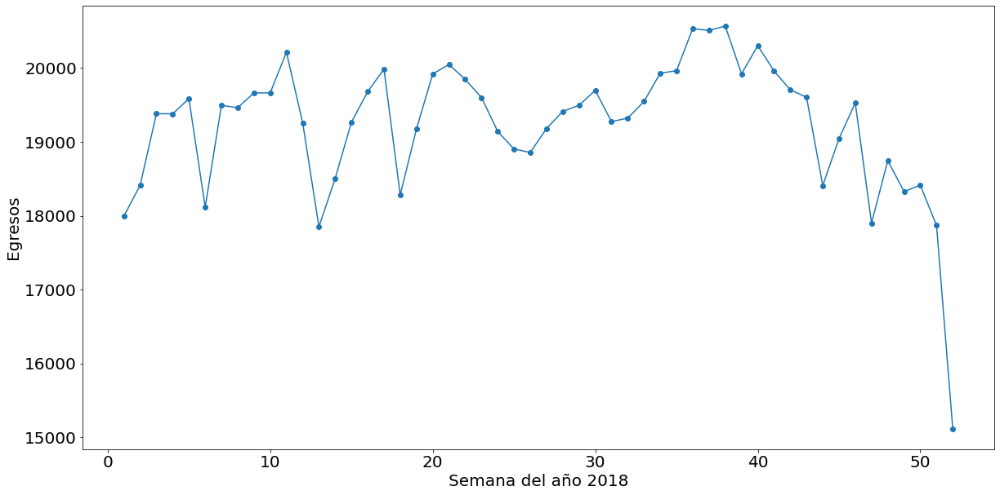

In [143]:
# Se importan las librerias necesarias
import matplotlib.pyplot as plt

año8 = '2018'
print('Egresos ' + año8)
# Se establece el tamaño de la figura
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(20, 10))
# Se define que se unan los puntos en la gráfica
plt.scatter(semanas8.index, newdf8.casos)
# Se definen las coordenadas 'x' y 'y'
plt.plot(semanas8.index, newdf8.casos)
# Se coloca un título para el eje x
plt.xlabel("Semana del año " + año8)
# Se coloca un título para el eje y
plt.ylabel("Egresos")
# Se guarda la figura como un archivo
plt.savefig(año8 + '/Egresos' + año8 + '.jpg', format='jpg')
# Se muestra la figura en la terminal
plt.show()

Año 2018


O809


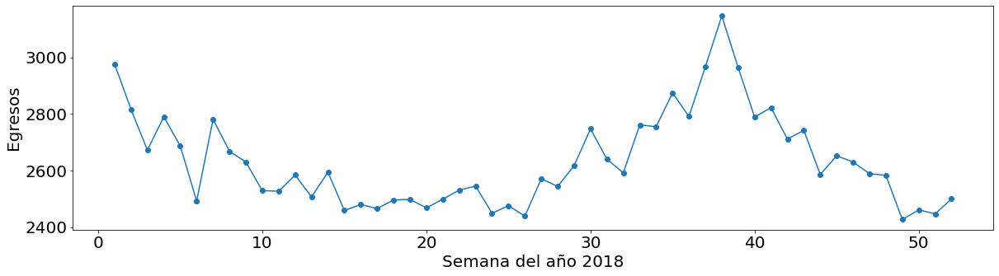


O800


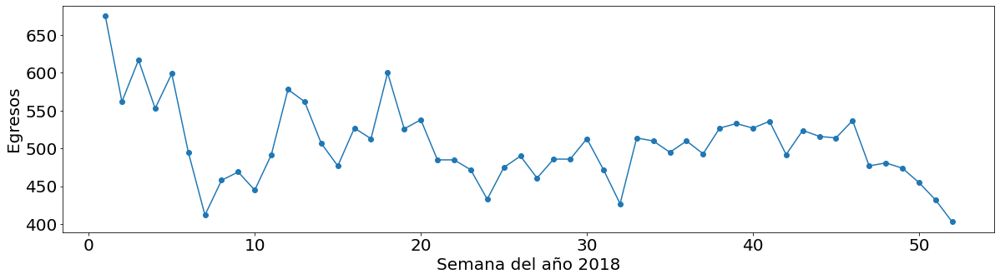


O829


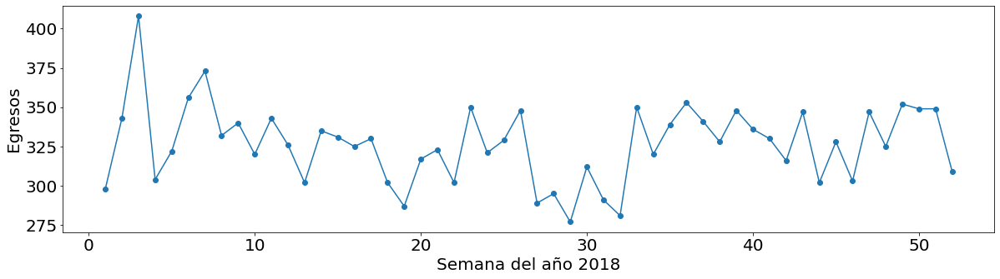


N189


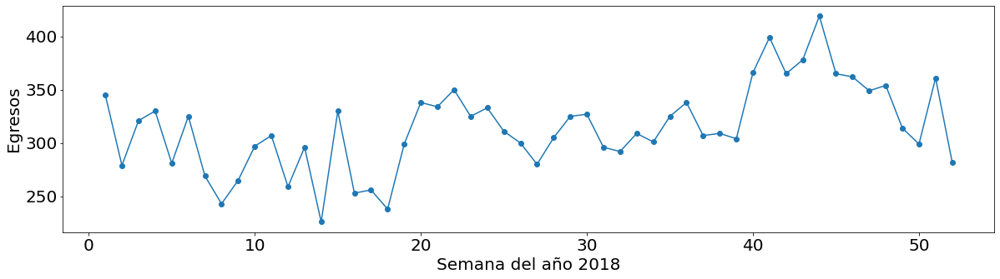


O064


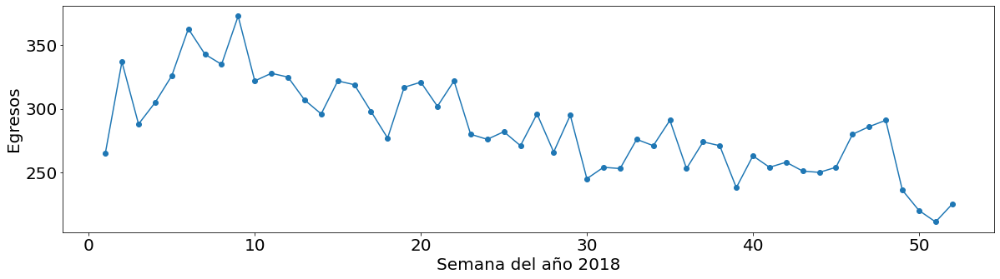


C509


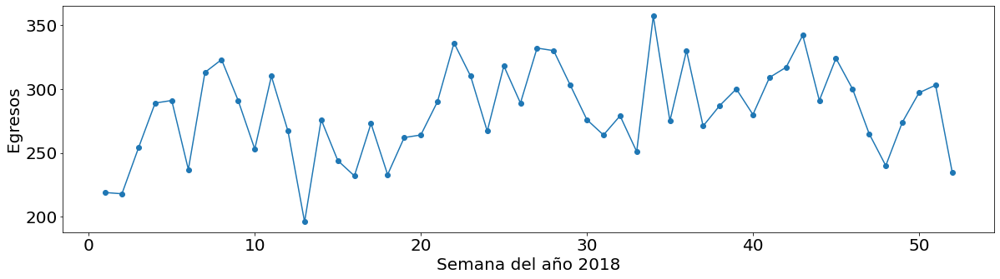


O342


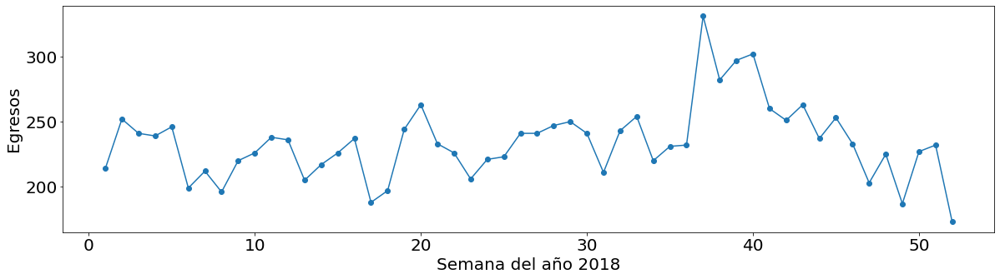


K358


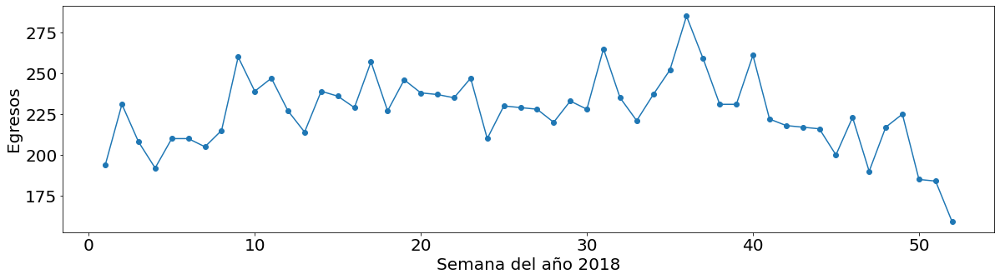


J189


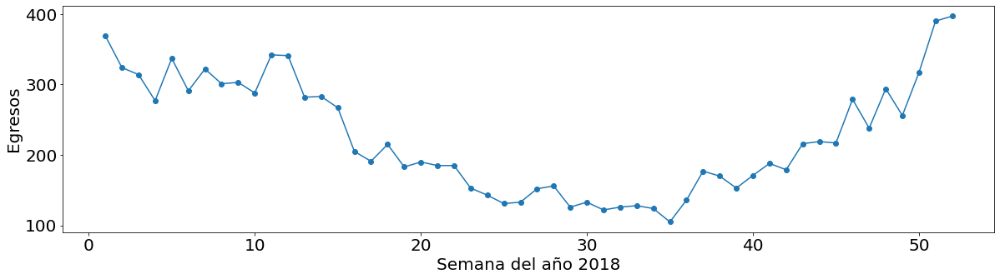


O429


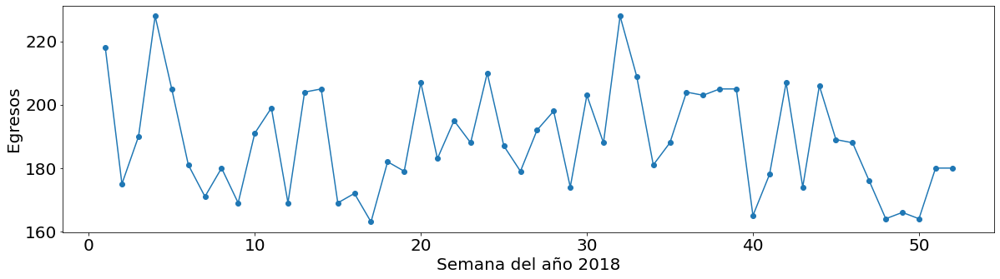


K409


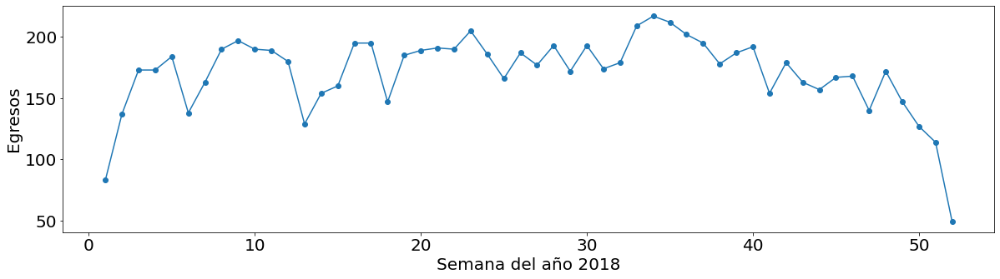


O339


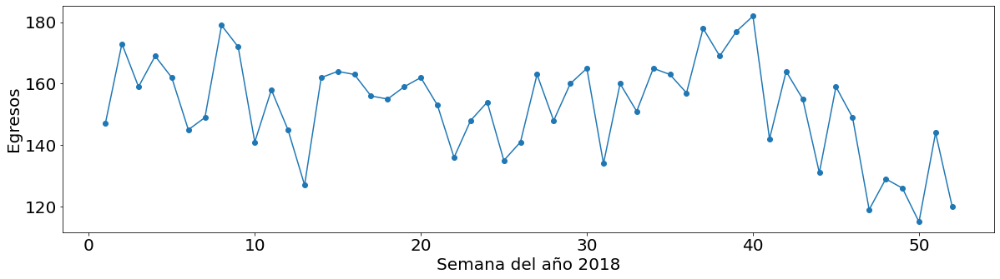


O410


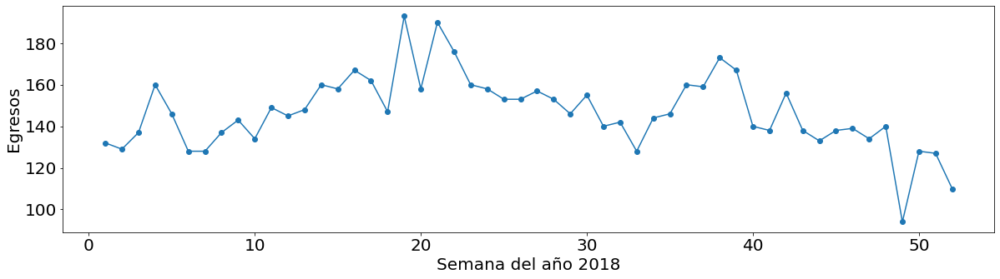


C910


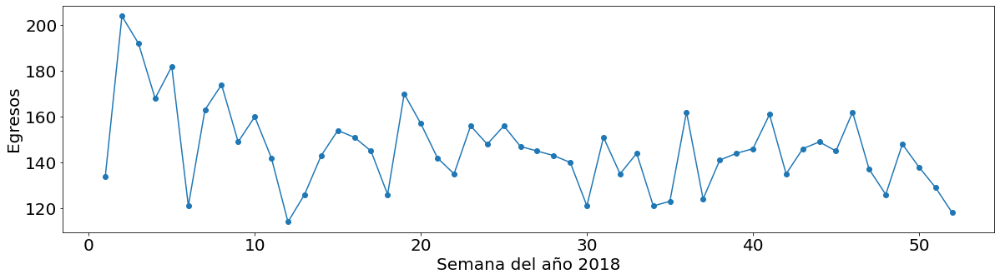


K801


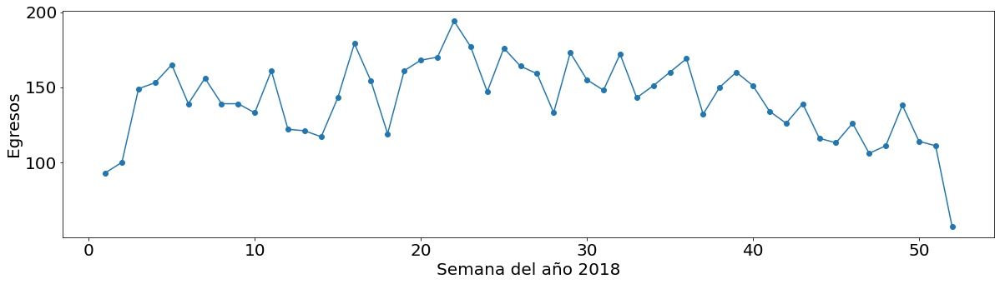


D259


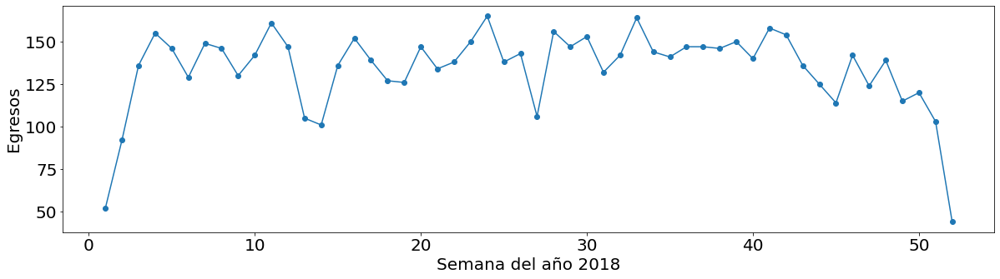


O470


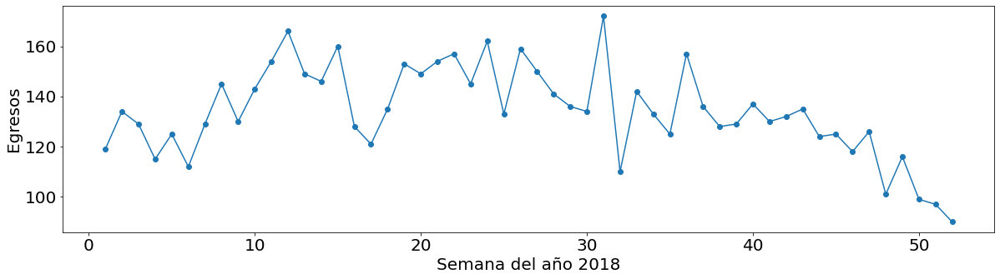


K811


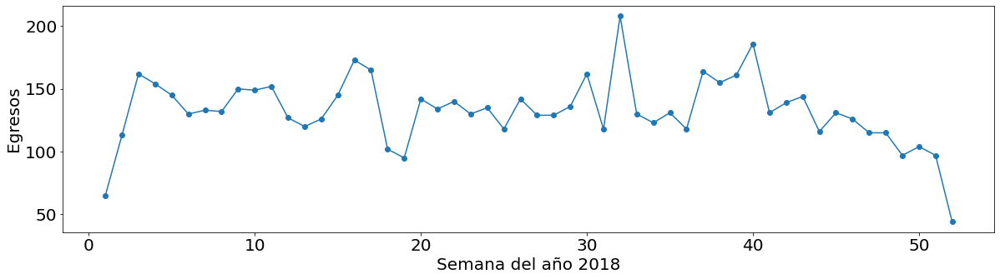


N185


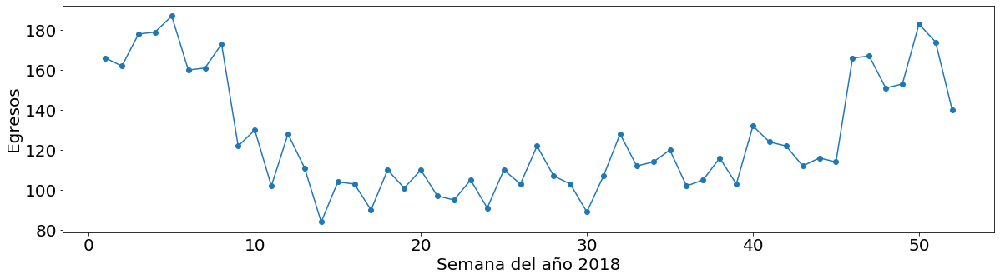


K37X


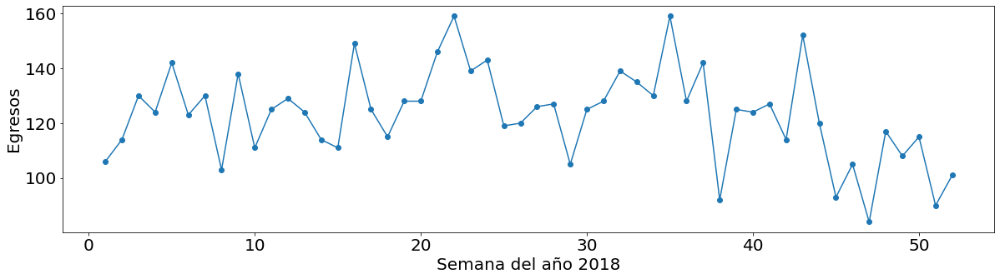


O13X


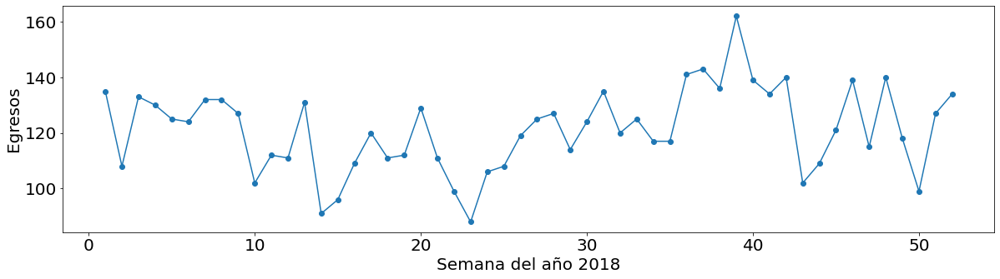


P073


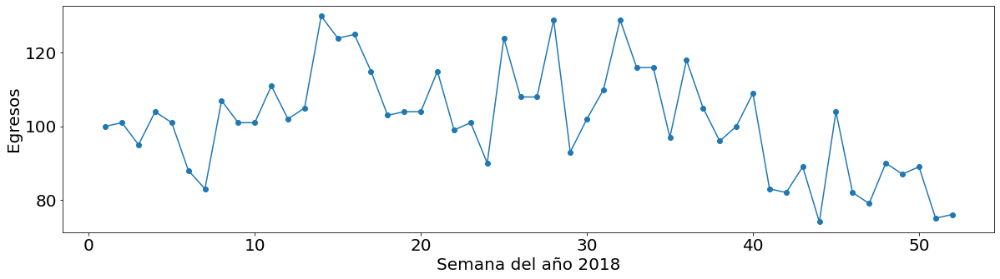


S069


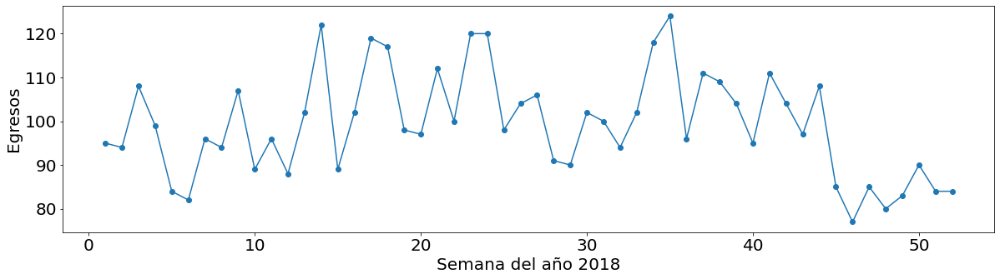


Z390


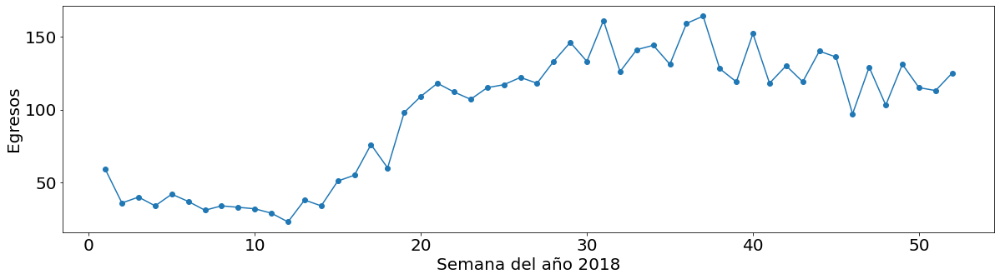


K429


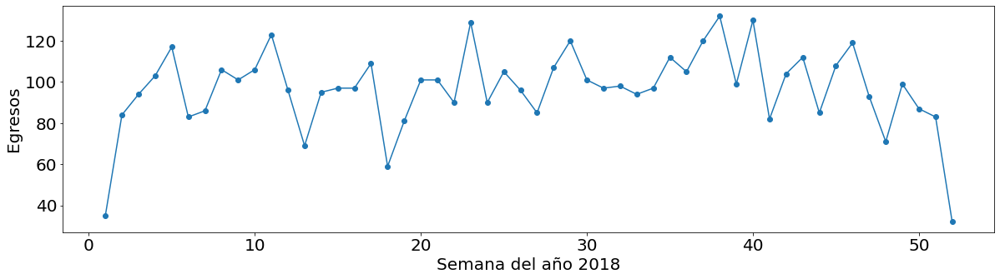


Q270


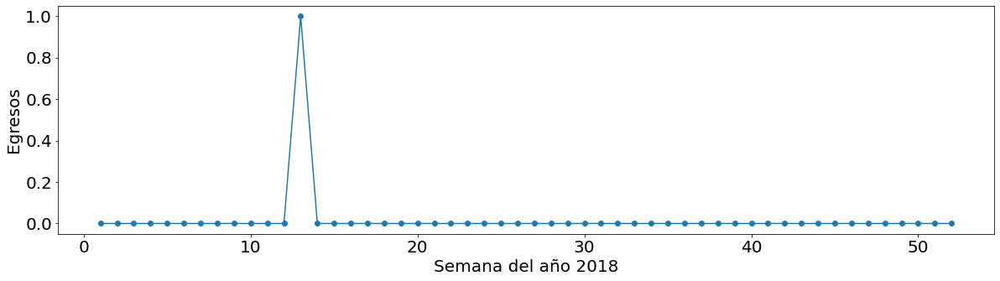


D035


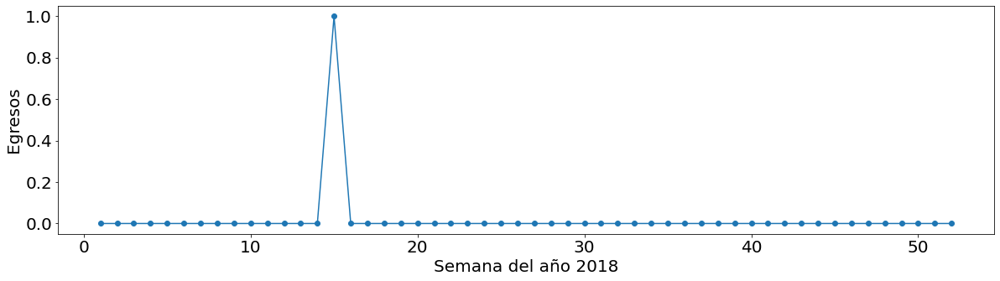


R412


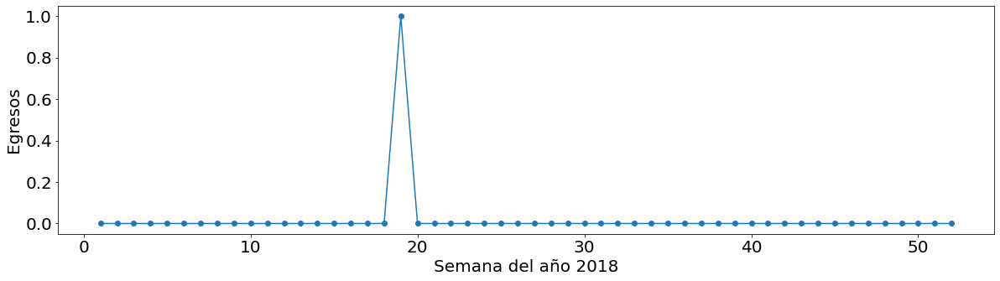


T804


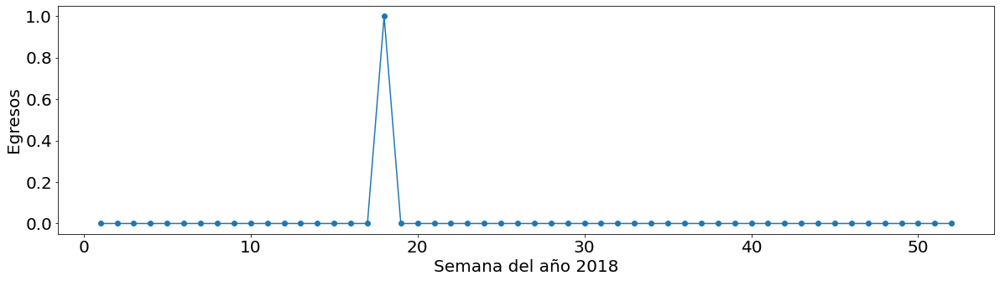


Z749


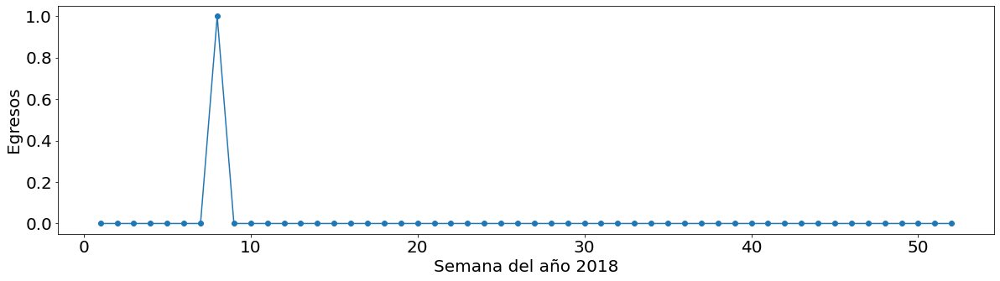

In [144]:
# Se crea el dataframe 'diagnosticos' con los nombre de los diferentes diagnosticos sin repeticion
diagnosticos8 = dataframe8['DIAG_INI'].value_counts()
# Se ordena del diagnostico con mayore numero de egresos al diagnostico con menor numero de egresos
diagnosticos8 = diagnosticos8.sort_values(ascending = False)
# Se crea el dataframe 'cie' con los nombres de los diagnosticos, los numeros de las semanas, y la cantidad de diagnosticos de dicha enfermedad en cada semana
cie8 = dataframe8.groupby(['DIAG_INI', 'sem']).count()

# Se importa la libreria necesaria para la figura
import matplotlib.pyplot as plt

plt.rcParams.update({'font.size': 20})

print('Año ' + año8 + '\n')
# Se inicia un contador para controlar la cantidad de graficos a generar
i8 = 0
ndiagnosticos8 = len(diagnosticos8.index)
maximo8 = ndiagnosticos8-5
# Proceso de generación de las figuras
for name8 in diagnosticos8.index:
    if i8 < 25 or i8 >= maximo8:
        y8 = []
        for index8 in semanas8.index:
            try:
                y8.append(cie8['EGRESO'][name8, index8])
            except:
                y8.append(0)
        print('\n' + name8)
        plt.figure(figsize=(20, 5))
        plt.scatter(semanas8.index, y8)
        plt.plot(semanas8.index, y8)
        plt.xlabel("Semana del año " + año8)
        plt.ylabel("Egresos")
        plt.savefig(año8 + '/' + name8 + '_' + año8 + '.jpg', format='jpg')
        plt.show()
    i8 = i8+1